# Vanilla GAN

![GAN](https://image.slidesharecdn.com/ganlapgan-170104090744/95/generative-adversarial-network-laplacian-pyramid-gan-7-638.jpg?cb=1484221156)

## Training Results on MNIST

### Epoch 1 - 200

![training](Sampling.gif)

In [21]:
from torchvision import datasets, transforms
import torch
from torch import nn,optim
from torch.autograd import Variable
from torchvision.utils import save_image,make_grid
import numpy as np
import matplotlib.pyplot as plt

In [30]:
args={
    'batch_size':256,
    'cuda':True,
    'save_result':10,
    'lr':0.001
}

CUDA_DEVICE=2

In [31]:
kwargs = {'num_workers': 1, 'pin_memory': True} if args['cuda'] else {}
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize(mean=(0.5, 0.5, 0.5), 
                std=(0.5, 0.5, 0.5))])

MNIST_data = torch.utils.data.DataLoader(
    datasets.MNIST('data',train=True,download=True,transform=transform),
    batch_size=args['batch_size'], shuffle=True, **kwargs)

In [32]:
def imshow(inp, c, save=False, title=None):
    """Imshow for Tensor."""
    fig = plt.figure(figsize=(5, 5))
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    
    plt.title(title) if title is not None else plt.title(str(c).zfill(3))
    plt.show()
    if save:
        if not os.path.exists('vanilla-out/'):
            os.makedirs('vanilla-out/')
        plt.savefig('vanilla-out/{}.png'.format(str(c).zfill(3)), bbox_inches='tight')
        plt.close(fig)

def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)


In [36]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.fc1=nn.Linear(64,256).cuda(CUDA_DEVICE)
        self.fc2=nn.Linear(256,256).cuda(CUDA_DEVICE)
        self.fc3=nn.Linear(256,256).cuda(CUDA_DEVICE)
        self.fc4=nn.Linear(256,28*28).cuda(CUDA_DEVICE)
        self.relu=nn.LeakyReLU().cuda(CUDA_DEVICE)
        self.tanh=nn.Tanh().cuda(CUDA_DEVICE)
        
    
    def forward(self,z):
        z=self.relu(self.fc1(z))
        z=self.relu(self.fc2(z))
        z=self.relu(self.fc3(z))
        z=self.fc4(z)
        z=self.tanh(z)
        return z.view(-1,1,28,28)


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator,self).__init__()
        self.fc1=nn.Linear(28*28,256).cuda(CUDA_DEVICE)
        self.fc2=nn.Linear(256,256).cuda(CUDA_DEVICE)
        self.fc3=nn.Linear(256,256).cuda(CUDA_DEVICE)
        self.fc4=nn.Linear(256,1).cuda(CUDA_DEVICE)
        self.relu=nn.LeakyReLU().cuda(CUDA_DEVICE)
        self.sigmoid=nn.Sigmoid().cuda(CUDA_DEVICE)
        
    def forward(self,x):
        x=x.view(-1,28*28)
        x=self.relu(self.fc1(x))
        x=self.relu(self.fc2(x))
        x=self.relu(self.fc3(x))
        x=self.fc4(x)
        x=self.sigmoid(x)
        return x

In [37]:
gen=Generator().cuda(CUDA_DEVICE)
dis=Discriminator().cuda(CUDA_DEVICE)

criterion=nn.BCELoss()

gen_optimizer=optim.Adam(gen.parameters(),lr=0.0003)
dis_optimizer=optim.Adam(dis.parameters(),lr=0.0003)

> Epoch : 1 Batch : 19 / 235 Loss_D : 1.0494364500045776 Loss_G : 0.5198420882225037
> Epoch : 1 Batch : 39 / 235 Loss_D : 1.0962457656860352 Loss_G : 1.1435277462005615
> Epoch : 1 Batch : 59 / 235 Loss_D : 0.12351344525814056 Loss_G : 3.5306954383850098
> Epoch : 1 Batch : 79 / 235 Loss_D : 0.26087650656700134 Loss_G : 1.8942817449569702
> Epoch : 1 Batch : 99 / 235 Loss_D : 0.21788643300533295 Loss_G : 1.8694415092468262
> Epoch : 1 Batch : 119 / 235 Loss_D : 0.4329226315021515 Loss_G : 1.495842456817627
> Epoch : 1 Batch : 139 / 235 Loss_D : 0.8432582020759583 Loss_G : 1.7778040170669556
> Epoch : 1 Batch : 159 / 235 Loss_D : 0.06070265918970108 Loss_G : 4.994787216186523
> Epoch : 1 Batch : 179 / 235 Loss_D : 0.08938956260681152 Loss_G : 4.755728721618652
> Epoch : 1 Batch : 199 / 235 Loss_D : 0.06224343925714493 Loss_G : 5.6763715744018555
> Epoch : 1 Batch : 219 / 235 Loss_D : 0.05088812857866287 Loss_G : 5.85817813873291


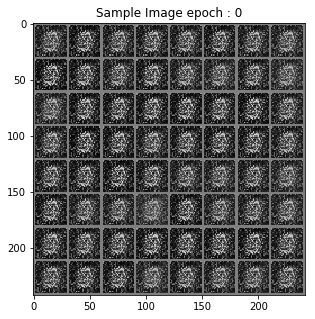

> Epoch : 2 Batch : 19 / 235 Loss_D : 0.3085618317127228 Loss_G : 5.221380233764648
> Epoch : 2 Batch : 39 / 235 Loss_D : 0.06321654468774796 Loss_G : 6.88972806930542
> Epoch : 2 Batch : 59 / 235 Loss_D : 0.2883475422859192 Loss_G : 7.485175609588623
> Epoch : 2 Batch : 79 / 235 Loss_D : 0.006295371800661087 Loss_G : 7.910991191864014
> Epoch : 2 Batch : 99 / 235 Loss_D : 0.4391297698020935 Loss_G : 7.128551483154297
> Epoch : 2 Batch : 119 / 235 Loss_D : 0.15991240739822388 Loss_G : 8.192110061645508
> Epoch : 2 Batch : 139 / 235 Loss_D : 0.1378435492515564 Loss_G : 6.994879245758057
> Epoch : 2 Batch : 159 / 235 Loss_D : 0.10031681507825851 Loss_G : 6.7279510498046875
> Epoch : 2 Batch : 179 / 235 Loss_D : 0.263330340385437 Loss_G : 4.916430473327637
> Epoch : 2 Batch : 199 / 235 Loss_D : 0.48047396540641785 Loss_G : 5.0734968185424805
> Epoch : 2 Batch : 219 / 235 Loss_D : 0.1745624840259552 Loss_G : 6.676751136779785


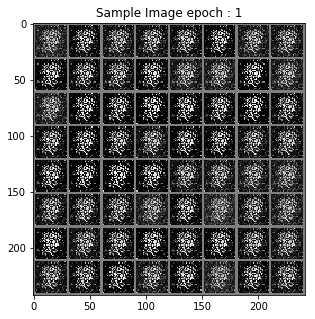

> Epoch : 3 Batch : 19 / 235 Loss_D : 0.36311161518096924 Loss_G : 7.2784199714660645
> Epoch : 3 Batch : 39 / 235 Loss_D : 0.03779463469982147 Loss_G : 5.461581707000732
> Epoch : 3 Batch : 59 / 235 Loss_D : 0.23378047347068787 Loss_G : 3.4848928451538086
> Epoch : 3 Batch : 79 / 235 Loss_D : 0.21369457244873047 Loss_G : 3.6200342178344727
> Epoch : 3 Batch : 99 / 235 Loss_D : 0.07793524861335754 Loss_G : 3.967062473297119
> Epoch : 3 Batch : 119 / 235 Loss_D : 0.6053709983825684 Loss_G : 2.3749308586120605
> Epoch : 3 Batch : 139 / 235 Loss_D : 0.6675707697868347 Loss_G : 2.232687473297119
> Epoch : 3 Batch : 159 / 235 Loss_D : 0.35878339409828186 Loss_G : 3.165329933166504
> Epoch : 3 Batch : 179 / 235 Loss_D : 0.45662128925323486 Loss_G : 4.290205001831055
> Epoch : 3 Batch : 199 / 235 Loss_D : 0.13346752524375916 Loss_G : 5.47590446472168
> Epoch : 3 Batch : 219 / 235 Loss_D : 0.6404696702957153 Loss_G : 3.75897479057312


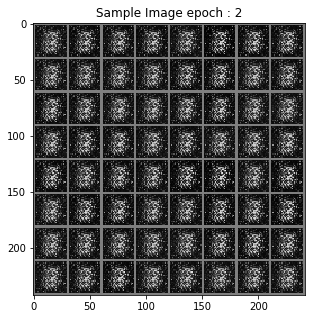

> Epoch : 4 Batch : 19 / 235 Loss_D : 0.10909020155668259 Loss_G : 4.980933666229248
> Epoch : 4 Batch : 39 / 235 Loss_D : 0.07386019825935364 Loss_G : 4.989407539367676
> Epoch : 4 Batch : 59 / 235 Loss_D : 0.18935829401016235 Loss_G : 5.312295913696289
> Epoch : 4 Batch : 79 / 235 Loss_D : 0.40940332412719727 Loss_G : 5.292137145996094
> Epoch : 4 Batch : 99 / 235 Loss_D : 0.3442559838294983 Loss_G : 6.300722122192383
> Epoch : 4 Batch : 119 / 235 Loss_D : 0.6925342679023743 Loss_G : 5.829857349395752
> Epoch : 4 Batch : 139 / 235 Loss_D : 0.6164883971214294 Loss_G : 4.480015754699707
> Epoch : 4 Batch : 159 / 235 Loss_D : 0.33671289682388306 Loss_G : 3.9618661403656006
> Epoch : 4 Batch : 179 / 235 Loss_D : 0.5389960408210754 Loss_G : 5.575033187866211
> Epoch : 4 Batch : 199 / 235 Loss_D : 1.4681050777435303 Loss_G : 6.918748378753662
> Epoch : 4 Batch : 219 / 235 Loss_D : 0.09711172431707382 Loss_G : 5.3777875900268555


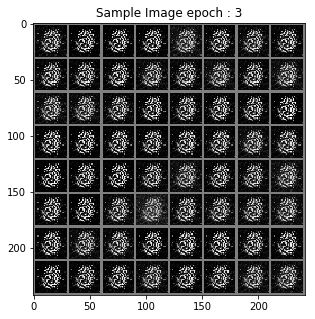

> Epoch : 5 Batch : 19 / 235 Loss_D : 0.10118336975574493 Loss_G : 6.870661735534668
> Epoch : 5 Batch : 39 / 235 Loss_D : 0.19280314445495605 Loss_G : 5.898197174072266
> Epoch : 5 Batch : 59 / 235 Loss_D : 0.14706392586231232 Loss_G : 7.83683967590332
> Epoch : 5 Batch : 79 / 235 Loss_D : 0.758260190486908 Loss_G : 4.575060844421387
> Epoch : 5 Batch : 99 / 235 Loss_D : 0.4963024854660034 Loss_G : 3.344113349914551
> Epoch : 5 Batch : 119 / 235 Loss_D : 0.23802044987678528 Loss_G : 3.8440465927124023
> Epoch : 5 Batch : 139 / 235 Loss_D : 1.1498125791549683 Loss_G : 4.205724716186523
> Epoch : 5 Batch : 159 / 235 Loss_D : 1.6234054565429688 Loss_G : 4.332006454467773
> Epoch : 5 Batch : 179 / 235 Loss_D : 0.4943012297153473 Loss_G : 4.758039474487305
> Epoch : 5 Batch : 199 / 235 Loss_D : 1.2432663440704346 Loss_G : 3.8724722862243652
> Epoch : 5 Batch : 219 / 235 Loss_D : 3.351614475250244 Loss_G : 4.3834638595581055


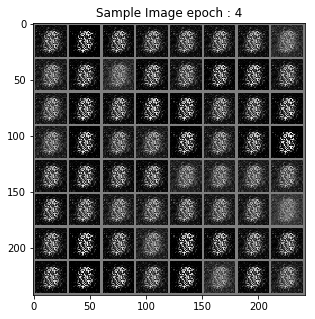

> Epoch : 6 Batch : 19 / 235 Loss_D : 0.8746540546417236 Loss_G : 2.9861161708831787
> Epoch : 6 Batch : 39 / 235 Loss_D : 0.2309086173772812 Loss_G : 3.521329402923584
> Epoch : 6 Batch : 59 / 235 Loss_D : 0.17396031320095062 Loss_G : 4.547323226928711
> Epoch : 6 Batch : 79 / 235 Loss_D : 0.5648386478424072 Loss_G : 4.804629802703857
> Epoch : 6 Batch : 99 / 235 Loss_D : 0.22944748401641846 Loss_G : 5.3226637840271
> Epoch : 6 Batch : 119 / 235 Loss_D : 0.05381998047232628 Loss_G : 6.23446798324585
> Epoch : 6 Batch : 139 / 235 Loss_D : 0.19923686981201172 Loss_G : 5.179590225219727
> Epoch : 6 Batch : 159 / 235 Loss_D : 0.44669777154922485 Loss_G : 4.050228118896484
> Epoch : 6 Batch : 179 / 235 Loss_D : 1.123902440071106 Loss_G : 3.7063815593719482
> Epoch : 6 Batch : 199 / 235 Loss_D : 0.24614042043685913 Loss_G : 3.8921618461608887
> Epoch : 6 Batch : 219 / 235 Loss_D : 1.0839816331863403 Loss_G : 2.208163261413574


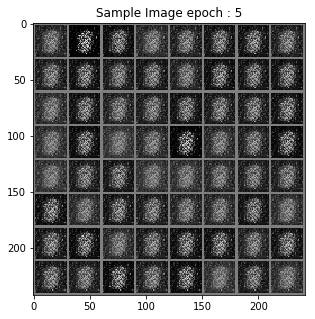

> Epoch : 7 Batch : 19 / 235 Loss_D : 0.2687775492668152 Loss_G : 3.2196598052978516
> Epoch : 7 Batch : 39 / 235 Loss_D : 0.41899725794792175 Loss_G : 3.8518919944763184
> Epoch : 7 Batch : 59 / 235 Loss_D : 0.34087762236595154 Loss_G : 3.3265552520751953
> Epoch : 7 Batch : 79 / 235 Loss_D : 0.4412986636161804 Loss_G : 2.863276481628418
> Epoch : 7 Batch : 99 / 235 Loss_D : 0.6062073111534119 Loss_G : 2.2549657821655273
> Epoch : 7 Batch : 119 / 235 Loss_D : 0.3887874484062195 Loss_G : 3.572279453277588
> Epoch : 7 Batch : 139 / 235 Loss_D : 0.1833232045173645 Loss_G : 3.6971373558044434
> Epoch : 7 Batch : 159 / 235 Loss_D : 0.41043999791145325 Loss_G : 3.9724762439727783
> Epoch : 7 Batch : 179 / 235 Loss_D : 0.2887798249721527 Loss_G : 4.663694381713867
> Epoch : 7 Batch : 199 / 235 Loss_D : 0.5555930137634277 Loss_G : 4.551873207092285
> Epoch : 7 Batch : 219 / 235 Loss_D : 1.007828950881958 Loss_G : 3.5062878131866455


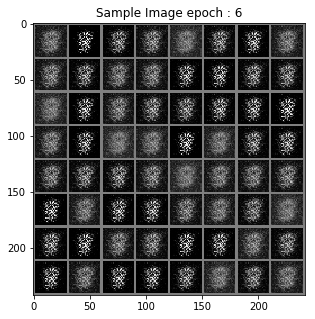

> Epoch : 8 Batch : 19 / 235 Loss_D : 0.46769556403160095 Loss_G : 3.604504346847534
> Epoch : 8 Batch : 39 / 235 Loss_D : 1.1317739486694336 Loss_G : 3.1035289764404297
> Epoch : 8 Batch : 59 / 235 Loss_D : 0.5119695067405701 Loss_G : 4.080156326293945
> Epoch : 8 Batch : 79 / 235 Loss_D : 0.5456312894821167 Loss_G : 3.3222200870513916
> Epoch : 8 Batch : 99 / 235 Loss_D : 0.16835437715053558 Loss_G : 4.895277976989746
> Epoch : 8 Batch : 119 / 235 Loss_D : 0.30672526359558105 Loss_G : 3.155583381652832
> Epoch : 8 Batch : 139 / 235 Loss_D : 0.4122469425201416 Loss_G : 3.68145751953125
> Epoch : 8 Batch : 159 / 235 Loss_D : 0.9362078905105591 Loss_G : 2.5920586585998535
> Epoch : 8 Batch : 179 / 235 Loss_D : 0.4322088360786438 Loss_G : 3.385981321334839
> Epoch : 8 Batch : 199 / 235 Loss_D : 0.7548352479934692 Loss_G : 2.2203891277313232
> Epoch : 8 Batch : 219 / 235 Loss_D : 0.2730492949485779 Loss_G : 2.83017635345459


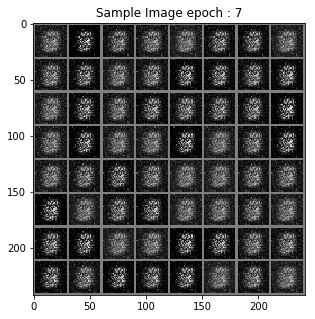

> Epoch : 9 Batch : 19 / 235 Loss_D : 0.08143467456102371 Loss_G : 4.078487396240234
> Epoch : 9 Batch : 39 / 235 Loss_D : 2.283036947250366 Loss_G : 3.8602209091186523
> Epoch : 9 Batch : 59 / 235 Loss_D : 1.2197105884552002 Loss_G : 1.478723406791687
> Epoch : 9 Batch : 79 / 235 Loss_D : 0.824779212474823 Loss_G : 1.862618088722229
> Epoch : 9 Batch : 99 / 235 Loss_D : 0.5590199828147888 Loss_G : 2.261310577392578
> Epoch : 9 Batch : 119 / 235 Loss_D : 0.9019978046417236 Loss_G : 1.840437650680542
> Epoch : 9 Batch : 139 / 235 Loss_D : 0.3878535032272339 Loss_G : 3.8164749145507812
> Epoch : 9 Batch : 159 / 235 Loss_D : 0.6796399354934692 Loss_G : 2.3007898330688477
> Epoch : 9 Batch : 179 / 235 Loss_D : 0.3866565227508545 Loss_G : 4.7538557052612305
> Epoch : 9 Batch : 199 / 235 Loss_D : 1.299188494682312 Loss_G : 2.318988561630249
> Epoch : 9 Batch : 219 / 235 Loss_D : 0.3984837532043457 Loss_G : 3.5853071212768555


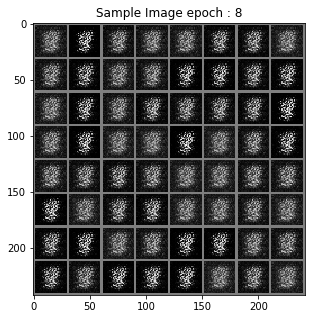

> Epoch : 10 Batch : 19 / 235 Loss_D : 0.9358080625534058 Loss_G : 2.4272408485412598
> Epoch : 10 Batch : 39 / 235 Loss_D : 1.1637673377990723 Loss_G : 1.9617149829864502
> Epoch : 10 Batch : 59 / 235 Loss_D : 0.8592324256896973 Loss_G : 4.07688570022583
> Epoch : 10 Batch : 79 / 235 Loss_D : 0.4207872450351715 Loss_G : 3.9046096801757812
> Epoch : 10 Batch : 99 / 235 Loss_D : 0.41334807872772217 Loss_G : 3.775858163833618
> Epoch : 10 Batch : 119 / 235 Loss_D : 0.7323698997497559 Loss_G : 4.573537349700928
> Epoch : 10 Batch : 139 / 235 Loss_D : 0.2120889276266098 Loss_G : 4.62762975692749
> Epoch : 10 Batch : 159 / 235 Loss_D : 0.12391822040081024 Loss_G : 4.149839878082275
> Epoch : 10 Batch : 179 / 235 Loss_D : 0.07857003808021545 Loss_G : 4.086615562438965
> Epoch : 10 Batch : 199 / 235 Loss_D : 0.2354249656200409 Loss_G : 3.044002056121826
> Epoch : 10 Batch : 219 / 235 Loss_D : 0.912487268447876 Loss_G : 3.142712116241455


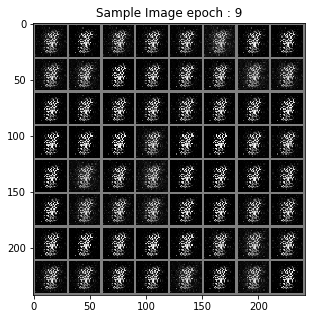

> Epoch : 11 Batch : 19 / 235 Loss_D : 0.4818892478942871 Loss_G : 4.7035675048828125
> Epoch : 11 Batch : 39 / 235 Loss_D : 0.22228407859802246 Loss_G : 4.34345817565918
> Epoch : 11 Batch : 59 / 235 Loss_D : 0.38299036026000977 Loss_G : 4.155346393585205
> Epoch : 11 Batch : 79 / 235 Loss_D : 0.3897983431816101 Loss_G : 5.494983196258545
> Epoch : 11 Batch : 99 / 235 Loss_D : 0.33206677436828613 Loss_G : 4.253783226013184
> Epoch : 11 Batch : 119 / 235 Loss_D : 0.3990391790866852 Loss_G : 5.547468662261963
> Epoch : 11 Batch : 139 / 235 Loss_D : 0.1137961894273758 Loss_G : 3.9139106273651123
> Epoch : 11 Batch : 159 / 235 Loss_D : 0.10745133459568024 Loss_G : 4.610025405883789
> Epoch : 11 Batch : 179 / 235 Loss_D : 0.12375366687774658 Loss_G : 4.0420684814453125
> Epoch : 11 Batch : 199 / 235 Loss_D : 0.423214316368103 Loss_G : 3.764934778213501
> Epoch : 11 Batch : 219 / 235 Loss_D : 0.41221535205841064 Loss_G : 3.578162670135498


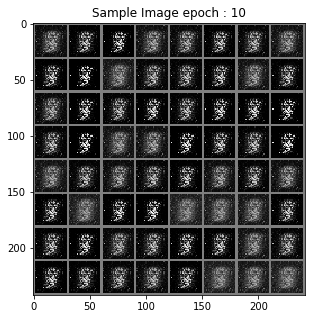

> Epoch : 12 Batch : 19 / 235 Loss_D : 0.46846839785575867 Loss_G : 4.495390892028809
> Epoch : 12 Batch : 39 / 235 Loss_D : 0.24522548913955688 Loss_G : 5.543083667755127
> Epoch : 12 Batch : 59 / 235 Loss_D : 0.5519227385520935 Loss_G : 4.190494060516357
> Epoch : 12 Batch : 79 / 235 Loss_D : 0.3371913433074951 Loss_G : 5.926494598388672
> Epoch : 12 Batch : 99 / 235 Loss_D : 0.13441447913646698 Loss_G : 6.38053035736084
> Epoch : 12 Batch : 119 / 235 Loss_D : 0.6939890384674072 Loss_G : 5.5907158851623535
> Epoch : 12 Batch : 139 / 235 Loss_D : 0.21830113232135773 Loss_G : 5.501492977142334
> Epoch : 12 Batch : 159 / 235 Loss_D : 0.9777336120605469 Loss_G : 3.3935818672180176
> Epoch : 12 Batch : 179 / 235 Loss_D : 0.19010350108146667 Loss_G : 5.284701824188232
> Epoch : 12 Batch : 199 / 235 Loss_D : 0.4789402484893799 Loss_G : 4.484277248382568
> Epoch : 12 Batch : 219 / 235 Loss_D : 0.27714478969573975 Loss_G : 4.775069236755371


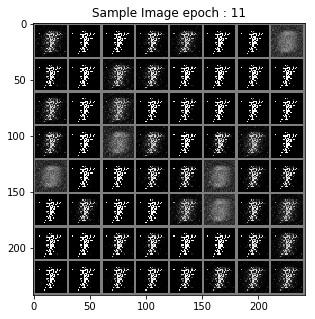

> Epoch : 13 Batch : 19 / 235 Loss_D : 0.14740429818630219 Loss_G : 4.932121276855469
> Epoch : 13 Batch : 39 / 235 Loss_D : 0.28742051124572754 Loss_G : 5.395355224609375
> Epoch : 13 Batch : 59 / 235 Loss_D : 0.460955411195755 Loss_G : 5.962059020996094
> Epoch : 13 Batch : 79 / 235 Loss_D : 0.12288277596235275 Loss_G : 3.8126227855682373
> Epoch : 13 Batch : 99 / 235 Loss_D : 0.11591844260692596 Loss_G : 6.2197675704956055
> Epoch : 13 Batch : 119 / 235 Loss_D : 0.3477742075920105 Loss_G : 5.393973350524902
> Epoch : 13 Batch : 139 / 235 Loss_D : 0.18664328753948212 Loss_G : 4.255468368530273
> Epoch : 13 Batch : 159 / 235 Loss_D : 0.07513400912284851 Loss_G : 5.078639507293701
> Epoch : 13 Batch : 179 / 235 Loss_D : 0.0727364644408226 Loss_G : 4.9326863288879395
> Epoch : 13 Batch : 199 / 235 Loss_D : 0.09269583970308304 Loss_G : 6.7581787109375
> Epoch : 13 Batch : 219 / 235 Loss_D : 0.11237530410289764 Loss_G : 6.857585906982422


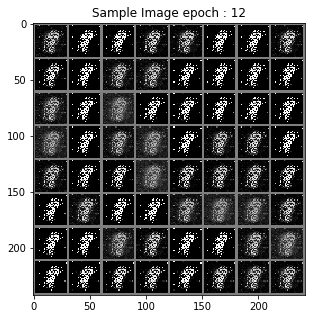

> Epoch : 14 Batch : 19 / 235 Loss_D : 0.1711026132106781 Loss_G : 7.459429740905762
> Epoch : 14 Batch : 39 / 235 Loss_D : 0.28084442019462585 Loss_G : 9.804616928100586
> Epoch : 14 Batch : 59 / 235 Loss_D : 0.41178566217422485 Loss_G : 10.30311393737793
> Epoch : 14 Batch : 79 / 235 Loss_D : 0.3133634626865387 Loss_G : 5.281225204467773
> Epoch : 14 Batch : 99 / 235 Loss_D : 0.1045989990234375 Loss_G : 6.487303256988525
> Epoch : 14 Batch : 119 / 235 Loss_D : 0.31961971521377563 Loss_G : 6.742985248565674
> Epoch : 14 Batch : 139 / 235 Loss_D : 0.3172942101955414 Loss_G : 10.14297103881836
> Epoch : 14 Batch : 159 / 235 Loss_D : 0.3145638406276703 Loss_G : 7.4464521408081055
> Epoch : 14 Batch : 179 / 235 Loss_D : 0.2655677795410156 Loss_G : 4.440288543701172
> Epoch : 14 Batch : 199 / 235 Loss_D : 0.15700824558734894 Loss_G : 5.294012069702148
> Epoch : 14 Batch : 219 / 235 Loss_D : 0.3808628022670746 Loss_G : 5.101125240325928


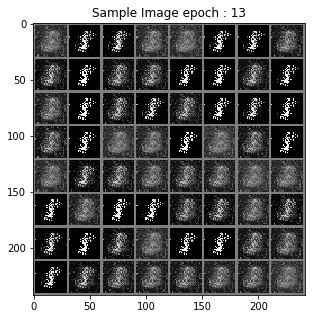

> Epoch : 15 Batch : 19 / 235 Loss_D : 0.4444100856781006 Loss_G : 3.151472568511963
> Epoch : 15 Batch : 39 / 235 Loss_D : 0.4501657783985138 Loss_G : 3.6942129135131836
> Epoch : 15 Batch : 59 / 235 Loss_D : 0.41110506653785706 Loss_G : 4.120558738708496
> Epoch : 15 Batch : 79 / 235 Loss_D : 0.08633233606815338 Loss_G : 5.267057418823242
> Epoch : 15 Batch : 99 / 235 Loss_D : 0.05874616280198097 Loss_G : 5.41114616394043
> Epoch : 15 Batch : 119 / 235 Loss_D : 0.04322957247495651 Loss_G : 6.19857120513916
> Epoch : 15 Batch : 139 / 235 Loss_D : 0.4546819031238556 Loss_G : 8.087113380432129
> Epoch : 15 Batch : 159 / 235 Loss_D : 0.228271946310997 Loss_G : 5.14151668548584
> Epoch : 15 Batch : 179 / 235 Loss_D : 0.15184123814105988 Loss_G : 4.20835018157959
> Epoch : 15 Batch : 199 / 235 Loss_D : 0.1799076497554779 Loss_G : 4.247262954711914
> Epoch : 15 Batch : 219 / 235 Loss_D : 0.0674261599779129 Loss_G : 5.403127670288086


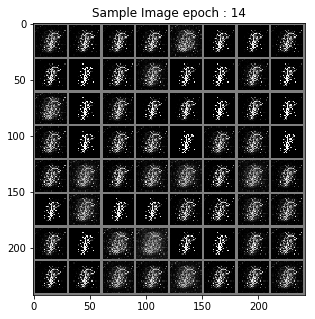

> Epoch : 16 Batch : 19 / 235 Loss_D : 0.23429518938064575 Loss_G : 4.924328804016113
> Epoch : 16 Batch : 39 / 235 Loss_D : 0.18958529829978943 Loss_G : 4.769551753997803
> Epoch : 16 Batch : 59 / 235 Loss_D : 0.20832578837871552 Loss_G : 7.977087020874023
> Epoch : 16 Batch : 79 / 235 Loss_D : 0.8232530951499939 Loss_G : 6.523120880126953
> Epoch : 16 Batch : 99 / 235 Loss_D : 0.21426977217197418 Loss_G : 7.918417453765869
> Epoch : 16 Batch : 119 / 235 Loss_D : 1.420457363128662 Loss_G : 8.783230781555176
> Epoch : 16 Batch : 139 / 235 Loss_D : 1.0662753582000732 Loss_G : 3.0582141876220703
> Epoch : 16 Batch : 159 / 235 Loss_D : 0.9334850311279297 Loss_G : 2.8470206260681152
> Epoch : 16 Batch : 179 / 235 Loss_D : 0.3775249719619751 Loss_G : 3.5913853645324707
> Epoch : 16 Batch : 199 / 235 Loss_D : 0.22797757387161255 Loss_G : 4.151191711425781
> Epoch : 16 Batch : 219 / 235 Loss_D : 0.07942396402359009 Loss_G : 4.991661071777344


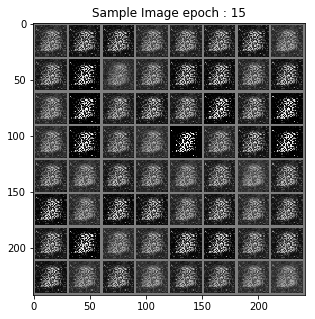

> Epoch : 17 Batch : 19 / 235 Loss_D : 0.6378954648971558 Loss_G : 6.05225133895874
> Epoch : 17 Batch : 39 / 235 Loss_D : 0.6365514993667603 Loss_G : 3.341343402862549
> Epoch : 17 Batch : 59 / 235 Loss_D : 0.14367298781871796 Loss_G : 2.5217576026916504
> Epoch : 17 Batch : 79 / 235 Loss_D : 0.14411987364292145 Loss_G : 3.370086669921875
> Epoch : 17 Batch : 99 / 235 Loss_D : 0.3007641136646271 Loss_G : 3.03973388671875
> Epoch : 17 Batch : 119 / 235 Loss_D : 0.11199233680963516 Loss_G : 3.7228803634643555
> Epoch : 17 Batch : 139 / 235 Loss_D : 0.5586056709289551 Loss_G : 2.2242939472198486
> Epoch : 17 Batch : 159 / 235 Loss_D : 0.8537761569023132 Loss_G : 3.1416304111480713
> Epoch : 17 Batch : 179 / 235 Loss_D : 1.5050861835479736 Loss_G : 3.2014594078063965
> Epoch : 17 Batch : 199 / 235 Loss_D : 1.379706859588623 Loss_G : 3.8363232612609863
> Epoch : 17 Batch : 219 / 235 Loss_D : 0.14060480892658234 Loss_G : 4.5950822830200195


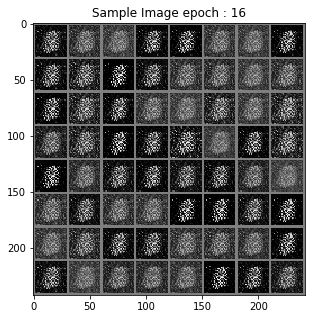

> Epoch : 18 Batch : 19 / 235 Loss_D : 0.21749484539031982 Loss_G : 4.319894313812256
> Epoch : 18 Batch : 39 / 235 Loss_D : 0.175744891166687 Loss_G : 6.424765586853027
> Epoch : 18 Batch : 59 / 235 Loss_D : 0.35924333333969116 Loss_G : 7.200771331787109
> Epoch : 18 Batch : 79 / 235 Loss_D : 0.18881918489933014 Loss_G : 5.507660388946533
> Epoch : 18 Batch : 99 / 235 Loss_D : 0.6150256395339966 Loss_G : 6.991595268249512
> Epoch : 18 Batch : 119 / 235 Loss_D : 1.6682733297348022 Loss_G : 6.875836372375488
> Epoch : 18 Batch : 139 / 235 Loss_D : 0.8007196187973022 Loss_G : 8.205775260925293
> Epoch : 18 Batch : 159 / 235 Loss_D : 0.9084115028381348 Loss_G : 5.35623836517334
> Epoch : 18 Batch : 179 / 235 Loss_D : 0.27646151185035706 Loss_G : 7.654041767120361
> Epoch : 18 Batch : 199 / 235 Loss_D : 0.20159322023391724 Loss_G : 4.234811782836914
> Epoch : 18 Batch : 219 / 235 Loss_D : 0.42461854219436646 Loss_G : 3.202073097229004


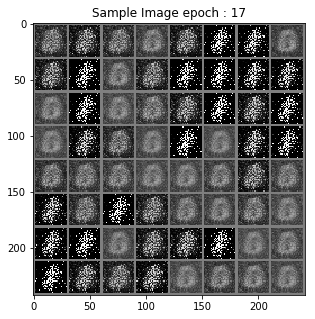

> Epoch : 19 Batch : 19 / 235 Loss_D : 0.15178577601909637 Loss_G : 5.366400718688965
> Epoch : 19 Batch : 39 / 235 Loss_D : 0.18853339552879333 Loss_G : 4.400547981262207
> Epoch : 19 Batch : 59 / 235 Loss_D : 0.2568490207195282 Loss_G : 4.144624710083008
> Epoch : 19 Batch : 79 / 235 Loss_D : 0.3487997353076935 Loss_G : 4.2300519943237305
> Epoch : 19 Batch : 99 / 235 Loss_D : 0.1915452480316162 Loss_G : 4.6757097244262695
> Epoch : 19 Batch : 119 / 235 Loss_D : 0.10880951583385468 Loss_G : 7.767867088317871
> Epoch : 19 Batch : 139 / 235 Loss_D : 0.8076571226119995 Loss_G : 3.9192099571228027
> Epoch : 19 Batch : 159 / 235 Loss_D : 0.26039260625839233 Loss_G : 4.037838935852051
> Epoch : 19 Batch : 179 / 235 Loss_D : 0.6414196491241455 Loss_G : 2.814457654953003
> Epoch : 19 Batch : 199 / 235 Loss_D : 0.19144757091999054 Loss_G : 4.390765190124512
> Epoch : 19 Batch : 219 / 235 Loss_D : 0.26212602853775024 Loss_G : 4.750629425048828


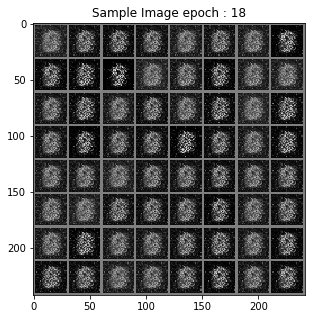

> Epoch : 20 Batch : 19 / 235 Loss_D : 0.5329717993736267 Loss_G : 6.9022908210754395
> Epoch : 20 Batch : 39 / 235 Loss_D : 0.20070970058441162 Loss_G : 6.7161784172058105
> Epoch : 20 Batch : 59 / 235 Loss_D : 0.6173535585403442 Loss_G : 9.53182601928711
> Epoch : 20 Batch : 79 / 235 Loss_D : 3.5875558853149414 Loss_G : 1.9774949550628662
> Epoch : 20 Batch : 99 / 235 Loss_D : 0.04099788889288902 Loss_G : 4.66463041305542
> Epoch : 20 Batch : 119 / 235 Loss_D : 0.34245598316192627 Loss_G : 4.854609489440918
> Epoch : 20 Batch : 139 / 235 Loss_D : 0.11825641244649887 Loss_G : 4.94683837890625
> Epoch : 20 Batch : 159 / 235 Loss_D : 0.09713850915431976 Loss_G : 5.294137001037598
> Epoch : 20 Batch : 179 / 235 Loss_D : 0.1782217174768448 Loss_G : 4.970747470855713
> Epoch : 20 Batch : 199 / 235 Loss_D : 0.3548913598060608 Loss_G : 4.277851104736328
> Epoch : 20 Batch : 219 / 235 Loss_D : 0.1502121537923813 Loss_G : 5.791818618774414


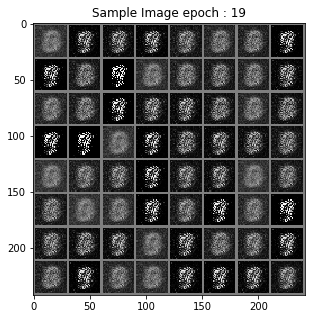

> Epoch : 21 Batch : 19 / 235 Loss_D : 0.9172663688659668 Loss_G : 5.194223880767822
> Epoch : 21 Batch : 39 / 235 Loss_D : 0.5982753038406372 Loss_G : 3.841362714767456
> Epoch : 21 Batch : 59 / 235 Loss_D : 0.13887780904769897 Loss_G : 4.225833415985107
> Epoch : 21 Batch : 79 / 235 Loss_D : 0.890647292137146 Loss_G : 3.289787769317627
> Epoch : 21 Batch : 99 / 235 Loss_D : 0.8312883377075195 Loss_G : 2.5086894035339355
> Epoch : 21 Batch : 119 / 235 Loss_D : 0.12906672060489655 Loss_G : 4.189481735229492
> Epoch : 21 Batch : 139 / 235 Loss_D : 0.24944989383220673 Loss_G : 3.9302306175231934
> Epoch : 21 Batch : 159 / 235 Loss_D : 0.22348445653915405 Loss_G : 4.049376964569092
> Epoch : 21 Batch : 179 / 235 Loss_D : 0.27103930711746216 Loss_G : 4.199173927307129
> Epoch : 21 Batch : 199 / 235 Loss_D : 0.6505454778671265 Loss_G : 4.995947360992432
> Epoch : 21 Batch : 219 / 235 Loss_D : 0.21201710402965546 Loss_G : 5.239478588104248


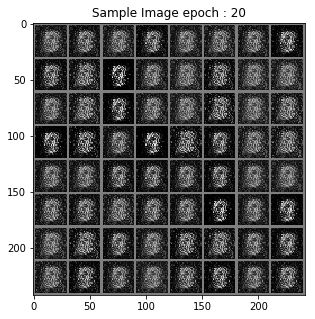

> Epoch : 22 Batch : 19 / 235 Loss_D : 0.7932652831077576 Loss_G : 5.700931549072266
> Epoch : 22 Batch : 39 / 235 Loss_D : 0.6413203477859497 Loss_G : 4.5063323974609375
> Epoch : 22 Batch : 59 / 235 Loss_D : 0.5579795241355896 Loss_G : 5.77830696105957
> Epoch : 22 Batch : 79 / 235 Loss_D : 0.47560054063796997 Loss_G : 8.128997802734375
> Epoch : 22 Batch : 99 / 235 Loss_D : 1.408538818359375 Loss_G : 8.0423583984375
> Epoch : 22 Batch : 119 / 235 Loss_D : 1.4420580863952637 Loss_G : 5.418540954589844
> Epoch : 22 Batch : 139 / 235 Loss_D : 0.9930883049964905 Loss_G : 5.409428596496582
> Epoch : 22 Batch : 159 / 235 Loss_D : 0.3600950539112091 Loss_G : 4.2800750732421875
> Epoch : 22 Batch : 179 / 235 Loss_D : 0.7614351511001587 Loss_G : 3.586904525756836
> Epoch : 22 Batch : 199 / 235 Loss_D : 0.32657456398010254 Loss_G : 4.569786071777344
> Epoch : 22 Batch : 219 / 235 Loss_D : 0.3397158980369568 Loss_G : 4.528387069702148


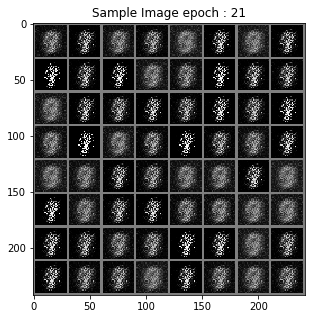

> Epoch : 23 Batch : 19 / 235 Loss_D : 0.45570337772369385 Loss_G : 3.6704928874969482
> Epoch : 23 Batch : 39 / 235 Loss_D : 0.1036490947008133 Loss_G : 7.225651264190674
> Epoch : 23 Batch : 59 / 235 Loss_D : 0.8742330074310303 Loss_G : 5.11362361907959
> Epoch : 23 Batch : 79 / 235 Loss_D : 1.5214226245880127 Loss_G : 2.4574503898620605
> Epoch : 23 Batch : 99 / 235 Loss_D : 1.5837085247039795 Loss_G : 3.071878433227539
> Epoch : 23 Batch : 119 / 235 Loss_D : 0.821649432182312 Loss_G : 3.788506507873535
> Epoch : 23 Batch : 139 / 235 Loss_D : 0.20317143201828003 Loss_G : 3.4888176918029785
> Epoch : 23 Batch : 159 / 235 Loss_D : 0.4124039113521576 Loss_G : 3.3655052185058594
> Epoch : 23 Batch : 179 / 235 Loss_D : 0.5771549940109253 Loss_G : 3.086074113845825
> Epoch : 23 Batch : 199 / 235 Loss_D : 0.6955176591873169 Loss_G : 2.9793574810028076
> Epoch : 23 Batch : 219 / 235 Loss_D : 0.5961544513702393 Loss_G : 2.70049786567688


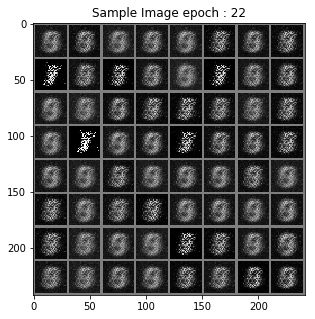

> Epoch : 24 Batch : 19 / 235 Loss_D : 0.6867868900299072 Loss_G : 2.0305569171905518
> Epoch : 24 Batch : 39 / 235 Loss_D : 1.7233169078826904 Loss_G : 2.15675687789917
> Epoch : 24 Batch : 59 / 235 Loss_D : 0.5082345604896545 Loss_G : 2.174666166305542
> Epoch : 24 Batch : 79 / 235 Loss_D : 0.2989373505115509 Loss_G : 2.8701319694519043
> Epoch : 24 Batch : 99 / 235 Loss_D : 0.46697163581848145 Loss_G : 2.6608378887176514
> Epoch : 24 Batch : 119 / 235 Loss_D : 0.8050438165664673 Loss_G : 2.5470571517944336
> Epoch : 24 Batch : 139 / 235 Loss_D : 1.2443605661392212 Loss_G : 1.698820948600769
> Epoch : 24 Batch : 159 / 235 Loss_D : 0.6494338512420654 Loss_G : 1.522125482559204
> Epoch : 24 Batch : 179 / 235 Loss_D : 0.3143905997276306 Loss_G : 2.4937987327575684
> Epoch : 24 Batch : 199 / 235 Loss_D : 0.29483669996261597 Loss_G : 2.7814230918884277
> Epoch : 24 Batch : 219 / 235 Loss_D : 0.5429427623748779 Loss_G : 2.2235193252563477


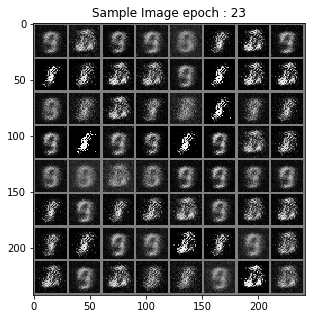

> Epoch : 25 Batch : 19 / 235 Loss_D : 1.0350067615509033 Loss_G : 2.2287328243255615
> Epoch : 25 Batch : 39 / 235 Loss_D : 1.2788869142532349 Loss_G : 1.9980692863464355
> Epoch : 25 Batch : 59 / 235 Loss_D : 0.626684308052063 Loss_G : 2.359544277191162
> Epoch : 25 Batch : 79 / 235 Loss_D : 1.303378939628601 Loss_G : 1.376319408416748
> Epoch : 25 Batch : 99 / 235 Loss_D : 0.6160406470298767 Loss_G : 2.078373908996582
> Epoch : 25 Batch : 119 / 235 Loss_D : 0.901989221572876 Loss_G : 1.797908067703247
> Epoch : 25 Batch : 139 / 235 Loss_D : 0.9391614198684692 Loss_G : 1.9408411979675293
> Epoch : 25 Batch : 159 / 235 Loss_D : 0.9812202453613281 Loss_G : 1.6050255298614502
> Epoch : 25 Batch : 179 / 235 Loss_D : 0.8754665851593018 Loss_G : 2.351153612136841
> Epoch : 25 Batch : 199 / 235 Loss_D : 0.5714372396469116 Loss_G : 2.675335168838501
> Epoch : 25 Batch : 219 / 235 Loss_D : 0.3397563099861145 Loss_G : 3.013629198074341


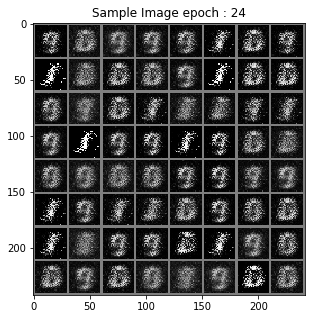

> Epoch : 26 Batch : 19 / 235 Loss_D : 0.10425617545843124 Loss_G : 3.915644645690918
> Epoch : 26 Batch : 39 / 235 Loss_D : 0.2776634395122528 Loss_G : 3.2581026554107666
> Epoch : 26 Batch : 59 / 235 Loss_D : 0.6872178316116333 Loss_G : 2.532519578933716
> Epoch : 26 Batch : 79 / 235 Loss_D : 0.842133641242981 Loss_G : 3.66855525970459
> Epoch : 26 Batch : 99 / 235 Loss_D : 0.287942498922348 Loss_G : 4.252330780029297
> Epoch : 26 Batch : 119 / 235 Loss_D : 0.34123966097831726 Loss_G : 5.738085746765137
> Epoch : 26 Batch : 139 / 235 Loss_D : 0.6059146523475647 Loss_G : 5.29051399230957
> Epoch : 26 Batch : 159 / 235 Loss_D : 0.7663936614990234 Loss_G : 3.442307949066162
> Epoch : 26 Batch : 179 / 235 Loss_D : 0.6756621599197388 Loss_G : 3.821467638015747
> Epoch : 26 Batch : 199 / 235 Loss_D : 1.1857722997665405 Loss_G : 3.3113350868225098
> Epoch : 26 Batch : 219 / 235 Loss_D : 0.9074695110321045 Loss_G : 4.308414459228516


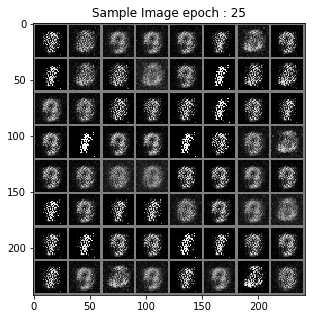

> Epoch : 27 Batch : 19 / 235 Loss_D : 1.2786521911621094 Loss_G : 4.363882064819336
> Epoch : 27 Batch : 39 / 235 Loss_D : 1.342333436012268 Loss_G : 3.7316479682922363
> Epoch : 27 Batch : 59 / 235 Loss_D : 0.3723263740539551 Loss_G : 4.3294997215271
> Epoch : 27 Batch : 79 / 235 Loss_D : 0.35369694232940674 Loss_G : 3.599069595336914
> Epoch : 27 Batch : 99 / 235 Loss_D : 0.7127701044082642 Loss_G : 4.147238254547119
> Epoch : 27 Batch : 119 / 235 Loss_D : 0.8261407017707825 Loss_G : 3.1315317153930664
> Epoch : 27 Batch : 139 / 235 Loss_D : 0.523384153842926 Loss_G : 3.0431010723114014
> Epoch : 27 Batch : 159 / 235 Loss_D : 0.35134896636009216 Loss_G : 3.421689748764038
> Epoch : 27 Batch : 179 / 235 Loss_D : 0.315571665763855 Loss_G : 3.0642294883728027
> Epoch : 27 Batch : 199 / 235 Loss_D : 0.6156208515167236 Loss_G : 3.310148239135742
> Epoch : 27 Batch : 219 / 235 Loss_D : 0.9837064146995544 Loss_G : 2.7944798469543457


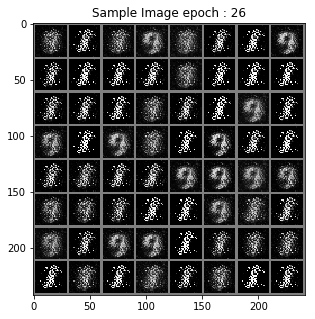

> Epoch : 28 Batch : 19 / 235 Loss_D : 0.3730586767196655 Loss_G : 3.0177364349365234
> Epoch : 28 Batch : 39 / 235 Loss_D : 0.385418176651001 Loss_G : 3.714773178100586
> Epoch : 28 Batch : 59 / 235 Loss_D : 0.297422856092453 Loss_G : 4.174029350280762
> Epoch : 28 Batch : 79 / 235 Loss_D : 0.7830088138580322 Loss_G : 4.289943218231201
> Epoch : 28 Batch : 99 / 235 Loss_D : 0.260354220867157 Loss_G : 4.537773132324219
> Epoch : 28 Batch : 119 / 235 Loss_D : 0.4366159737110138 Loss_G : 4.439792633056641
> Epoch : 28 Batch : 139 / 235 Loss_D : 0.2840961813926697 Loss_G : 4.914430141448975
> Epoch : 28 Batch : 159 / 235 Loss_D : 0.16398006677627563 Loss_G : 5.145380020141602
> Epoch : 28 Batch : 179 / 235 Loss_D : 0.549483597278595 Loss_G : 2.984494924545288
> Epoch : 28 Batch : 199 / 235 Loss_D : 0.511864960193634 Loss_G : 2.897712230682373
> Epoch : 28 Batch : 219 / 235 Loss_D : 0.3548002243041992 Loss_G : 4.188173294067383


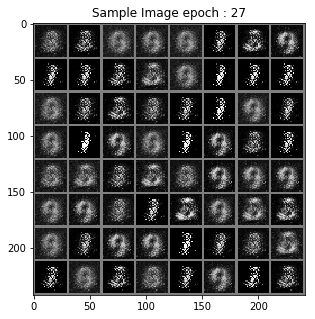

> Epoch : 29 Batch : 19 / 235 Loss_D : 0.2624199688434601 Loss_G : 3.3044021129608154
> Epoch : 29 Batch : 39 / 235 Loss_D : 0.7763350605964661 Loss_G : 2.0623812675476074
> Epoch : 29 Batch : 59 / 235 Loss_D : 0.809653639793396 Loss_G : 1.8188302516937256
> Epoch : 29 Batch : 79 / 235 Loss_D : 0.3782752752304077 Loss_G : 2.639061689376831
> Epoch : 29 Batch : 99 / 235 Loss_D : 0.3499552309513092 Loss_G : 2.858842134475708
> Epoch : 29 Batch : 119 / 235 Loss_D : 0.3649899363517761 Loss_G : 3.185506582260132
> Epoch : 29 Batch : 139 / 235 Loss_D : 0.4958265423774719 Loss_G : 4.135574817657471
> Epoch : 29 Batch : 159 / 235 Loss_D : 0.5215554237365723 Loss_G : 3.1041407585144043
> Epoch : 29 Batch : 179 / 235 Loss_D : 0.6410535573959351 Loss_G : 3.075930118560791
> Epoch : 29 Batch : 199 / 235 Loss_D : 0.3145042061805725 Loss_G : 3.7248101234436035
> Epoch : 29 Batch : 219 / 235 Loss_D : 0.298376202583313 Loss_G : 5.629286766052246


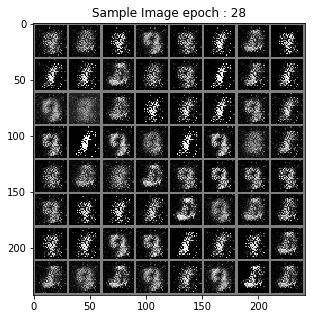

> Epoch : 30 Batch : 19 / 235 Loss_D : 0.7439431548118591 Loss_G : 3.7395665645599365
> Epoch : 30 Batch : 39 / 235 Loss_D : 0.3505899906158447 Loss_G : 4.9582624435424805
> Epoch : 30 Batch : 59 / 235 Loss_D : 0.27384620904922485 Loss_G : 4.685356616973877
> Epoch : 30 Batch : 79 / 235 Loss_D : 0.40585508942604065 Loss_G : 3.7885265350341797
> Epoch : 30 Batch : 99 / 235 Loss_D : 0.6612245440483093 Loss_G : 5.7213544845581055
> Epoch : 30 Batch : 119 / 235 Loss_D : 0.37117844820022583 Loss_G : 4.664852619171143
> Epoch : 30 Batch : 139 / 235 Loss_D : 0.12010310590267181 Loss_G : 7.606492042541504
> Epoch : 30 Batch : 159 / 235 Loss_D : 0.16016927361488342 Loss_G : 7.167597770690918
> Epoch : 30 Batch : 179 / 235 Loss_D : 0.5736610293388367 Loss_G : 6.160067081451416
> Epoch : 30 Batch : 199 / 235 Loss_D : 0.5139076709747314 Loss_G : 4.154321670532227
> Epoch : 30 Batch : 219 / 235 Loss_D : 0.19693875312805176 Loss_G : 4.345210075378418


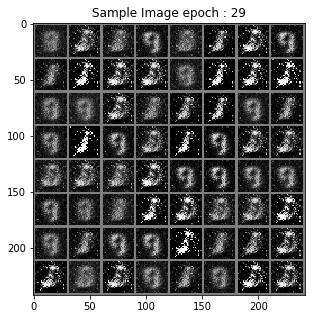

> Epoch : 31 Batch : 19 / 235 Loss_D : 0.3599252700805664 Loss_G : 4.0338945388793945
> Epoch : 31 Batch : 39 / 235 Loss_D : 0.2797483205795288 Loss_G : 3.6634254455566406
> Epoch : 31 Batch : 59 / 235 Loss_D : 0.10790547728538513 Loss_G : 4.965864181518555
> Epoch : 31 Batch : 79 / 235 Loss_D : 0.49210602045059204 Loss_G : 3.3558807373046875
> Epoch : 31 Batch : 99 / 235 Loss_D : 0.3532864451408386 Loss_G : 3.0623645782470703
> Epoch : 31 Batch : 119 / 235 Loss_D : 0.28168341517448425 Loss_G : 6.526571273803711
> Epoch : 31 Batch : 139 / 235 Loss_D : 0.6717274785041809 Loss_G : 3.4056167602539062
> Epoch : 31 Batch : 159 / 235 Loss_D : 0.828236997127533 Loss_G : 3.6923742294311523
> Epoch : 31 Batch : 179 / 235 Loss_D : 0.38915666937828064 Loss_G : 3.446005344390869
> Epoch : 31 Batch : 199 / 235 Loss_D : 0.46435606479644775 Loss_G : 3.187692642211914
> Epoch : 31 Batch : 219 / 235 Loss_D : 0.2578405439853668 Loss_G : 4.862090587615967


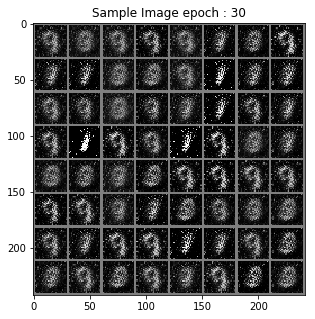

> Epoch : 32 Batch : 19 / 235 Loss_D : 0.35320788621902466 Loss_G : 4.24820613861084
> Epoch : 32 Batch : 39 / 235 Loss_D : 0.7277843952178955 Loss_G : 5.676541328430176
> Epoch : 32 Batch : 59 / 235 Loss_D : 0.5112165212631226 Loss_G : 5.976324558258057
> Epoch : 32 Batch : 79 / 235 Loss_D : 0.41189852356910706 Loss_G : 4.989539623260498
> Epoch : 32 Batch : 99 / 235 Loss_D : 0.8228538036346436 Loss_G : 4.5459794998168945
> Epoch : 32 Batch : 119 / 235 Loss_D : 0.24075672030448914 Loss_G : 6.356600761413574
> Epoch : 32 Batch : 139 / 235 Loss_D : 0.477551132440567 Loss_G : 5.082656383514404
> Epoch : 32 Batch : 159 / 235 Loss_D : 0.35513362288475037 Loss_G : 6.104489326477051
> Epoch : 32 Batch : 179 / 235 Loss_D : 0.41304150223731995 Loss_G : 9.353211402893066
> Epoch : 32 Batch : 199 / 235 Loss_D : 0.6159593462944031 Loss_G : 6.3958563804626465
> Epoch : 32 Batch : 219 / 235 Loss_D : 0.3495951294898987 Loss_G : 6.8559041023254395


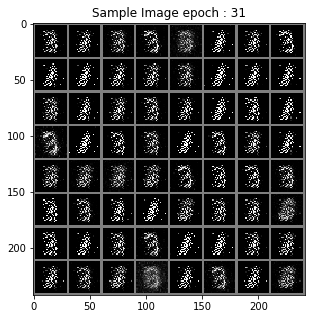

> Epoch : 33 Batch : 19 / 235 Loss_D : 0.10569809377193451 Loss_G : 8.064260482788086
> Epoch : 33 Batch : 39 / 235 Loss_D : 0.15224948525428772 Loss_G : 7.2413411140441895
> Epoch : 33 Batch : 59 / 235 Loss_D : 0.1629703938961029 Loss_G : 7.622218132019043
> Epoch : 33 Batch : 79 / 235 Loss_D : 0.19886115193367004 Loss_G : 8.56054401397705
> Epoch : 33 Batch : 99 / 235 Loss_D : 0.07095282524824142 Loss_G : 5.656473159790039
> Epoch : 33 Batch : 119 / 235 Loss_D : 0.06717804819345474 Loss_G : 7.260149002075195
> Epoch : 33 Batch : 139 / 235 Loss_D : 0.2364172786474228 Loss_G : 9.604501724243164
> Epoch : 33 Batch : 159 / 235 Loss_D : 0.9440940618515015 Loss_G : 10.446954727172852
> Epoch : 33 Batch : 179 / 235 Loss_D : 0.1602499783039093 Loss_G : 4.593266010284424
> Epoch : 33 Batch : 199 / 235 Loss_D : 0.2938539981842041 Loss_G : 3.073951244354248
> Epoch : 33 Batch : 219 / 235 Loss_D : 0.787117063999176 Loss_G : 2.888180732727051


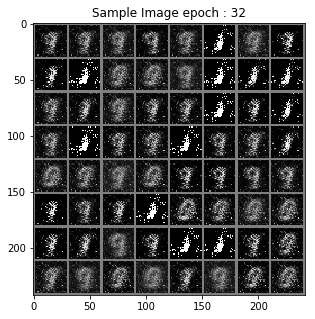

> Epoch : 34 Batch : 19 / 235 Loss_D : 0.3849716782569885 Loss_G : 3.4348831176757812
> Epoch : 34 Batch : 39 / 235 Loss_D : 0.11283901333808899 Loss_G : 7.100631237030029
> Epoch : 34 Batch : 59 / 235 Loss_D : 0.2577210068702698 Loss_G : 4.3725385665893555
> Epoch : 34 Batch : 79 / 235 Loss_D : 0.3106527030467987 Loss_G : 3.7100796699523926
> Epoch : 34 Batch : 99 / 235 Loss_D : 0.2533426582813263 Loss_G : 2.8493642807006836
> Epoch : 34 Batch : 119 / 235 Loss_D : 0.6078363656997681 Loss_G : 4.451818466186523
> Epoch : 34 Batch : 139 / 235 Loss_D : 0.5296710729598999 Loss_G : 3.292351484298706
> Epoch : 34 Batch : 159 / 235 Loss_D : 0.20224404335021973 Loss_G : 4.77137565612793
> Epoch : 34 Batch : 179 / 235 Loss_D : 0.2414928376674652 Loss_G : 4.31541633605957
> Epoch : 34 Batch : 199 / 235 Loss_D : 0.23191365599632263 Loss_G : 4.930330276489258
> Epoch : 34 Batch : 219 / 235 Loss_D : 0.6159241199493408 Loss_G : 4.322430610656738


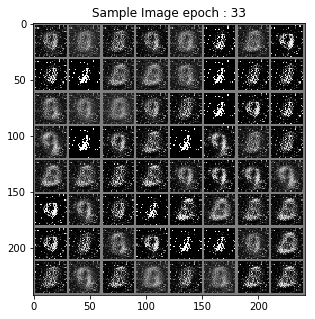

> Epoch : 35 Batch : 19 / 235 Loss_D : 0.2078491747379303 Loss_G : 5.016091346740723
> Epoch : 35 Batch : 39 / 235 Loss_D : 0.33910608291625977 Loss_G : 4.49726676940918
> Epoch : 35 Batch : 59 / 235 Loss_D : 0.4566836953163147 Loss_G : 3.8350489139556885
> Epoch : 35 Batch : 79 / 235 Loss_D : 0.4888654947280884 Loss_G : 3.395798683166504
> Epoch : 35 Batch : 99 / 235 Loss_D : 0.32086771726608276 Loss_G : 3.678678512573242
> Epoch : 35 Batch : 119 / 235 Loss_D : 0.3415963053703308 Loss_G : 3.8505492210388184
> Epoch : 35 Batch : 139 / 235 Loss_D : 0.4107312560081482 Loss_G : 6.72206449508667
> Epoch : 35 Batch : 159 / 235 Loss_D : 0.3099396824836731 Loss_G : 5.584458827972412
> Epoch : 35 Batch : 179 / 235 Loss_D : 0.8178595304489136 Loss_G : 7.70853328704834
> Epoch : 35 Batch : 199 / 235 Loss_D : 0.31499165296554565 Loss_G : 5.339818954467773
> Epoch : 35 Batch : 219 / 235 Loss_D : 0.48646649718284607 Loss_G : 4.049612045288086


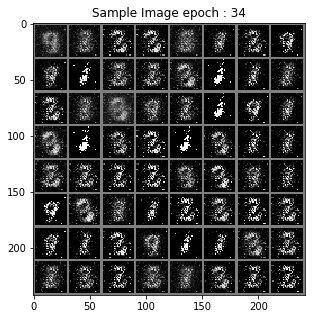

> Epoch : 36 Batch : 19 / 235 Loss_D : 0.2560059428215027 Loss_G : 5.976277828216553
> Epoch : 36 Batch : 39 / 235 Loss_D : 0.6364192962646484 Loss_G : 9.131340026855469
> Epoch : 36 Batch : 59 / 235 Loss_D : 1.2409096956253052 Loss_G : 5.8552961349487305
> Epoch : 36 Batch : 79 / 235 Loss_D : 0.35030215978622437 Loss_G : 6.614680290222168
> Epoch : 36 Batch : 99 / 235 Loss_D : 0.17586711049079895 Loss_G : 4.742832183837891
> Epoch : 36 Batch : 119 / 235 Loss_D : 0.43702709674835205 Loss_G : 4.0619964599609375
> Epoch : 36 Batch : 139 / 235 Loss_D : 0.3146403431892395 Loss_G : 5.491602897644043
> Epoch : 36 Batch : 159 / 235 Loss_D : 0.3984254002571106 Loss_G : 6.625967025756836
> Epoch : 36 Batch : 179 / 235 Loss_D : 0.16100171208381653 Loss_G : 6.141578674316406
> Epoch : 36 Batch : 199 / 235 Loss_D : 0.45201224088668823 Loss_G : 6.106260299682617
> Epoch : 36 Batch : 219 / 235 Loss_D : 0.848649799823761 Loss_G : 3.5732829570770264


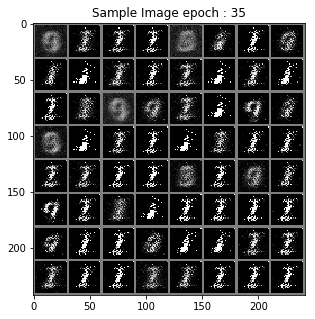

> Epoch : 37 Batch : 19 / 235 Loss_D : 0.5451312065124512 Loss_G : 3.0770413875579834
> Epoch : 37 Batch : 39 / 235 Loss_D : 0.7492349147796631 Loss_G : 3.7344400882720947
> Epoch : 37 Batch : 59 / 235 Loss_D : 0.1775778830051422 Loss_G : 4.228667259216309
> Epoch : 37 Batch : 79 / 235 Loss_D : 0.09816810488700867 Loss_G : 5.1776533126831055
> Epoch : 37 Batch : 99 / 235 Loss_D : 0.26194149255752563 Loss_G : 6.308879375457764
> Epoch : 37 Batch : 119 / 235 Loss_D : 0.4066373407840729 Loss_G : 4.6310601234436035
> Epoch : 37 Batch : 139 / 235 Loss_D : 0.28900739550590515 Loss_G : 4.955540180206299
> Epoch : 37 Batch : 159 / 235 Loss_D : 0.29247212409973145 Loss_G : 4.310681343078613
> Epoch : 37 Batch : 179 / 235 Loss_D : 0.41903749108314514 Loss_G : 3.2840538024902344
> Epoch : 37 Batch : 199 / 235 Loss_D : 0.36610326170921326 Loss_G : 3.977419376373291
> Epoch : 37 Batch : 219 / 235 Loss_D : 0.30655354261398315 Loss_G : 3.92582368850708


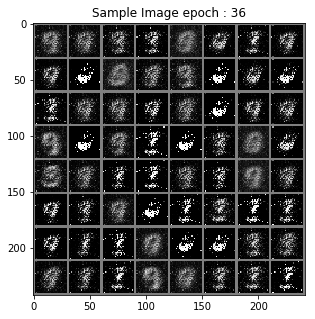

> Epoch : 38 Batch : 19 / 235 Loss_D : 0.5534093379974365 Loss_G : 4.813764572143555
> Epoch : 38 Batch : 39 / 235 Loss_D : 0.5707951784133911 Loss_G : 2.780076503753662
> Epoch : 38 Batch : 59 / 235 Loss_D : 0.32952892780303955 Loss_G : 4.76804780960083
> Epoch : 38 Batch : 79 / 235 Loss_D : 0.174513041973114 Loss_G : 3.9745564460754395
> Epoch : 38 Batch : 99 / 235 Loss_D : 0.260793000459671 Loss_G : 3.4800350666046143
> Epoch : 38 Batch : 119 / 235 Loss_D : 0.383015513420105 Loss_G : 3.6184799671173096
> Epoch : 38 Batch : 139 / 235 Loss_D : 0.14953318238258362 Loss_G : 5.975866317749023
> Epoch : 38 Batch : 159 / 235 Loss_D : 0.30218201875686646 Loss_G : 4.747759819030762
> Epoch : 38 Batch : 179 / 235 Loss_D : 0.838758111000061 Loss_G : 6.219661235809326
> Epoch : 38 Batch : 199 / 235 Loss_D : 0.39707130193710327 Loss_G : 4.316105842590332
> Epoch : 38 Batch : 219 / 235 Loss_D : 0.35147279500961304 Loss_G : 4.118424892425537


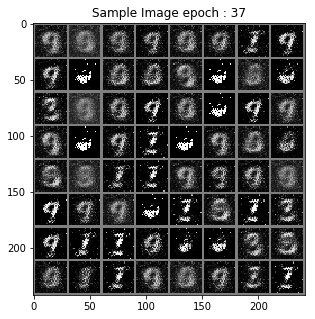

> Epoch : 39 Batch : 19 / 235 Loss_D : 0.3399657607078552 Loss_G : 4.173197269439697
> Epoch : 39 Batch : 39 / 235 Loss_D : 0.8253766298294067 Loss_G : 3.3109114170074463
> Epoch : 39 Batch : 59 / 235 Loss_D : 0.16687987744808197 Loss_G : 5.3361077308654785
> Epoch : 39 Batch : 79 / 235 Loss_D : 0.3809518814086914 Loss_G : 4.410212993621826
> Epoch : 39 Batch : 99 / 235 Loss_D : 0.39641618728637695 Loss_G : 4.784273147583008
> Epoch : 39 Batch : 119 / 235 Loss_D : 0.48079022765159607 Loss_G : 4.9884796142578125
> Epoch : 39 Batch : 139 / 235 Loss_D : 0.8132675290107727 Loss_G : 4.1204376220703125
> Epoch : 39 Batch : 159 / 235 Loss_D : 0.22083644568920135 Loss_G : 4.613826751708984
> Epoch : 39 Batch : 179 / 235 Loss_D : 0.41028136014938354 Loss_G : 4.080597877502441
> Epoch : 39 Batch : 199 / 235 Loss_D : 0.2730540633201599 Loss_G : 4.66860818862915
> Epoch : 39 Batch : 219 / 235 Loss_D : 0.4401628375053406 Loss_G : 6.186530113220215


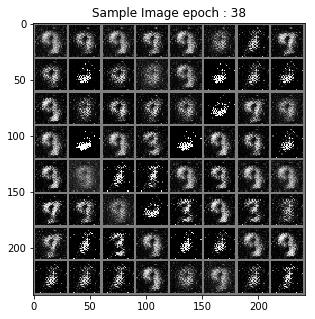

> Epoch : 40 Batch : 19 / 235 Loss_D : 0.7251779437065125 Loss_G : 4.912326812744141
> Epoch : 40 Batch : 39 / 235 Loss_D : 0.2833912670612335 Loss_G : 4.990645408630371
> Epoch : 40 Batch : 59 / 235 Loss_D : 0.5705429911613464 Loss_G : 4.902030944824219
> Epoch : 40 Batch : 79 / 235 Loss_D : 0.5009816884994507 Loss_G : 3.912149429321289
> Epoch : 40 Batch : 99 / 235 Loss_D : 0.9684001207351685 Loss_G : 4.691484451293945
> Epoch : 40 Batch : 119 / 235 Loss_D : 0.5386651158332825 Loss_G : 4.524715900421143
> Epoch : 40 Batch : 139 / 235 Loss_D : 0.34599053859710693 Loss_G : 4.888791561126709
> Epoch : 40 Batch : 159 / 235 Loss_D : 0.36855924129486084 Loss_G : 2.9925975799560547
> Epoch : 40 Batch : 179 / 235 Loss_D : 0.5738339424133301 Loss_G : 2.732030153274536
> Epoch : 40 Batch : 199 / 235 Loss_D : 0.5853395462036133 Loss_G : 5.182381629943848
> Epoch : 40 Batch : 219 / 235 Loss_D : 0.41480302810668945 Loss_G : 5.1701531410217285


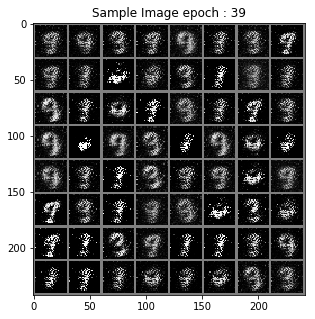

> Epoch : 41 Batch : 19 / 235 Loss_D : 0.5974245667457581 Loss_G : 4.726787567138672
> Epoch : 41 Batch : 39 / 235 Loss_D : 0.8012591004371643 Loss_G : 6.119517803192139
> Epoch : 41 Batch : 59 / 235 Loss_D : 0.5202941298484802 Loss_G : 7.002800941467285
> Epoch : 41 Batch : 79 / 235 Loss_D : 0.6291143894195557 Loss_G : 4.740645408630371
> Epoch : 41 Batch : 99 / 235 Loss_D : 0.599597156047821 Loss_G : 4.522103309631348
> Epoch : 41 Batch : 119 / 235 Loss_D : 0.5698872208595276 Loss_G : 4.929961681365967
> Epoch : 41 Batch : 139 / 235 Loss_D : 0.3153890371322632 Loss_G : 4.462751865386963
> Epoch : 41 Batch : 159 / 235 Loss_D : 0.43573570251464844 Loss_G : 4.599684715270996
> Epoch : 41 Batch : 179 / 235 Loss_D : 0.4190225601196289 Loss_G : 4.477630138397217
> Epoch : 41 Batch : 199 / 235 Loss_D : 0.7117640972137451 Loss_G : 3.203794002532959
> Epoch : 41 Batch : 219 / 235 Loss_D : 1.181856393814087 Loss_G : 2.2775421142578125


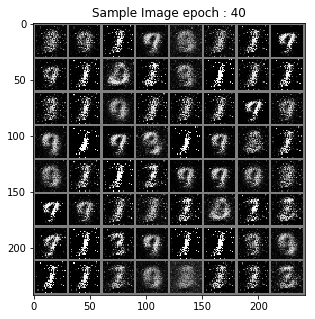

> Epoch : 42 Batch : 19 / 235 Loss_D : 0.36179208755493164 Loss_G : 3.510396957397461
> Epoch : 42 Batch : 39 / 235 Loss_D : 0.410325825214386 Loss_G : 3.163907527923584
> Epoch : 42 Batch : 59 / 235 Loss_D : 0.4735715687274933 Loss_G : 3.432234287261963
> Epoch : 42 Batch : 79 / 235 Loss_D : 0.41954249143600464 Loss_G : 5.451533317565918
> Epoch : 42 Batch : 99 / 235 Loss_D : 0.2875000238418579 Loss_G : 5.55580997467041
> Epoch : 42 Batch : 119 / 235 Loss_D : 0.5118478536605835 Loss_G : 4.46409273147583
> Epoch : 42 Batch : 139 / 235 Loss_D : 0.796667218208313 Loss_G : 2.9043192863464355
> Epoch : 42 Batch : 159 / 235 Loss_D : 0.811156153678894 Loss_G : 4.915732383728027
> Epoch : 42 Batch : 179 / 235 Loss_D : 0.4171125292778015 Loss_G : 4.730343818664551
> Epoch : 42 Batch : 199 / 235 Loss_D : 0.3602328300476074 Loss_G : 3.168949604034424
> Epoch : 42 Batch : 219 / 235 Loss_D : 0.5120459794998169 Loss_G : 2.73616099357605


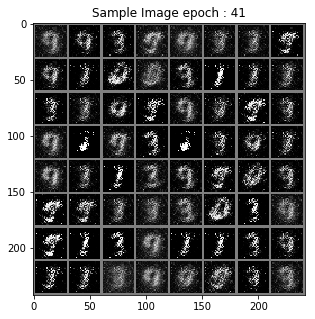

> Epoch : 43 Batch : 19 / 235 Loss_D : 0.9095590114593506 Loss_G : 4.039545059204102
> Epoch : 43 Batch : 39 / 235 Loss_D : 0.5821819305419922 Loss_G : 3.804903984069824
> Epoch : 43 Batch : 59 / 235 Loss_D : 0.29287829995155334 Loss_G : 4.640449523925781
> Epoch : 43 Batch : 79 / 235 Loss_D : 0.5682785511016846 Loss_G : 3.8301103115081787
> Epoch : 43 Batch : 99 / 235 Loss_D : 0.4145287275314331 Loss_G : 3.6366171836853027
> Epoch : 43 Batch : 119 / 235 Loss_D : 0.5062662363052368 Loss_G : 3.0799176692962646
> Epoch : 43 Batch : 139 / 235 Loss_D : 0.4425709843635559 Loss_G : 3.10640025138855
> Epoch : 43 Batch : 159 / 235 Loss_D : 0.3964806795120239 Loss_G : 3.624906539916992
> Epoch : 43 Batch : 179 / 235 Loss_D : 0.6029542684555054 Loss_G : 2.573068141937256
> Epoch : 43 Batch : 199 / 235 Loss_D : 0.7089368104934692 Loss_G : 2.9878554344177246
> Epoch : 43 Batch : 219 / 235 Loss_D : 0.34903985261917114 Loss_G : 3.941100835800171


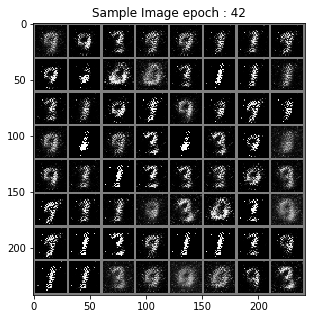

> Epoch : 44 Batch : 19 / 235 Loss_D : 0.3182750940322876 Loss_G : 5.115184783935547
> Epoch : 44 Batch : 39 / 235 Loss_D : 0.3625001609325409 Loss_G : 2.5222160816192627
> Epoch : 44 Batch : 59 / 235 Loss_D : 0.5280691385269165 Loss_G : 3.4422898292541504
> Epoch : 44 Batch : 79 / 235 Loss_D : 0.433023065328598 Loss_G : 2.8900985717773438
> Epoch : 44 Batch : 99 / 235 Loss_D : 0.42653730511665344 Loss_G : 4.500072479248047
> Epoch : 44 Batch : 119 / 235 Loss_D : 0.3771345615386963 Loss_G : 3.4520864486694336
> Epoch : 44 Batch : 139 / 235 Loss_D : 0.24288590252399445 Loss_G : 3.7421627044677734
> Epoch : 44 Batch : 159 / 235 Loss_D : 0.3168032765388489 Loss_G : 3.487665891647339
> Epoch : 44 Batch : 179 / 235 Loss_D : 0.3482290506362915 Loss_G : 2.916231632232666
> Epoch : 44 Batch : 199 / 235 Loss_D : 0.40756022930145264 Loss_G : 3.6432652473449707
> Epoch : 44 Batch : 219 / 235 Loss_D : 0.4080026149749756 Loss_G : 3.613986015319824


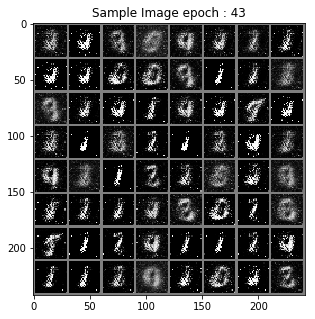

> Epoch : 45 Batch : 19 / 235 Loss_D : 0.577826738357544 Loss_G : 3.5134401321411133
> Epoch : 45 Batch : 39 / 235 Loss_D : 0.49952763319015503 Loss_G : 3.9123759269714355
> Epoch : 45 Batch : 59 / 235 Loss_D : 0.34689828753471375 Loss_G : 4.43540096282959
> Epoch : 45 Batch : 79 / 235 Loss_D : 0.4779869318008423 Loss_G : 4.300759315490723
> Epoch : 45 Batch : 99 / 235 Loss_D : 0.4191020131111145 Loss_G : 3.2393665313720703
> Epoch : 45 Batch : 119 / 235 Loss_D : 0.3947927951812744 Loss_G : 3.5776162147521973
> Epoch : 45 Batch : 139 / 235 Loss_D : 0.3721456527709961 Loss_G : 3.006646156311035
> Epoch : 45 Batch : 159 / 235 Loss_D : 0.420936644077301 Loss_G : 3.5319571495056152
> Epoch : 45 Batch : 179 / 235 Loss_D : 0.6302289962768555 Loss_G : 3.192019462585449
> Epoch : 45 Batch : 199 / 235 Loss_D : 0.7269773483276367 Loss_G : 2.421085834503174
> Epoch : 45 Batch : 219 / 235 Loss_D : 0.5458440184593201 Loss_G : 2.6672616004943848


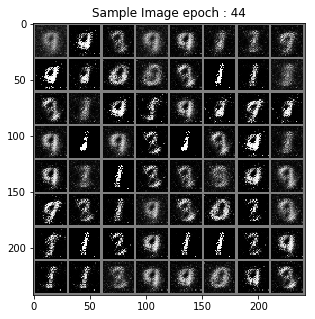

> Epoch : 46 Batch : 19 / 235 Loss_D : 0.3259830176830292 Loss_G : 2.954474449157715
> Epoch : 46 Batch : 39 / 235 Loss_D : 0.42065492272377014 Loss_G : 2.8924694061279297
> Epoch : 46 Batch : 59 / 235 Loss_D : 0.35301390290260315 Loss_G : 3.2844834327697754
> Epoch : 46 Batch : 79 / 235 Loss_D : 0.33393317461013794 Loss_G : 4.1451802253723145
> Epoch : 46 Batch : 99 / 235 Loss_D : 0.49508610367774963 Loss_G : 3.340816020965576
> Epoch : 46 Batch : 119 / 235 Loss_D : 0.3571845293045044 Loss_G : 4.321727275848389
> Epoch : 46 Batch : 139 / 235 Loss_D : 0.5208458304405212 Loss_G : 3.33139705657959
> Epoch : 46 Batch : 159 / 235 Loss_D : 0.6097655296325684 Loss_G : 4.5175886154174805
> Epoch : 46 Batch : 179 / 235 Loss_D : 0.5754057168960571 Loss_G : 4.122248649597168
> Epoch : 46 Batch : 199 / 235 Loss_D : 0.6724308133125305 Loss_G : 3.5832180976867676
> Epoch : 46 Batch : 219 / 235 Loss_D : 0.40421062707901 Loss_G : 4.544741630554199


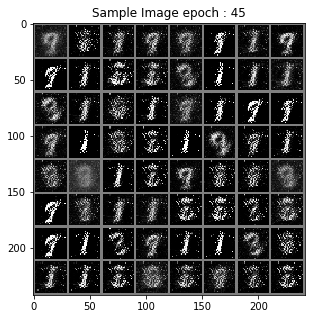

> Epoch : 47 Batch : 19 / 235 Loss_D : 0.8507681488990784 Loss_G : 4.353346824645996
> Epoch : 47 Batch : 39 / 235 Loss_D : 0.6281371116638184 Loss_G : 6.406834602355957
> Epoch : 47 Batch : 59 / 235 Loss_D : 0.925599217414856 Loss_G : 6.0331711769104
> Epoch : 47 Batch : 79 / 235 Loss_D : 0.6962339878082275 Loss_G : 4.532543659210205
> Epoch : 47 Batch : 99 / 235 Loss_D : 0.6621947288513184 Loss_G : 5.505441188812256
> Epoch : 47 Batch : 119 / 235 Loss_D : 0.47495198249816895 Loss_G : 4.935484886169434
> Epoch : 47 Batch : 139 / 235 Loss_D : 0.6546283960342407 Loss_G : 4.171315670013428
> Epoch : 47 Batch : 159 / 235 Loss_D : 0.8961432576179504 Loss_G : 6.051763534545898
> Epoch : 47 Batch : 179 / 235 Loss_D : 0.46314340829849243 Loss_G : 5.432064056396484
> Epoch : 47 Batch : 199 / 235 Loss_D : 0.7678861618041992 Loss_G : 4.321381568908691
> Epoch : 47 Batch : 219 / 235 Loss_D : 0.7605683207511902 Loss_G : 4.814540863037109


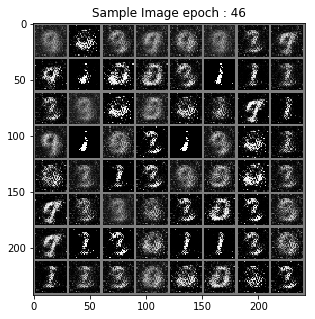

> Epoch : 48 Batch : 19 / 235 Loss_D : 0.05383593589067459 Loss_G : 6.186877727508545
> Epoch : 48 Batch : 39 / 235 Loss_D : 0.16183626651763916 Loss_G : 5.558652877807617
> Epoch : 48 Batch : 59 / 235 Loss_D : 1.628404974937439 Loss_G : 3.754894495010376
> Epoch : 48 Batch : 79 / 235 Loss_D : 0.33135974407196045 Loss_G : 3.0786993503570557
> Epoch : 48 Batch : 99 / 235 Loss_D : 0.21693183481693268 Loss_G : 4.096946716308594
> Epoch : 48 Batch : 119 / 235 Loss_D : 0.3398457169532776 Loss_G : 3.2010927200317383
> Epoch : 48 Batch : 139 / 235 Loss_D : 0.6209077835083008 Loss_G : 2.1361308097839355
> Epoch : 48 Batch : 159 / 235 Loss_D : 0.35859209299087524 Loss_G : 4.4470438957214355
> Epoch : 48 Batch : 179 / 235 Loss_D : 0.1867186725139618 Loss_G : 4.144391059875488
> Epoch : 48 Batch : 199 / 235 Loss_D : 0.300748348236084 Loss_G : 4.827951431274414
> Epoch : 48 Batch : 219 / 235 Loss_D : 0.5550588369369507 Loss_G : 4.0588226318359375


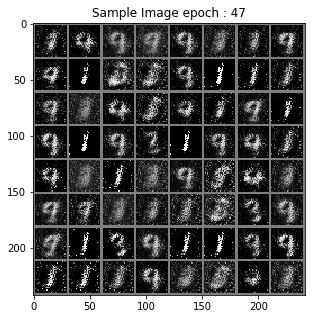

> Epoch : 49 Batch : 19 / 235 Loss_D : 0.3142906725406647 Loss_G : 4.566817283630371
> Epoch : 49 Batch : 39 / 235 Loss_D : 1.0247259140014648 Loss_G : 7.162714958190918
> Epoch : 49 Batch : 59 / 235 Loss_D : 0.3210943341255188 Loss_G : 10.100198745727539
> Epoch : 49 Batch : 79 / 235 Loss_D : 0.5762144327163696 Loss_G : 9.962785720825195
> Epoch : 49 Batch : 99 / 235 Loss_D : 2.790980577468872 Loss_G : 10.350838661193848
> Epoch : 49 Batch : 119 / 235 Loss_D : 1.4367315769195557 Loss_G : 11.629203796386719
> Epoch : 49 Batch : 139 / 235 Loss_D : 0.3753753900527954 Loss_G : 12.631231307983398
> Epoch : 49 Batch : 159 / 235 Loss_D : 2.7279982566833496 Loss_G : 7.548188209533691
> Epoch : 49 Batch : 179 / 235 Loss_D : 0.5930837392807007 Loss_G : 8.123298645019531
> Epoch : 49 Batch : 199 / 235 Loss_D : 0.13139228522777557 Loss_G : 9.194026947021484
> Epoch : 49 Batch : 219 / 235 Loss_D : 0.19370976090431213 Loss_G : 6.899397373199463


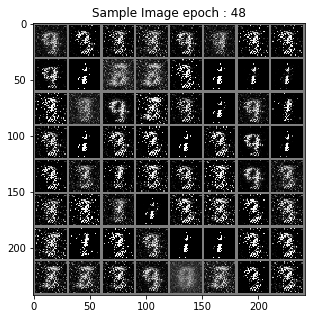

> Epoch : 50 Batch : 19 / 235 Loss_D : 0.9237169027328491 Loss_G : 5.719972133636475
> Epoch : 50 Batch : 39 / 235 Loss_D : 0.4210229218006134 Loss_G : 3.078263282775879
> Epoch : 50 Batch : 59 / 235 Loss_D : 0.35888367891311646 Loss_G : 4.61204719543457
> Epoch : 50 Batch : 79 / 235 Loss_D : 0.31368184089660645 Loss_G : 4.5648064613342285
> Epoch : 50 Batch : 99 / 235 Loss_D : 0.26103538274765015 Loss_G : 6.485818862915039
> Epoch : 50 Batch : 119 / 235 Loss_D : 0.3374055027961731 Loss_G : 6.947780609130859
> Epoch : 50 Batch : 139 / 235 Loss_D : 0.29835131764411926 Loss_G : 5.933464527130127
> Epoch : 50 Batch : 159 / 235 Loss_D : 0.6751801371574402 Loss_G : 4.914844036102295
> Epoch : 50 Batch : 179 / 235 Loss_D : 0.4811679720878601 Loss_G : 3.775336980819702
> Epoch : 50 Batch : 199 / 235 Loss_D : 0.2001597285270691 Loss_G : 4.105106353759766
> Epoch : 50 Batch : 219 / 235 Loss_D : 0.1767595112323761 Loss_G : 3.867400646209717


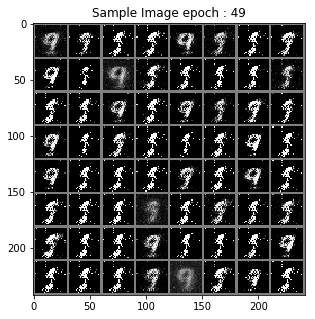

> Epoch : 51 Batch : 19 / 235 Loss_D : 0.24431408941745758 Loss_G : 3.1643991470336914
> Epoch : 51 Batch : 39 / 235 Loss_D : 0.29314300417900085 Loss_G : 4.861559867858887
> Epoch : 51 Batch : 59 / 235 Loss_D : 0.38699012994766235 Loss_G : 5.168277740478516
> Epoch : 51 Batch : 79 / 235 Loss_D : 0.3358997404575348 Loss_G : 4.561136245727539
> Epoch : 51 Batch : 99 / 235 Loss_D : 0.3095194101333618 Loss_G : 4.036091327667236
> Epoch : 51 Batch : 119 / 235 Loss_D : 0.31398600339889526 Loss_G : 3.629340648651123
> Epoch : 51 Batch : 139 / 235 Loss_D : 0.31977009773254395 Loss_G : 4.0521392822265625
> Epoch : 51 Batch : 159 / 235 Loss_D : 0.6187549829483032 Loss_G : 3.413278579711914
> Epoch : 51 Batch : 179 / 235 Loss_D : 0.6893205642700195 Loss_G : 3.9740335941314697
> Epoch : 51 Batch : 199 / 235 Loss_D : 0.4913868308067322 Loss_G : 2.707411289215088
> Epoch : 51 Batch : 219 / 235 Loss_D : 0.37080293893814087 Loss_G : 3.841193437576294


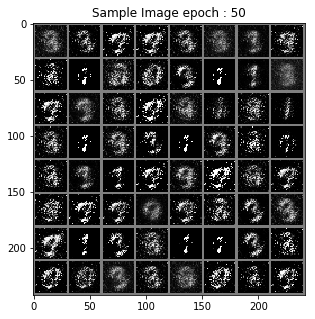

> Epoch : 52 Batch : 19 / 235 Loss_D : 0.39253661036491394 Loss_G : 2.7712619304656982
> Epoch : 52 Batch : 39 / 235 Loss_D : 0.5195132493972778 Loss_G : 3.1287002563476562
> Epoch : 52 Batch : 59 / 235 Loss_D : 0.30506521463394165 Loss_G : 2.761579990386963
> Epoch : 52 Batch : 79 / 235 Loss_D : 0.3690280020236969 Loss_G : 3.456339120864868
> Epoch : 52 Batch : 99 / 235 Loss_D : 0.5771302580833435 Loss_G : 2.851292371749878
> Epoch : 52 Batch : 119 / 235 Loss_D : 0.6773101091384888 Loss_G : 2.5314009189605713
> Epoch : 52 Batch : 139 / 235 Loss_D : 0.5719062089920044 Loss_G : 2.908721446990967
> Epoch : 52 Batch : 159 / 235 Loss_D : 0.3224527835845947 Loss_G : 2.161862850189209
> Epoch : 52 Batch : 179 / 235 Loss_D : 0.3720727860927582 Loss_G : 3.3433709144592285
> Epoch : 52 Batch : 199 / 235 Loss_D : 0.2782886028289795 Loss_G : 3.9491705894470215
> Epoch : 52 Batch : 219 / 235 Loss_D : 0.36999115347862244 Loss_G : 2.926802396774292


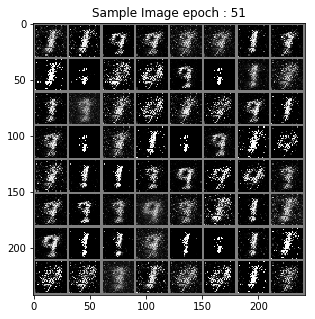

> Epoch : 53 Batch : 19 / 235 Loss_D : 0.305841863155365 Loss_G : 3.2493233680725098
> Epoch : 53 Batch : 39 / 235 Loss_D : 0.3622136116027832 Loss_G : 3.9704136848449707
> Epoch : 53 Batch : 59 / 235 Loss_D : 0.3416464328765869 Loss_G : 4.260388374328613
> Epoch : 53 Batch : 79 / 235 Loss_D : 0.4838368892669678 Loss_G : 4.802485466003418
> Epoch : 53 Batch : 99 / 235 Loss_D : 0.5292513370513916 Loss_G : 3.306678056716919
> Epoch : 53 Batch : 119 / 235 Loss_D : 0.41599130630493164 Loss_G : 4.920130252838135
> Epoch : 53 Batch : 139 / 235 Loss_D : 0.27598315477371216 Loss_G : 4.253722190856934
> Epoch : 53 Batch : 159 / 235 Loss_D : 0.4303781986236572 Loss_G : 3.7351739406585693
> Epoch : 53 Batch : 179 / 235 Loss_D : 0.6821719408035278 Loss_G : 2.800142288208008
> Epoch : 53 Batch : 199 / 235 Loss_D : 0.2815094590187073 Loss_G : 3.719252586364746
> Epoch : 53 Batch : 219 / 235 Loss_D : 0.37427544593811035 Loss_G : 3.482154369354248


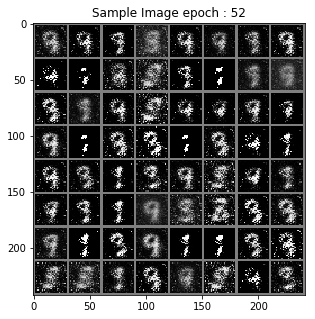

> Epoch : 54 Batch : 19 / 235 Loss_D : 0.20295608043670654 Loss_G : 3.373702049255371
> Epoch : 54 Batch : 39 / 235 Loss_D : 0.4633971154689789 Loss_G : 3.5118091106414795
> Epoch : 54 Batch : 59 / 235 Loss_D : 0.4272599220275879 Loss_G : 3.971379280090332
> Epoch : 54 Batch : 79 / 235 Loss_D : 0.38085347414016724 Loss_G : 3.6862125396728516
> Epoch : 54 Batch : 99 / 235 Loss_D : 0.22942481935024261 Loss_G : 4.400174617767334
> Epoch : 54 Batch : 119 / 235 Loss_D : 0.33430469036102295 Loss_G : 4.344415664672852
> Epoch : 54 Batch : 139 / 235 Loss_D : 0.5386636257171631 Loss_G : 2.7964272499084473
> Epoch : 54 Batch : 159 / 235 Loss_D : 0.3533084988594055 Loss_G : 3.3088042736053467
> Epoch : 54 Batch : 179 / 235 Loss_D : 0.34403425455093384 Loss_G : 3.9243381023406982
> Epoch : 54 Batch : 199 / 235 Loss_D : 0.4499240517616272 Loss_G : 4.165260314941406
> Epoch : 54 Batch : 219 / 235 Loss_D : 0.8395930528640747 Loss_G : 3.535013198852539


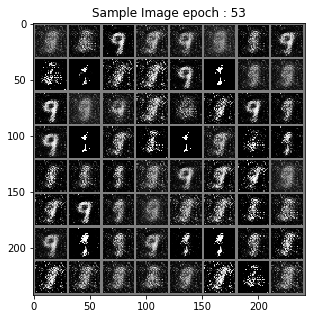

> Epoch : 55 Batch : 19 / 235 Loss_D : 0.8767744898796082 Loss_G : 3.6862902641296387
> Epoch : 55 Batch : 39 / 235 Loss_D : 0.3918072283267975 Loss_G : 3.8273744583129883
> Epoch : 55 Batch : 59 / 235 Loss_D : 0.4565146863460541 Loss_G : 3.5545570850372314
> Epoch : 55 Batch : 79 / 235 Loss_D : 0.47103151679039 Loss_G : 3.9317798614501953
> Epoch : 55 Batch : 99 / 235 Loss_D : 0.40731507539749146 Loss_G : 4.4154438972473145
> Epoch : 55 Batch : 119 / 235 Loss_D : 0.3195607364177704 Loss_G : 3.8029556274414062
> Epoch : 55 Batch : 139 / 235 Loss_D : 0.31601762771606445 Loss_G : 3.8251259326934814
> Epoch : 55 Batch : 159 / 235 Loss_D : 0.5123080611228943 Loss_G : 3.3757011890411377
> Epoch : 55 Batch : 179 / 235 Loss_D : 0.4953933656215668 Loss_G : 3.126154899597168
> Epoch : 55 Batch : 199 / 235 Loss_D : 0.37006622552871704 Loss_G : 4.698211193084717
> Epoch : 55 Batch : 219 / 235 Loss_D : 0.3236038386821747 Loss_G : 3.984287977218628


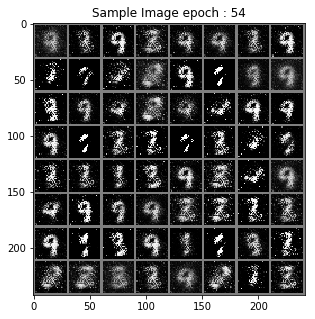

> Epoch : 56 Batch : 19 / 235 Loss_D : 0.6368787288665771 Loss_G : 3.521702289581299
> Epoch : 56 Batch : 39 / 235 Loss_D : 0.26404622197151184 Loss_G : 5.339613914489746
> Epoch : 56 Batch : 59 / 235 Loss_D : 0.4187122583389282 Loss_G : 3.831186532974243
> Epoch : 56 Batch : 79 / 235 Loss_D : 0.6367654800415039 Loss_G : 4.2733869552612305
> Epoch : 56 Batch : 99 / 235 Loss_D : 0.3921440541744232 Loss_G : 4.470860004425049
> Epoch : 56 Batch : 119 / 235 Loss_D : 0.31230852007865906 Loss_G : 5.675772666931152
> Epoch : 56 Batch : 139 / 235 Loss_D : 1.1382554769515991 Loss_G : 3.9162402153015137
> Epoch : 56 Batch : 159 / 235 Loss_D : 0.39973580837249756 Loss_G : 5.039656639099121
> Epoch : 56 Batch : 179 / 235 Loss_D : 0.36181965470314026 Loss_G : 4.967240810394287
> Epoch : 56 Batch : 199 / 235 Loss_D : 0.2667948603630066 Loss_G : 4.391117095947266
> Epoch : 56 Batch : 219 / 235 Loss_D : 0.3027746081352234 Loss_G : 3.622208595275879


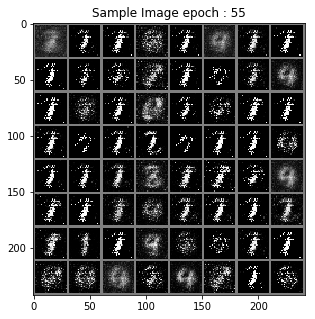

> Epoch : 57 Batch : 19 / 235 Loss_D : 0.4065666198730469 Loss_G : 3.2728514671325684
> Epoch : 57 Batch : 39 / 235 Loss_D : 0.41985684633255005 Loss_G : 4.214695930480957
> Epoch : 57 Batch : 59 / 235 Loss_D : 0.33429187536239624 Loss_G : 3.9798707962036133
> Epoch : 57 Batch : 79 / 235 Loss_D : 0.3191618323326111 Loss_G : 3.6773486137390137
> Epoch : 57 Batch : 99 / 235 Loss_D : 0.31695082783699036 Loss_G : 4.674849033355713
> Epoch : 57 Batch : 119 / 235 Loss_D : 0.3893826901912689 Loss_G : 3.956690788269043
> Epoch : 57 Batch : 139 / 235 Loss_D : 0.24238424003124237 Loss_G : 5.618203163146973
> Epoch : 57 Batch : 159 / 235 Loss_D : 0.5213261842727661 Loss_G : 2.492710828781128
> Epoch : 57 Batch : 179 / 235 Loss_D : 0.5493243932723999 Loss_G : 5.623226165771484
> Epoch : 57 Batch : 199 / 235 Loss_D : 0.38255545496940613 Loss_G : 4.093744277954102
> Epoch : 57 Batch : 219 / 235 Loss_D : 0.3663955330848694 Loss_G : 4.554619789123535


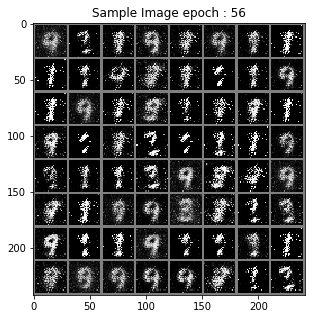

> Epoch : 58 Batch : 19 / 235 Loss_D : 0.43148642778396606 Loss_G : 4.104783058166504
> Epoch : 58 Batch : 39 / 235 Loss_D : 0.36073940992355347 Loss_G : 4.75203800201416
> Epoch : 58 Batch : 59 / 235 Loss_D : 0.38886427879333496 Loss_G : 5.06669807434082
> Epoch : 58 Batch : 79 / 235 Loss_D : 0.637391209602356 Loss_G : 3.000339984893799
> Epoch : 58 Batch : 99 / 235 Loss_D : 0.7104473114013672 Loss_G : 3.5974225997924805
> Epoch : 58 Batch : 119 / 235 Loss_D : 0.6877145767211914 Loss_G : 3.7750918865203857
> Epoch : 58 Batch : 139 / 235 Loss_D : 0.2786622643470764 Loss_G : 2.9928531646728516
> Epoch : 58 Batch : 159 / 235 Loss_D : 0.2512086033821106 Loss_G : 4.969049453735352
> Epoch : 58 Batch : 179 / 235 Loss_D : 0.3094794452190399 Loss_G : 4.2498321533203125
> Epoch : 58 Batch : 199 / 235 Loss_D : 0.3818460702896118 Loss_G : 4.1595683097839355
> Epoch : 58 Batch : 219 / 235 Loss_D : 0.448748379945755 Loss_G : 5.176549911499023


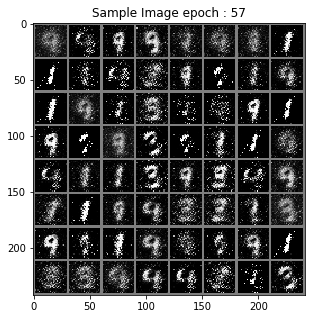

> Epoch : 59 Batch : 19 / 235 Loss_D : 0.2832804322242737 Loss_G : 4.030566215515137
> Epoch : 59 Batch : 39 / 235 Loss_D : 0.2944313883781433 Loss_G : 3.2535881996154785
> Epoch : 59 Batch : 59 / 235 Loss_D : 0.5481910109519958 Loss_G : 3.4914236068725586
> Epoch : 59 Batch : 79 / 235 Loss_D : 0.6211708784103394 Loss_G : 3.000189781188965
> Epoch : 59 Batch : 99 / 235 Loss_D : 0.609757661819458 Loss_G : 4.268834590911865
> Epoch : 59 Batch : 119 / 235 Loss_D : 0.4884869456291199 Loss_G : 6.34004020690918
> Epoch : 59 Batch : 139 / 235 Loss_D : 0.5083475708961487 Loss_G : 5.980147361755371
> Epoch : 59 Batch : 159 / 235 Loss_D : 0.4806894361972809 Loss_G : 4.737849712371826
> Epoch : 59 Batch : 179 / 235 Loss_D : 0.5736830234527588 Loss_G : 5.83632755279541
> Epoch : 59 Batch : 199 / 235 Loss_D : 0.33687394857406616 Loss_G : 5.928463459014893
> Epoch : 59 Batch : 219 / 235 Loss_D : 0.3447513282299042 Loss_G : 4.727636337280273


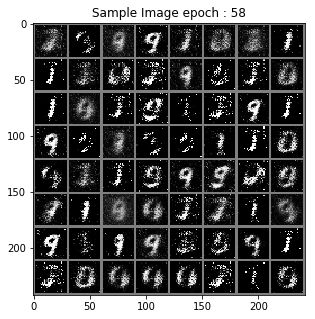

> Epoch : 60 Batch : 19 / 235 Loss_D : 0.3582794666290283 Loss_G : 5.365460395812988
> Epoch : 60 Batch : 39 / 235 Loss_D : 0.31110477447509766 Loss_G : 4.767657279968262
> Epoch : 60 Batch : 59 / 235 Loss_D : 0.3868246376514435 Loss_G : 6.703691482543945
> Epoch : 60 Batch : 79 / 235 Loss_D : 0.40365350246429443 Loss_G : 5.64094352722168
> Epoch : 60 Batch : 99 / 235 Loss_D : 0.6015845537185669 Loss_G : 3.8794236183166504
> Epoch : 60 Batch : 119 / 235 Loss_D : 0.630836009979248 Loss_G : 3.1714487075805664
> Epoch : 60 Batch : 139 / 235 Loss_D : 0.6587504744529724 Loss_G : 4.179491996765137
> Epoch : 60 Batch : 159 / 235 Loss_D : 0.6732667684555054 Loss_G : 3.971506357192993
> Epoch : 60 Batch : 179 / 235 Loss_D : 0.6995469927787781 Loss_G : 6.712690353393555
> Epoch : 60 Batch : 199 / 235 Loss_D : 0.7540122270584106 Loss_G : 8.819897651672363
> Epoch : 60 Batch : 219 / 235 Loss_D : 0.9595081806182861 Loss_G : 4.898351192474365


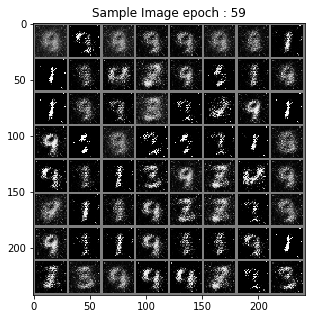

> Epoch : 61 Batch : 19 / 235 Loss_D : 0.21640178561210632 Loss_G : 4.536107063293457
> Epoch : 61 Batch : 39 / 235 Loss_D : 0.1354786604642868 Loss_G : 4.521085262298584
> Epoch : 61 Batch : 59 / 235 Loss_D : 0.23291054368019104 Loss_G : 4.701684951782227
> Epoch : 61 Batch : 79 / 235 Loss_D : 0.4317997097969055 Loss_G : 4.59767484664917
> Epoch : 61 Batch : 99 / 235 Loss_D : 0.18214723467826843 Loss_G : 5.398388862609863
> Epoch : 61 Batch : 119 / 235 Loss_D : 0.42683684825897217 Loss_G : 5.867656707763672
> Epoch : 61 Batch : 139 / 235 Loss_D : 0.3496621251106262 Loss_G : 5.526088714599609
> Epoch : 61 Batch : 159 / 235 Loss_D : 0.5335832238197327 Loss_G : 4.805605411529541
> Epoch : 61 Batch : 179 / 235 Loss_D : 0.465376615524292 Loss_G : 5.002204418182373
> Epoch : 61 Batch : 199 / 235 Loss_D : 0.26841843128204346 Loss_G : 5.250655174255371
> Epoch : 61 Batch : 219 / 235 Loss_D : 0.26389020681381226 Loss_G : 4.251623630523682


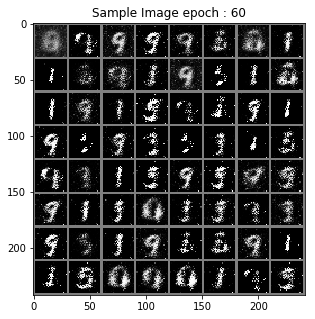

> Epoch : 62 Batch : 19 / 235 Loss_D : 0.44351619482040405 Loss_G : 2.8556418418884277
> Epoch : 62 Batch : 39 / 235 Loss_D : 0.41353633999824524 Loss_G : 3.781660795211792
> Epoch : 62 Batch : 59 / 235 Loss_D : 0.6061058044433594 Loss_G : 4.408390998840332
> Epoch : 62 Batch : 79 / 235 Loss_D : 0.2873309254646301 Loss_G : 4.003034591674805
> Epoch : 62 Batch : 99 / 235 Loss_D : 0.3191213607788086 Loss_G : 4.187956809997559
> Epoch : 62 Batch : 119 / 235 Loss_D : 0.281887412071228 Loss_G : 4.951403617858887
> Epoch : 62 Batch : 139 / 235 Loss_D : 0.3194584548473358 Loss_G : 3.6423754692077637
> Epoch : 62 Batch : 159 / 235 Loss_D : 0.4639987349510193 Loss_G : 4.0043439865112305
> Epoch : 62 Batch : 179 / 235 Loss_D : 0.31017619371414185 Loss_G : 3.5066614151000977
> Epoch : 62 Batch : 199 / 235 Loss_D : 0.46860286593437195 Loss_G : 3.58447003364563
> Epoch : 62 Batch : 219 / 235 Loss_D : 0.29989898204803467 Loss_G : 2.843721628189087


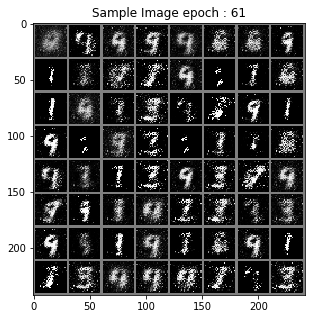

> Epoch : 63 Batch : 19 / 235 Loss_D : 0.35339072346687317 Loss_G : 4.045548915863037
> Epoch : 63 Batch : 39 / 235 Loss_D : 0.41554224491119385 Loss_G : 2.761080741882324
> Epoch : 63 Batch : 59 / 235 Loss_D : 0.3688066303730011 Loss_G : 4.092252731323242
> Epoch : 63 Batch : 79 / 235 Loss_D : 0.3469291031360626 Loss_G : 3.6057894229888916
> Epoch : 63 Batch : 99 / 235 Loss_D : 0.45715558528900146 Loss_G : 2.928927183151245
> Epoch : 63 Batch : 119 / 235 Loss_D : 0.29306772351264954 Loss_G : 2.935168743133545
> Epoch : 63 Batch : 139 / 235 Loss_D : 0.34083500504493713 Loss_G : 3.852980136871338
> Epoch : 63 Batch : 159 / 235 Loss_D : 0.45856380462646484 Loss_G : 3.1393489837646484
> Epoch : 63 Batch : 179 / 235 Loss_D : 0.280227392911911 Loss_G : 3.549226760864258
> Epoch : 63 Batch : 199 / 235 Loss_D : 0.24591031670570374 Loss_G : 3.359142780303955
> Epoch : 63 Batch : 219 / 235 Loss_D : 0.2819632291793823 Loss_G : 3.590632438659668


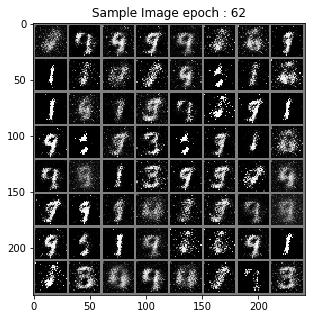

> Epoch : 64 Batch : 19 / 235 Loss_D : 0.3364109694957733 Loss_G : 3.6219258308410645
> Epoch : 64 Batch : 39 / 235 Loss_D : 0.323047935962677 Loss_G : 2.903636932373047
> Epoch : 64 Batch : 59 / 235 Loss_D : 0.23052749037742615 Loss_G : 5.7440876960754395
> Epoch : 64 Batch : 79 / 235 Loss_D : 0.3068634271621704 Loss_G : 4.24265193939209
> Epoch : 64 Batch : 99 / 235 Loss_D : 0.3892104923725128 Loss_G : 3.1180806159973145
> Epoch : 64 Batch : 119 / 235 Loss_D : 0.45291900634765625 Loss_G : 3.886488437652588
> Epoch : 64 Batch : 139 / 235 Loss_D : 0.1648802012205124 Loss_G : 4.391162872314453
> Epoch : 64 Batch : 159 / 235 Loss_D : 0.2522053122520447 Loss_G : 4.446036338806152
> Epoch : 64 Batch : 179 / 235 Loss_D : 0.30145764350891113 Loss_G : 3.3418636322021484
> Epoch : 64 Batch : 199 / 235 Loss_D : 0.22432832419872284 Loss_G : 5.100308418273926
> Epoch : 64 Batch : 219 / 235 Loss_D : 0.29409274458885193 Loss_G : 5.676892280578613


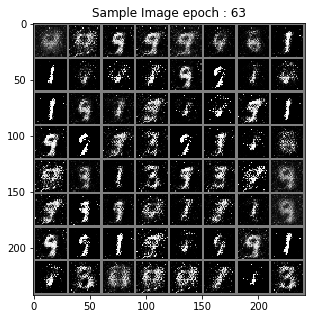

> Epoch : 65 Batch : 19 / 235 Loss_D : 0.5401593446731567 Loss_G : 3.5209879875183105
> Epoch : 65 Batch : 39 / 235 Loss_D : 0.4243423044681549 Loss_G : 4.806153297424316
> Epoch : 65 Batch : 59 / 235 Loss_D : 0.2801239490509033 Loss_G : 5.213324546813965
> Epoch : 65 Batch : 79 / 235 Loss_D : 0.3502907156944275 Loss_G : 6.387785911560059
> Epoch : 65 Batch : 99 / 235 Loss_D : 0.455566942691803 Loss_G : 3.537984609603882
> Epoch : 65 Batch : 119 / 235 Loss_D : 0.62744140625 Loss_G : 2.432689666748047
> Epoch : 65 Batch : 139 / 235 Loss_D : 0.33498281240463257 Loss_G : 4.134174823760986
> Epoch : 65 Batch : 159 / 235 Loss_D : 0.3283810615539551 Loss_G : 5.026603698730469
> Epoch : 65 Batch : 179 / 235 Loss_D : 0.15409298241138458 Loss_G : 5.731668472290039
> Epoch : 65 Batch : 199 / 235 Loss_D : 0.3043256998062134 Loss_G : 4.389134407043457
> Epoch : 65 Batch : 219 / 235 Loss_D : 0.22363734245300293 Loss_G : 5.1329216957092285


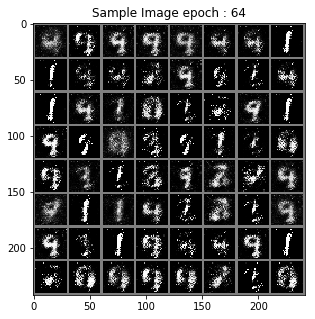

> Epoch : 66 Batch : 19 / 235 Loss_D : 0.3771647810935974 Loss_G : 3.373657464981079
> Epoch : 66 Batch : 39 / 235 Loss_D : 0.3379770517349243 Loss_G : 4.2125244140625
> Epoch : 66 Batch : 59 / 235 Loss_D : 0.24059909582138062 Loss_G : 4.7066521644592285
> Epoch : 66 Batch : 79 / 235 Loss_D : 0.28029072284698486 Loss_G : 4.7199387550354
> Epoch : 66 Batch : 99 / 235 Loss_D : 0.16674914956092834 Loss_G : 3.6744887828826904
> Epoch : 66 Batch : 119 / 235 Loss_D : 0.24300436675548553 Loss_G : 3.698126792907715
> Epoch : 66 Batch : 139 / 235 Loss_D : 0.26640430092811584 Loss_G : 6.098728656768799
> Epoch : 66 Batch : 159 / 235 Loss_D : 0.35821783542633057 Loss_G : 4.461875915527344
> Epoch : 66 Batch : 179 / 235 Loss_D : 0.23040932416915894 Loss_G : 4.699619293212891
> Epoch : 66 Batch : 199 / 235 Loss_D : 0.22451381385326385 Loss_G : 4.098123550415039
> Epoch : 66 Batch : 219 / 235 Loss_D : 0.35368913412094116 Loss_G : 4.747142791748047


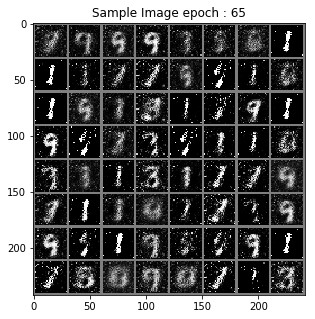

> Epoch : 67 Batch : 19 / 235 Loss_D : 0.43335890769958496 Loss_G : 5.061766624450684
> Epoch : 67 Batch : 39 / 235 Loss_D : 0.3154721260070801 Loss_G : 4.067154884338379
> Epoch : 67 Batch : 59 / 235 Loss_D : 0.24576425552368164 Loss_G : 4.029272079467773
> Epoch : 67 Batch : 79 / 235 Loss_D : 0.5489862561225891 Loss_G : 3.8088583946228027
> Epoch : 67 Batch : 99 / 235 Loss_D : 0.23787225782871246 Loss_G : 4.365070343017578
> Epoch : 67 Batch : 119 / 235 Loss_D : 0.28786328434944153 Loss_G : 4.420603275299072
> Epoch : 67 Batch : 139 / 235 Loss_D : 0.27100610733032227 Loss_G : 5.616731643676758
> Epoch : 67 Batch : 159 / 235 Loss_D : 0.36985039710998535 Loss_G : 3.9683992862701416
> Epoch : 67 Batch : 179 / 235 Loss_D : 0.4821752607822418 Loss_G : 4.494617462158203
> Epoch : 67 Batch : 199 / 235 Loss_D : 0.19416281580924988 Loss_G : 5.066707611083984
> Epoch : 67 Batch : 219 / 235 Loss_D : 0.39546847343444824 Loss_G : 4.957029819488525


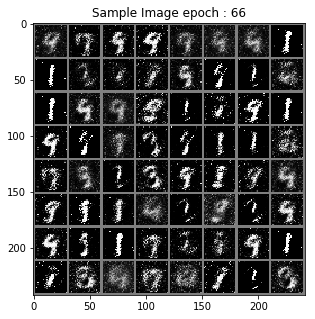

> Epoch : 68 Batch : 19 / 235 Loss_D : 0.3848550021648407 Loss_G : 3.174633741378784
> Epoch : 68 Batch : 39 / 235 Loss_D : 0.33926528692245483 Loss_G : 4.194365978240967
> Epoch : 68 Batch : 59 / 235 Loss_D : 0.16976912319660187 Loss_G : 4.377862930297852
> Epoch : 68 Batch : 79 / 235 Loss_D : 0.28864073753356934 Loss_G : 4.384501934051514
> Epoch : 68 Batch : 99 / 235 Loss_D : 0.20255380868911743 Loss_G : 5.682441234588623
> Epoch : 68 Batch : 119 / 235 Loss_D : 0.25732046365737915 Loss_G : 4.529056072235107
> Epoch : 68 Batch : 139 / 235 Loss_D : 0.2820485234260559 Loss_G : 5.428772926330566
> Epoch : 68 Batch : 159 / 235 Loss_D : 0.16219215095043182 Loss_G : 4.334996223449707
> Epoch : 68 Batch : 179 / 235 Loss_D : 0.3693959414958954 Loss_G : 4.2571821212768555
> Epoch : 68 Batch : 199 / 235 Loss_D : 0.2612747550010681 Loss_G : 3.247389793395996
> Epoch : 68 Batch : 219 / 235 Loss_D : 0.17970669269561768 Loss_G : 4.143739223480225


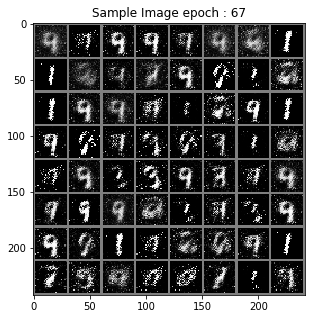

> Epoch : 69 Batch : 19 / 235 Loss_D : 0.3152760863304138 Loss_G : 6.169909477233887
> Epoch : 69 Batch : 39 / 235 Loss_D : 0.19963815808296204 Loss_G : 5.644184112548828
> Epoch : 69 Batch : 59 / 235 Loss_D : 0.31768548488616943 Loss_G : 6.2828450202941895
> Epoch : 69 Batch : 79 / 235 Loss_D : 0.2550084590911865 Loss_G : 4.586731910705566
> Epoch : 69 Batch : 99 / 235 Loss_D : 0.37765228748321533 Loss_G : 4.023815155029297
> Epoch : 69 Batch : 119 / 235 Loss_D : 0.1908622682094574 Loss_G : 5.155092239379883
> Epoch : 69 Batch : 139 / 235 Loss_D : 0.1956276297569275 Loss_G : 4.612655162811279
> Epoch : 69 Batch : 159 / 235 Loss_D : 0.23651552200317383 Loss_G : 4.561665058135986
> Epoch : 69 Batch : 179 / 235 Loss_D : 0.23273597657680511 Loss_G : 4.415134906768799
> Epoch : 69 Batch : 199 / 235 Loss_D : 0.169812873005867 Loss_G : 5.9638447761535645
> Epoch : 69 Batch : 219 / 235 Loss_D : 0.3878745436668396 Loss_G : 4.258993148803711


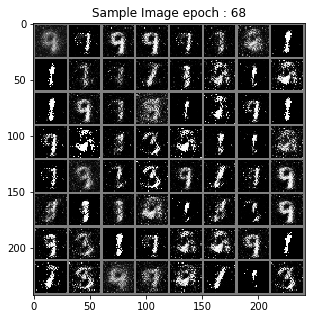

> Epoch : 70 Batch : 19 / 235 Loss_D : 0.5738476514816284 Loss_G : 4.503180503845215
> Epoch : 70 Batch : 39 / 235 Loss_D : 0.16888926923274994 Loss_G : 4.98912239074707
> Epoch : 70 Batch : 59 / 235 Loss_D : 0.38067588210105896 Loss_G : 3.543382406234741
> Epoch : 70 Batch : 79 / 235 Loss_D : 0.4083443880081177 Loss_G : 3.744438648223877
> Epoch : 70 Batch : 99 / 235 Loss_D : 0.2617867887020111 Loss_G : 4.2112298011779785
> Epoch : 70 Batch : 119 / 235 Loss_D : 0.2847388684749603 Loss_G : 5.673648834228516
> Epoch : 70 Batch : 139 / 235 Loss_D : 0.2275380641222 Loss_G : 3.5304372310638428
> Epoch : 70 Batch : 159 / 235 Loss_D : 0.178598552942276 Loss_G : 4.678645610809326
> Epoch : 70 Batch : 179 / 235 Loss_D : 0.4928538203239441 Loss_G : 2.986506938934326
> Epoch : 70 Batch : 199 / 235 Loss_D : 0.229855477809906 Loss_G : 4.484877586364746
> Epoch : 70 Batch : 219 / 235 Loss_D : 0.2802780270576477 Loss_G : 4.344444274902344


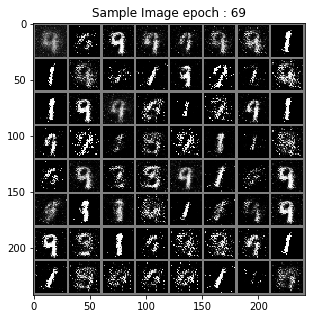

> Epoch : 71 Batch : 19 / 235 Loss_D : 0.38042891025543213 Loss_G : 4.786804676055908
> Epoch : 71 Batch : 39 / 235 Loss_D : 0.288082093000412 Loss_G : 4.443516731262207
> Epoch : 71 Batch : 59 / 235 Loss_D : 0.3426339626312256 Loss_G : 5.4033708572387695
> Epoch : 71 Batch : 79 / 235 Loss_D : 0.3418472409248352 Loss_G : 4.295130729675293
> Epoch : 71 Batch : 99 / 235 Loss_D : 0.2675015330314636 Loss_G : 4.439186096191406
> Epoch : 71 Batch : 119 / 235 Loss_D : 0.35615256428718567 Loss_G : 4.075144290924072
> Epoch : 71 Batch : 139 / 235 Loss_D : 0.4048936367034912 Loss_G : 4.090195178985596
> Epoch : 71 Batch : 159 / 235 Loss_D : 0.6558724045753479 Loss_G : 2.5580334663391113
> Epoch : 71 Batch : 179 / 235 Loss_D : 0.24100317060947418 Loss_G : 3.131143093109131
> Epoch : 71 Batch : 199 / 235 Loss_D : 0.23247605562210083 Loss_G : 5.319306373596191
> Epoch : 71 Batch : 219 / 235 Loss_D : 0.2773626446723938 Loss_G : 4.492342472076416


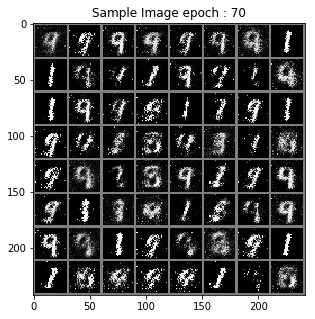

> Epoch : 72 Batch : 19 / 235 Loss_D : 0.2717042565345764 Loss_G : 4.001801490783691
> Epoch : 72 Batch : 39 / 235 Loss_D : 0.40462633967399597 Loss_G : 4.488220691680908
> Epoch : 72 Batch : 59 / 235 Loss_D : 0.37122777104377747 Loss_G : 5.267769813537598
> Epoch : 72 Batch : 79 / 235 Loss_D : 0.19025889039039612 Loss_G : 6.232329368591309
> Epoch : 72 Batch : 99 / 235 Loss_D : 0.3127902150154114 Loss_G : 4.084641456604004
> Epoch : 72 Batch : 119 / 235 Loss_D : 0.5364518165588379 Loss_G : 3.708979606628418
> Epoch : 72 Batch : 139 / 235 Loss_D : 0.29433146119117737 Loss_G : 4.120221138000488
> Epoch : 72 Batch : 159 / 235 Loss_D : 0.19939908385276794 Loss_G : 4.441784858703613
> Epoch : 72 Batch : 179 / 235 Loss_D : 0.3524206876754761 Loss_G : 3.4010226726531982
> Epoch : 72 Batch : 199 / 235 Loss_D : 0.2922709584236145 Loss_G : 4.966246604919434
> Epoch : 72 Batch : 219 / 235 Loss_D : 0.20485347509384155 Loss_G : 4.39984655380249


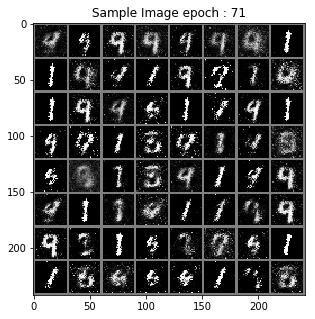

> Epoch : 73 Batch : 19 / 235 Loss_D : 0.29541224241256714 Loss_G : 4.298141002655029
> Epoch : 73 Batch : 39 / 235 Loss_D : 0.38754621148109436 Loss_G : 4.792633056640625
> Epoch : 73 Batch : 59 / 235 Loss_D : 0.49840742349624634 Loss_G : 4.192282676696777
> Epoch : 73 Batch : 79 / 235 Loss_D : 0.22746124863624573 Loss_G : 3.8072845935821533
> Epoch : 73 Batch : 99 / 235 Loss_D : 0.29452458024024963 Loss_G : 4.151254653930664
> Epoch : 73 Batch : 119 / 235 Loss_D : 0.22054384648799896 Loss_G : 3.987091064453125
> Epoch : 73 Batch : 139 / 235 Loss_D : 0.305825412273407 Loss_G : 4.0913777351379395
> Epoch : 73 Batch : 159 / 235 Loss_D : 0.47050759196281433 Loss_G : 3.8048219680786133
> Epoch : 73 Batch : 179 / 235 Loss_D : 0.3465833067893982 Loss_G : 4.011264324188232
> Epoch : 73 Batch : 199 / 235 Loss_D : 0.3078686594963074 Loss_G : 4.064826965332031
> Epoch : 73 Batch : 219 / 235 Loss_D : 0.22797858715057373 Loss_G : 4.502216339111328


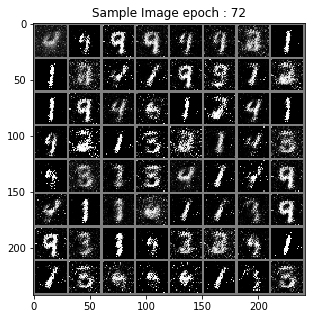

> Epoch : 74 Batch : 19 / 235 Loss_D : 0.21937163174152374 Loss_G : 5.92828369140625
> Epoch : 74 Batch : 39 / 235 Loss_D : 0.4642845392227173 Loss_G : 5.406098365783691
> Epoch : 74 Batch : 59 / 235 Loss_D : 0.27381107211112976 Loss_G : 4.923408508300781
> Epoch : 74 Batch : 79 / 235 Loss_D : 0.2536764442920685 Loss_G : 4.148244380950928
> Epoch : 74 Batch : 99 / 235 Loss_D : 0.2917422652244568 Loss_G : 5.831159591674805
> Epoch : 74 Batch : 119 / 235 Loss_D : 0.5632439255714417 Loss_G : 4.634392738342285
> Epoch : 74 Batch : 139 / 235 Loss_D : 0.3105771541595459 Loss_G : 4.072727203369141
> Epoch : 74 Batch : 159 / 235 Loss_D : 0.22136247158050537 Loss_G : 4.463695526123047
> Epoch : 74 Batch : 179 / 235 Loss_D : 0.19788096845149994 Loss_G : 4.734747409820557
> Epoch : 74 Batch : 199 / 235 Loss_D : 0.20238065719604492 Loss_G : 4.038984775543213
> Epoch : 74 Batch : 219 / 235 Loss_D : 0.28041788935661316 Loss_G : 5.73259162902832


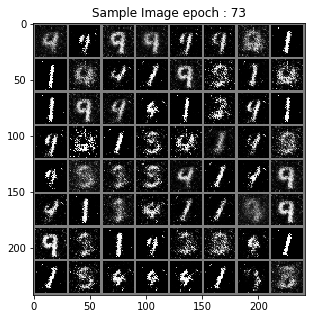

> Epoch : 75 Batch : 19 / 235 Loss_D : 0.44466570019721985 Loss_G : 7.19318151473999
> Epoch : 75 Batch : 39 / 235 Loss_D : 0.40072596073150635 Loss_G : 2.641148567199707
> Epoch : 75 Batch : 59 / 235 Loss_D : 0.2490682303905487 Loss_G : 2.9557909965515137
> Epoch : 75 Batch : 79 / 235 Loss_D : 0.23482230305671692 Loss_G : 3.244778633117676
> Epoch : 75 Batch : 99 / 235 Loss_D : 0.2822549045085907 Loss_G : 4.371189594268799
> Epoch : 75 Batch : 119 / 235 Loss_D : 0.4058114290237427 Loss_G : 3.793130397796631
> Epoch : 75 Batch : 139 / 235 Loss_D : 0.4072510302066803 Loss_G : 3.369771957397461
> Epoch : 75 Batch : 159 / 235 Loss_D : 0.3497985005378723 Loss_G : 3.534193992614746
> Epoch : 75 Batch : 179 / 235 Loss_D : 0.4243626594543457 Loss_G : 3.0656609535217285
> Epoch : 75 Batch : 199 / 235 Loss_D : 0.22331392765045166 Loss_G : 4.486578941345215
> Epoch : 75 Batch : 219 / 235 Loss_D : 0.3006833493709564 Loss_G : 4.056951522827148


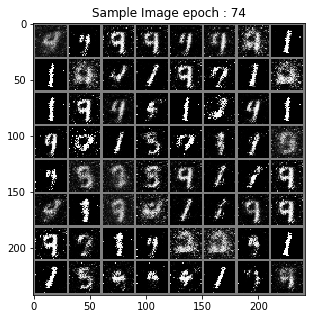

> Epoch : 76 Batch : 19 / 235 Loss_D : 0.22762641310691833 Loss_G : 3.6140377521514893
> Epoch : 76 Batch : 39 / 235 Loss_D : 0.2814047932624817 Loss_G : 5.266964435577393
> Epoch : 76 Batch : 59 / 235 Loss_D : 0.301795095205307 Loss_G : 5.730449676513672
> Epoch : 76 Batch : 79 / 235 Loss_D : 0.8946439623832703 Loss_G : 4.237411022186279
> Epoch : 76 Batch : 99 / 235 Loss_D : 0.3182361125946045 Loss_G : 4.588324069976807
> Epoch : 76 Batch : 119 / 235 Loss_D : 0.28310245275497437 Loss_G : 3.908277988433838
> Epoch : 76 Batch : 139 / 235 Loss_D : 0.2619742453098297 Loss_G : 3.9281058311462402
> Epoch : 76 Batch : 159 / 235 Loss_D : 0.35009586811065674 Loss_G : 3.3680686950683594
> Epoch : 76 Batch : 179 / 235 Loss_D : 0.42771852016448975 Loss_G : 3.811652183532715
> Epoch : 76 Batch : 199 / 235 Loss_D : 0.4021734595298767 Loss_G : 3.5967507362365723
> Epoch : 76 Batch : 219 / 235 Loss_D : 0.38809365034103394 Loss_G : 2.780919313430786


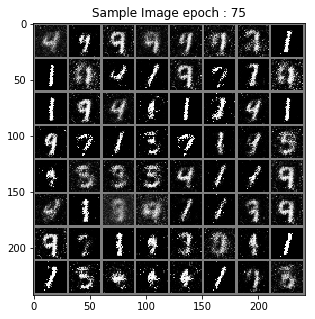

> Epoch : 77 Batch : 19 / 235 Loss_D : 0.5633119940757751 Loss_G : 3.652540683746338
> Epoch : 77 Batch : 39 / 235 Loss_D : 0.4474375247955322 Loss_G : 2.466167449951172
> Epoch : 77 Batch : 59 / 235 Loss_D : 0.385090172290802 Loss_G : 2.930309295654297
> Epoch : 77 Batch : 79 / 235 Loss_D : 0.5348864793777466 Loss_G : 3.555727481842041
> Epoch : 77 Batch : 99 / 235 Loss_D : 0.4409465193748474 Loss_G : 3.4946603775024414
> Epoch : 77 Batch : 119 / 235 Loss_D : 0.3760298192501068 Loss_G : 4.016756057739258
> Epoch : 77 Batch : 139 / 235 Loss_D : 0.2928087115287781 Loss_G : 4.5051727294921875
> Epoch : 77 Batch : 159 / 235 Loss_D : 0.3038385510444641 Loss_G : 4.375791549682617
> Epoch : 77 Batch : 179 / 235 Loss_D : 0.38631510734558105 Loss_G : 3.5553033351898193
> Epoch : 77 Batch : 199 / 235 Loss_D : 0.39101114869117737 Loss_G : 3.8770740032196045
> Epoch : 77 Batch : 219 / 235 Loss_D : 0.3260027766227722 Loss_G : 3.128864049911499


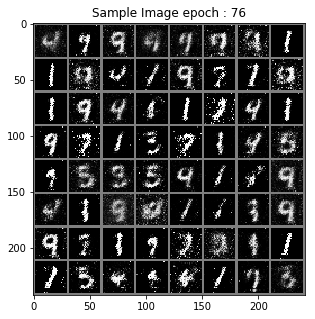

> Epoch : 78 Batch : 19 / 235 Loss_D : 0.3833622932434082 Loss_G : 2.9887964725494385
> Epoch : 78 Batch : 39 / 235 Loss_D : 0.302348792552948 Loss_G : 3.4694385528564453
> Epoch : 78 Batch : 59 / 235 Loss_D : 0.2973825931549072 Loss_G : 3.497035503387451
> Epoch : 78 Batch : 79 / 235 Loss_D : 0.30082693696022034 Loss_G : 3.777585506439209
> Epoch : 78 Batch : 99 / 235 Loss_D : 0.43776240944862366 Loss_G : 4.467082500457764
> Epoch : 78 Batch : 119 / 235 Loss_D : 0.3521745800971985 Loss_G : 3.5184414386749268
> Epoch : 78 Batch : 139 / 235 Loss_D : 0.4362494945526123 Loss_G : 2.9645683765411377
> Epoch : 78 Batch : 159 / 235 Loss_D : 0.2723011374473572 Loss_G : 3.3263964653015137
> Epoch : 78 Batch : 179 / 235 Loss_D : 0.2683568596839905 Loss_G : 5.031213283538818
> Epoch : 78 Batch : 199 / 235 Loss_D : 0.3217206299304962 Loss_G : 4.192427635192871
> Epoch : 78 Batch : 219 / 235 Loss_D : 0.3279537856578827 Loss_G : 3.3456687927246094


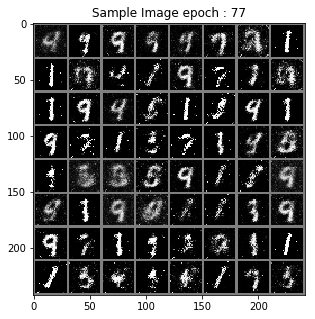

> Epoch : 79 Batch : 19 / 235 Loss_D : 0.44218966364860535 Loss_G : 3.111837863922119
> Epoch : 79 Batch : 39 / 235 Loss_D : 0.5064098834991455 Loss_G : 3.452019214630127
> Epoch : 79 Batch : 59 / 235 Loss_D : 0.39048925042152405 Loss_G : 3.627254009246826
> Epoch : 79 Batch : 79 / 235 Loss_D : 0.27017951011657715 Loss_G : 3.7985949516296387
> Epoch : 79 Batch : 99 / 235 Loss_D : 0.38741955161094666 Loss_G : 3.44448184967041
> Epoch : 79 Batch : 119 / 235 Loss_D : 0.3827096223831177 Loss_G : 3.584907054901123
> Epoch : 79 Batch : 139 / 235 Loss_D : 0.32335296273231506 Loss_G : 4.119781970977783
> Epoch : 79 Batch : 159 / 235 Loss_D : 0.5066180229187012 Loss_G : 4.499166488647461
> Epoch : 79 Batch : 179 / 235 Loss_D : 0.4205459654331207 Loss_G : 4.371952056884766
> Epoch : 79 Batch : 199 / 235 Loss_D : 0.44242390990257263 Loss_G : 5.095858573913574
> Epoch : 79 Batch : 219 / 235 Loss_D : 0.2118019461631775 Loss_G : 4.033166885375977


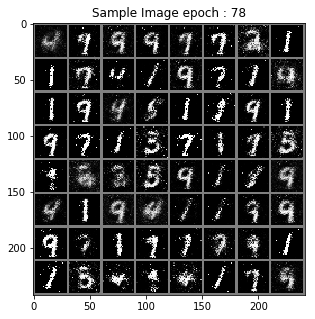

> Epoch : 80 Batch : 19 / 235 Loss_D : 0.2867271304130554 Loss_G : 4.7568359375
> Epoch : 80 Batch : 39 / 235 Loss_D : 0.30965447425842285 Loss_G : 3.625788450241089
> Epoch : 80 Batch : 59 / 235 Loss_D : 0.3692997097969055 Loss_G : 4.006537437438965
> Epoch : 80 Batch : 79 / 235 Loss_D : 0.4704279899597168 Loss_G : 2.6959123611450195
> Epoch : 80 Batch : 99 / 235 Loss_D : 0.27855122089385986 Loss_G : 3.4368200302124023
> Epoch : 80 Batch : 119 / 235 Loss_D : 0.2966812252998352 Loss_G : 3.9294943809509277
> Epoch : 80 Batch : 139 / 235 Loss_D : 0.28241634368896484 Loss_G : 4.703934192657471
> Epoch : 80 Batch : 159 / 235 Loss_D : 0.4745514690876007 Loss_G : 4.352063179016113
> Epoch : 80 Batch : 179 / 235 Loss_D : 0.41959846019744873 Loss_G : 3.838996410369873
> Epoch : 80 Batch : 199 / 235 Loss_D : 0.28153878450393677 Loss_G : 4.967628479003906
> Epoch : 80 Batch : 219 / 235 Loss_D : 0.4109259843826294 Loss_G : 3.005251407623291


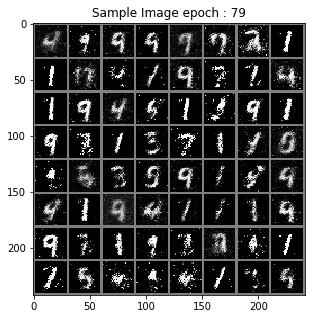

> Epoch : 81 Batch : 19 / 235 Loss_D : 0.2273712009191513 Loss_G : 3.374844551086426
> Epoch : 81 Batch : 39 / 235 Loss_D : 0.3960568904876709 Loss_G : 4.036020755767822
> Epoch : 81 Batch : 59 / 235 Loss_D : 0.31104254722595215 Loss_G : 3.8847341537475586
> Epoch : 81 Batch : 79 / 235 Loss_D : 0.3081790804862976 Loss_G : 4.3482818603515625
> Epoch : 81 Batch : 99 / 235 Loss_D : 0.33239424228668213 Loss_G : 4.042179107666016
> Epoch : 81 Batch : 119 / 235 Loss_D : 0.33502131700515747 Loss_G : 3.7057044506073
> Epoch : 81 Batch : 139 / 235 Loss_D : 0.4366702437400818 Loss_G : 4.361008644104004
> Epoch : 81 Batch : 159 / 235 Loss_D : 0.4008682370185852 Loss_G : 4.50509786605835
> Epoch : 81 Batch : 179 / 235 Loss_D : 0.24485880136489868 Loss_G : 3.281273126602173
> Epoch : 81 Batch : 199 / 235 Loss_D : 0.3999907970428467 Loss_G : 4.196028709411621
> Epoch : 81 Batch : 219 / 235 Loss_D : 0.2737938165664673 Loss_G : 4.389321804046631


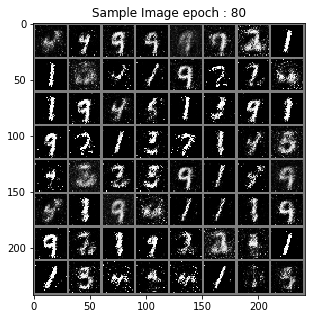

> Epoch : 82 Batch : 19 / 235 Loss_D : 0.4179522693157196 Loss_G : 3.543349266052246
> Epoch : 82 Batch : 39 / 235 Loss_D : 0.26685330271720886 Loss_G : 3.617053270339966
> Epoch : 82 Batch : 59 / 235 Loss_D : 0.24594774842262268 Loss_G : 3.2904210090637207
> Epoch : 82 Batch : 79 / 235 Loss_D : 0.3625558018684387 Loss_G : 4.130931854248047
> Epoch : 82 Batch : 99 / 235 Loss_D : 0.2624683380126953 Loss_G : 4.037333965301514
> Epoch : 82 Batch : 119 / 235 Loss_D : 0.4407788813114166 Loss_G : 3.1670053005218506
> Epoch : 82 Batch : 139 / 235 Loss_D : 0.24383006989955902 Loss_G : 4.093913555145264
> Epoch : 82 Batch : 159 / 235 Loss_D : 0.51482093334198 Loss_G : 4.761185646057129
> Epoch : 82 Batch : 179 / 235 Loss_D : 0.6484105587005615 Loss_G : 4.428037643432617
> Epoch : 82 Batch : 199 / 235 Loss_D : 0.4782562851905823 Loss_G : 3.2512407302856445
> Epoch : 82 Batch : 219 / 235 Loss_D : 0.37192821502685547 Loss_G : 4.030536651611328


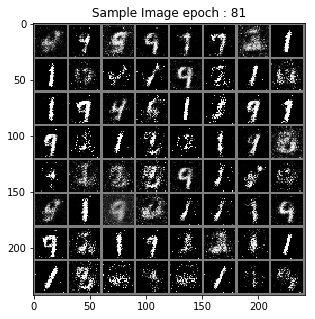

> Epoch : 83 Batch : 19 / 235 Loss_D : 0.34529972076416016 Loss_G : 4.007685661315918
> Epoch : 83 Batch : 39 / 235 Loss_D : 0.4406038224697113 Loss_G : 5.005618095397949
> Epoch : 83 Batch : 59 / 235 Loss_D : 0.502874493598938 Loss_G : 4.43486213684082
> Epoch : 83 Batch : 79 / 235 Loss_D : 0.5647227764129639 Loss_G : 3.2530879974365234
> Epoch : 83 Batch : 99 / 235 Loss_D : 0.24439561367034912 Loss_G : 3.6058509349823
> Epoch : 83 Batch : 119 / 235 Loss_D : 0.3524330258369446 Loss_G : 3.294853925704956
> Epoch : 83 Batch : 139 / 235 Loss_D : 0.4160665273666382 Loss_G : 3.117304801940918
> Epoch : 83 Batch : 159 / 235 Loss_D : 0.34316301345825195 Loss_G : 2.576603412628174
> Epoch : 83 Batch : 179 / 235 Loss_D : 0.3884991705417633 Loss_G : 3.6465446949005127
> Epoch : 83 Batch : 199 / 235 Loss_D : 0.23266562819480896 Loss_G : 3.1252760887145996
> Epoch : 83 Batch : 219 / 235 Loss_D : 0.2925264835357666 Loss_G : 3.131009340286255


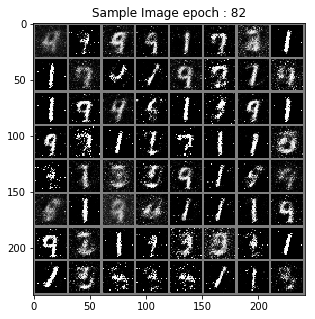

> Epoch : 84 Batch : 19 / 235 Loss_D : 0.3298284411430359 Loss_G : 4.210168838500977
> Epoch : 84 Batch : 39 / 235 Loss_D : 0.24976509809494019 Loss_G : 3.750216007232666
> Epoch : 84 Batch : 59 / 235 Loss_D : 0.38913264870643616 Loss_G : 5.047731876373291
> Epoch : 84 Batch : 79 / 235 Loss_D : 0.5050061345100403 Loss_G : 3.133777379989624
> Epoch : 84 Batch : 99 / 235 Loss_D : 0.31098097562789917 Loss_G : 3.5799202919006348
> Epoch : 84 Batch : 119 / 235 Loss_D : 0.33396536111831665 Loss_G : 3.2959864139556885
> Epoch : 84 Batch : 139 / 235 Loss_D : 0.3636898398399353 Loss_G : 3.4464914798736572
> Epoch : 84 Batch : 159 / 235 Loss_D : 0.3384858965873718 Loss_G : 5.019604206085205
> Epoch : 84 Batch : 179 / 235 Loss_D : 0.2887468636035919 Loss_G : 6.233032703399658
> Epoch : 84 Batch : 199 / 235 Loss_D : 0.3881523013114929 Loss_G : 3.737607479095459
> Epoch : 84 Batch : 219 / 235 Loss_D : 0.28270983695983887 Loss_G : 3.969719409942627


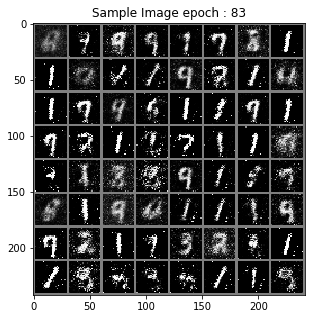

> Epoch : 85 Batch : 19 / 235 Loss_D : 0.4050414264202118 Loss_G : 3.788766860961914
> Epoch : 85 Batch : 39 / 235 Loss_D : 0.2727382779121399 Loss_G : 4.409828186035156
> Epoch : 85 Batch : 59 / 235 Loss_D : 0.6107062697410583 Loss_G : 3.9461896419525146
> Epoch : 85 Batch : 79 / 235 Loss_D : 0.5130496025085449 Loss_G : 3.7327823638916016
> Epoch : 85 Batch : 99 / 235 Loss_D : 0.3043028712272644 Loss_G : 3.3666398525238037
> Epoch : 85 Batch : 119 / 235 Loss_D : 0.2780202329158783 Loss_G : 4.0549821853637695
> Epoch : 85 Batch : 139 / 235 Loss_D : 0.31888526678085327 Loss_G : 3.561018228530884
> Epoch : 85 Batch : 159 / 235 Loss_D : 0.3649122416973114 Loss_G : 3.5011134147644043
> Epoch : 85 Batch : 179 / 235 Loss_D : 0.2901533842086792 Loss_G : 4.540706157684326
> Epoch : 85 Batch : 199 / 235 Loss_D : 0.35740482807159424 Loss_G : 4.449103832244873
> Epoch : 85 Batch : 219 / 235 Loss_D : 0.5024943351745605 Loss_G : 2.8784608840942383


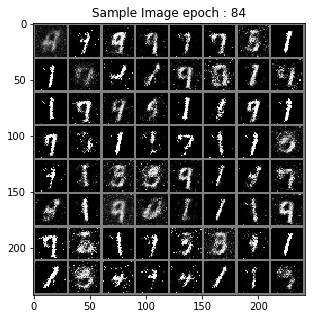

> Epoch : 86 Batch : 19 / 235 Loss_D : 0.30595892667770386 Loss_G : 3.2177679538726807
> Epoch : 86 Batch : 39 / 235 Loss_D : 0.3286901116371155 Loss_G : 4.222678184509277
> Epoch : 86 Batch : 59 / 235 Loss_D : 0.26685500144958496 Loss_G : 3.6783666610717773
> Epoch : 86 Batch : 79 / 235 Loss_D : 0.3258444368839264 Loss_G : 3.772308349609375
> Epoch : 86 Batch : 99 / 235 Loss_D : 0.4732896089553833 Loss_G : 2.4472079277038574
> Epoch : 86 Batch : 119 / 235 Loss_D : 0.36472198367118835 Loss_G : 3.896185874938965
> Epoch : 86 Batch : 139 / 235 Loss_D : 0.5224994421005249 Loss_G : 2.8772552013397217
> Epoch : 86 Batch : 159 / 235 Loss_D : 0.3519554138183594 Loss_G : 2.9379324913024902
> Epoch : 86 Batch : 179 / 235 Loss_D : 0.46120184659957886 Loss_G : 2.987086772918701
> Epoch : 86 Batch : 199 / 235 Loss_D : 0.5527075529098511 Loss_G : 2.888291835784912
> Epoch : 86 Batch : 219 / 235 Loss_D : 0.39582768082618713 Loss_G : 3.564925193786621


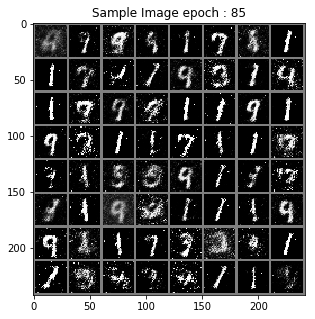

> Epoch : 87 Batch : 19 / 235 Loss_D : 0.45472636818885803 Loss_G : 2.9454433917999268
> Epoch : 87 Batch : 39 / 235 Loss_D : 0.47303131222724915 Loss_G : 2.703968048095703
> Epoch : 87 Batch : 59 / 235 Loss_D : 0.31765276193618774 Loss_G : 2.8684136867523193
> Epoch : 87 Batch : 79 / 235 Loss_D : 0.3101935088634491 Loss_G : 3.3895201683044434
> Epoch : 87 Batch : 99 / 235 Loss_D : 0.44377657771110535 Loss_G : 2.7710297107696533
> Epoch : 87 Batch : 119 / 235 Loss_D : 0.3880489766597748 Loss_G : 3.430957794189453
> Epoch : 87 Batch : 139 / 235 Loss_D : 0.3090502619743347 Loss_G : 3.6734204292297363
> Epoch : 87 Batch : 159 / 235 Loss_D : 0.4149617552757263 Loss_G : 3.5323195457458496
> Epoch : 87 Batch : 179 / 235 Loss_D : 0.3556205630302429 Loss_G : 4.771196365356445
> Epoch : 87 Batch : 199 / 235 Loss_D : 0.3446687161922455 Loss_G : 3.6228463649749756
> Epoch : 87 Batch : 219 / 235 Loss_D : 0.35261601209640503 Loss_G : 3.488341808319092


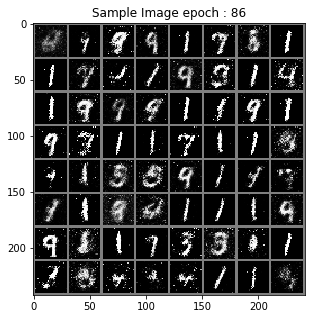

> Epoch : 88 Batch : 19 / 235 Loss_D : 0.5131310224533081 Loss_G : 3.2199628353118896
> Epoch : 88 Batch : 39 / 235 Loss_D : 0.2861365079879761 Loss_G : 3.784301280975342
> Epoch : 88 Batch : 59 / 235 Loss_D : 0.33920490741729736 Loss_G : 2.9738128185272217
> Epoch : 88 Batch : 79 / 235 Loss_D : 0.4951654076576233 Loss_G : 2.8668131828308105
> Epoch : 88 Batch : 99 / 235 Loss_D : 0.4133323132991791 Loss_G : 3.7896432876586914
> Epoch : 88 Batch : 119 / 235 Loss_D : 0.2640530467033386 Loss_G : 2.8037848472595215
> Epoch : 88 Batch : 139 / 235 Loss_D : 0.45675408840179443 Loss_G : 2.9192638397216797
> Epoch : 88 Batch : 159 / 235 Loss_D : 0.5812506675720215 Loss_G : 2.52394437789917
> Epoch : 88 Batch : 179 / 235 Loss_D : 0.5049151182174683 Loss_G : 3.155245780944824
> Epoch : 88 Batch : 199 / 235 Loss_D : 0.28428712487220764 Loss_G : 3.5294127464294434
> Epoch : 88 Batch : 219 / 235 Loss_D : 0.49356499314308167 Loss_G : 3.7533626556396484


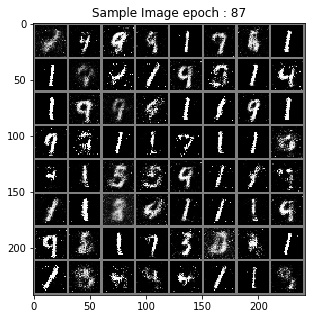

> Epoch : 89 Batch : 19 / 235 Loss_D : 0.24894064664840698 Loss_G : 3.477630853652954
> Epoch : 89 Batch : 39 / 235 Loss_D : 0.4249255359172821 Loss_G : 2.6922621726989746
> Epoch : 89 Batch : 59 / 235 Loss_D : 0.4066176116466522 Loss_G : 3.26084303855896
> Epoch : 89 Batch : 79 / 235 Loss_D : 0.31978362798690796 Loss_G : 4.044158935546875
> Epoch : 89 Batch : 99 / 235 Loss_D : 0.27214282751083374 Loss_G : 3.581468105316162
> Epoch : 89 Batch : 119 / 235 Loss_D : 0.34675222635269165 Loss_G : 4.024838924407959
> Epoch : 89 Batch : 139 / 235 Loss_D : 0.39003199338912964 Loss_G : 3.701347827911377
> Epoch : 89 Batch : 159 / 235 Loss_D : 0.489867240190506 Loss_G : 2.9048781394958496
> Epoch : 89 Batch : 179 / 235 Loss_D : 0.3461085259914398 Loss_G : 3.4006595611572266
> Epoch : 89 Batch : 199 / 235 Loss_D : 0.45819327235221863 Loss_G : 2.518115520477295
> Epoch : 89 Batch : 219 / 235 Loss_D : 0.30427443981170654 Loss_G : 4.0352373123168945


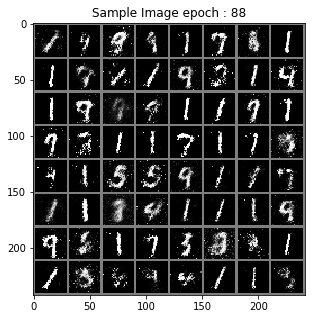

> Epoch : 90 Batch : 19 / 235 Loss_D : 0.3254512846469879 Loss_G : 4.217679500579834
> Epoch : 90 Batch : 39 / 235 Loss_D : 0.36563873291015625 Loss_G : 3.4832215309143066
> Epoch : 90 Batch : 59 / 235 Loss_D : 0.3642005920410156 Loss_G : 3.1524853706359863
> Epoch : 90 Batch : 79 / 235 Loss_D : 0.34367382526397705 Loss_G : 3.667008399963379
> Epoch : 90 Batch : 99 / 235 Loss_D : 0.4561529755592346 Loss_G : 3.5765433311462402
> Epoch : 90 Batch : 119 / 235 Loss_D : 0.47879961133003235 Loss_G : 3.8946008682250977
> Epoch : 90 Batch : 139 / 235 Loss_D : 0.39396825432777405 Loss_G : 3.6429343223571777
> Epoch : 90 Batch : 159 / 235 Loss_D : 0.5705687999725342 Loss_G : 3.3638415336608887
> Epoch : 90 Batch : 179 / 235 Loss_D : 0.43284371495246887 Loss_G : 2.9850590229034424
> Epoch : 90 Batch : 199 / 235 Loss_D : 0.6685124039649963 Loss_G : 3.4372105598449707
> Epoch : 90 Batch : 219 / 235 Loss_D : 0.33770233392715454 Loss_G : 3.4233293533325195


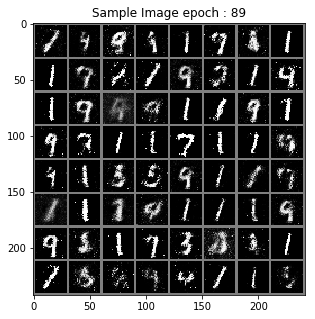

> Epoch : 91 Batch : 19 / 235 Loss_D : 0.5087685585021973 Loss_G : 3.581852436065674
> Epoch : 91 Batch : 39 / 235 Loss_D : 0.34329867362976074 Loss_G : 3.601083517074585
> Epoch : 91 Batch : 59 / 235 Loss_D : 0.5020135641098022 Loss_G : 3.162360906600952
> Epoch : 91 Batch : 79 / 235 Loss_D : 0.5913964509963989 Loss_G : 2.354721784591675
> Epoch : 91 Batch : 99 / 235 Loss_D : 0.3459208607673645 Loss_G : 2.7408273220062256
> Epoch : 91 Batch : 119 / 235 Loss_D : 0.4187673032283783 Loss_G : 2.5634429454803467
> Epoch : 91 Batch : 139 / 235 Loss_D : 0.3451329469680786 Loss_G : 3.443713665008545
> Epoch : 91 Batch : 159 / 235 Loss_D : 0.40676504373550415 Loss_G : 3.1903061866760254
> Epoch : 91 Batch : 179 / 235 Loss_D : 0.494329035282135 Loss_G : 3.4231481552124023
> Epoch : 91 Batch : 199 / 235 Loss_D : 0.38078582286834717 Loss_G : 2.92116117477417
> Epoch : 91 Batch : 219 / 235 Loss_D : 0.31899380683898926 Loss_G : 3.066957950592041


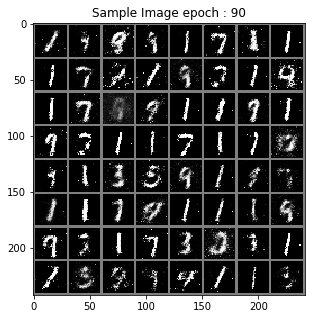

> Epoch : 92 Batch : 19 / 235 Loss_D : 0.36978453397750854 Loss_G : 2.7176690101623535
> Epoch : 92 Batch : 39 / 235 Loss_D : 0.2628495693206787 Loss_G : 4.253579139709473
> Epoch : 92 Batch : 59 / 235 Loss_D : 0.43611228466033936 Loss_G : 3.233731269836426
> Epoch : 92 Batch : 79 / 235 Loss_D : 0.34685835242271423 Loss_G : 3.2582430839538574
> Epoch : 92 Batch : 99 / 235 Loss_D : 0.3903224468231201 Loss_G : 2.691026449203491
> Epoch : 92 Batch : 119 / 235 Loss_D : 0.42458558082580566 Loss_G : 3.464144706726074
> Epoch : 92 Batch : 139 / 235 Loss_D : 0.5201345682144165 Loss_G : 2.805868148803711
> Epoch : 92 Batch : 159 / 235 Loss_D : 0.3381800651550293 Loss_G : 2.9337501525878906
> Epoch : 92 Batch : 179 / 235 Loss_D : 0.3191147446632385 Loss_G : 2.9901959896087646
> Epoch : 92 Batch : 199 / 235 Loss_D : 0.4074411392211914 Loss_G : 2.963989734649658
> Epoch : 92 Batch : 219 / 235 Loss_D : 0.2982892394065857 Loss_G : 3.4831960201263428


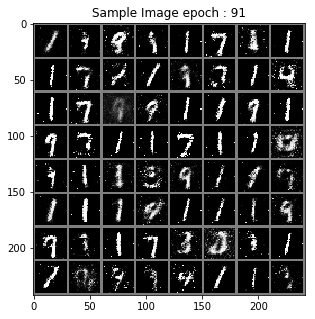

> Epoch : 93 Batch : 19 / 235 Loss_D : 0.5061602592468262 Loss_G : 3.252340316772461
> Epoch : 93 Batch : 39 / 235 Loss_D : 0.4025232195854187 Loss_G : 4.123043060302734
> Epoch : 93 Batch : 59 / 235 Loss_D : 0.526013970375061 Loss_G : 3.264831781387329
> Epoch : 93 Batch : 79 / 235 Loss_D : 0.35059094429016113 Loss_G : 3.329244613647461
> Epoch : 93 Batch : 99 / 235 Loss_D : 0.40451809763908386 Loss_G : 3.2405097484588623
> Epoch : 93 Batch : 119 / 235 Loss_D : 0.5178293585777283 Loss_G : 3.3202078342437744
> Epoch : 93 Batch : 139 / 235 Loss_D : 0.3599916398525238 Loss_G : 4.125251770019531
> Epoch : 93 Batch : 159 / 235 Loss_D : 0.4756636917591095 Loss_G : 3.506819486618042
> Epoch : 93 Batch : 179 / 235 Loss_D : 0.4472544491291046 Loss_G : 2.755413293838501
> Epoch : 93 Batch : 199 / 235 Loss_D : 0.4646100401878357 Loss_G : 2.427374839782715
> Epoch : 93 Batch : 219 / 235 Loss_D : 0.4133065938949585 Loss_G : 2.694319486618042


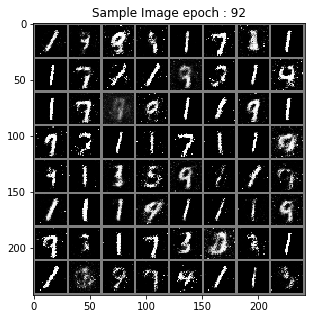

> Epoch : 94 Batch : 19 / 235 Loss_D : 0.3636436462402344 Loss_G : 3.3867874145507812
> Epoch : 94 Batch : 39 / 235 Loss_D : 0.4055340886116028 Loss_G : 3.687250852584839
> Epoch : 94 Batch : 59 / 235 Loss_D : 0.21777907013893127 Loss_G : 5.016264915466309
> Epoch : 94 Batch : 79 / 235 Loss_D : 0.531158983707428 Loss_G : 3.3282618522644043
> Epoch : 94 Batch : 99 / 235 Loss_D : 0.42962273955345154 Loss_G : 2.69699764251709
> Epoch : 94 Batch : 119 / 235 Loss_D : 0.4560425877571106 Loss_G : 2.998307704925537
> Epoch : 94 Batch : 139 / 235 Loss_D : 0.45188164710998535 Loss_G : 2.4999945163726807
> Epoch : 94 Batch : 159 / 235 Loss_D : 0.42101365327835083 Loss_G : 2.8956151008605957
> Epoch : 94 Batch : 179 / 235 Loss_D : 0.37651684880256653 Loss_G : 2.6907432079315186
> Epoch : 94 Batch : 199 / 235 Loss_D : 0.32750123739242554 Loss_G : 3.796278476715088
> Epoch : 94 Batch : 219 / 235 Loss_D : 0.3533344864845276 Loss_G : 3.6857376098632812


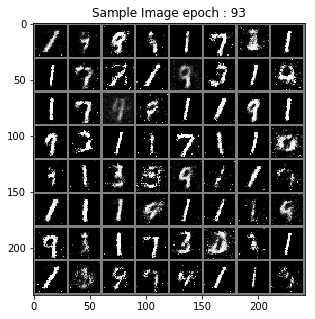

> Epoch : 95 Batch : 19 / 235 Loss_D : 0.40195780992507935 Loss_G : 3.1791768074035645
> Epoch : 95 Batch : 39 / 235 Loss_D : 0.32250162959098816 Loss_G : 2.685683250427246
> Epoch : 95 Batch : 59 / 235 Loss_D : 0.39828723669052124 Loss_G : 3.162045955657959
> Epoch : 95 Batch : 79 / 235 Loss_D : 0.5026031732559204 Loss_G : 2.241448163986206
> Epoch : 95 Batch : 99 / 235 Loss_D : 0.5405529737472534 Loss_G : 3.5838401317596436
> Epoch : 95 Batch : 119 / 235 Loss_D : 0.3117435574531555 Loss_G : 3.187682628631592
> Epoch : 95 Batch : 139 / 235 Loss_D : 0.5552904605865479 Loss_G : 3.5546422004699707
> Epoch : 95 Batch : 159 / 235 Loss_D : 0.42336589097976685 Loss_G : 3.2629048824310303
> Epoch : 95 Batch : 179 / 235 Loss_D : 0.4698723554611206 Loss_G : 3.077625274658203
> Epoch : 95 Batch : 199 / 235 Loss_D : 0.40237486362457275 Loss_G : 3.36130690574646
> Epoch : 95 Batch : 219 / 235 Loss_D : 0.4049246609210968 Loss_G : 3.013122797012329


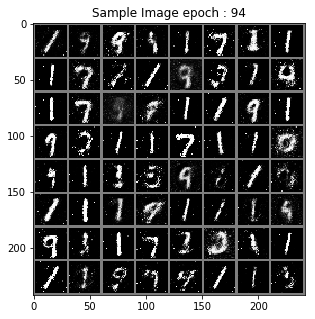

> Epoch : 96 Batch : 19 / 235 Loss_D : 0.4168649911880493 Loss_G : 3.742908000946045
> Epoch : 96 Batch : 39 / 235 Loss_D : 0.451316773891449 Loss_G : 3.250047445297241
> Epoch : 96 Batch : 59 / 235 Loss_D : 0.5346130728721619 Loss_G : 2.744260549545288
> Epoch : 96 Batch : 79 / 235 Loss_D : 0.5038480162620544 Loss_G : 3.150763750076294
> Epoch : 96 Batch : 99 / 235 Loss_D : 0.4516705870628357 Loss_G : 2.7976784706115723
> Epoch : 96 Batch : 119 / 235 Loss_D : 0.34265458583831787 Loss_G : 3.7582035064697266
> Epoch : 96 Batch : 139 / 235 Loss_D : 0.5408455729484558 Loss_G : 2.864945888519287
> Epoch : 96 Batch : 159 / 235 Loss_D : 0.47387421131134033 Loss_G : 2.897024631500244
> Epoch : 96 Batch : 179 / 235 Loss_D : 0.33673858642578125 Loss_G : 3.203256368637085
> Epoch : 96 Batch : 199 / 235 Loss_D : 0.5077395439147949 Loss_G : 2.6087486743927
> Epoch : 96 Batch : 219 / 235 Loss_D : 0.41149646043777466 Loss_G : 2.184642791748047


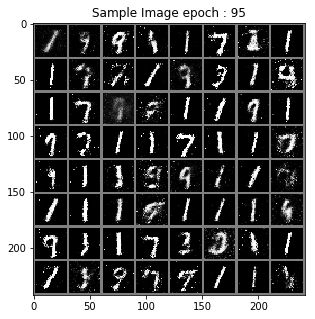

> Epoch : 97 Batch : 19 / 235 Loss_D : 0.3225991427898407 Loss_G : 3.2088143825531006
> Epoch : 97 Batch : 39 / 235 Loss_D : 0.44453221559524536 Loss_G : 3.2428600788116455
> Epoch : 97 Batch : 59 / 235 Loss_D : 0.5130422711372375 Loss_G : 2.7755513191223145
> Epoch : 97 Batch : 79 / 235 Loss_D : 0.4804283082485199 Loss_G : 2.6396496295928955
> Epoch : 97 Batch : 99 / 235 Loss_D : 0.5161328315734863 Loss_G : 2.331045627593994
> Epoch : 97 Batch : 119 / 235 Loss_D : 0.4689312279224396 Loss_G : 2.9639992713928223
> Epoch : 97 Batch : 139 / 235 Loss_D : 0.4504254460334778 Loss_G : 2.7602686882019043
> Epoch : 97 Batch : 159 / 235 Loss_D : 0.41764283180236816 Loss_G : 3.3801023960113525
> Epoch : 97 Batch : 179 / 235 Loss_D : 0.43391624093055725 Loss_G : 2.506622314453125
> Epoch : 97 Batch : 199 / 235 Loss_D : 0.3432213068008423 Loss_G : 3.4908435344696045
> Epoch : 97 Batch : 219 / 235 Loss_D : 0.4513503313064575 Loss_G : 3.349666118621826


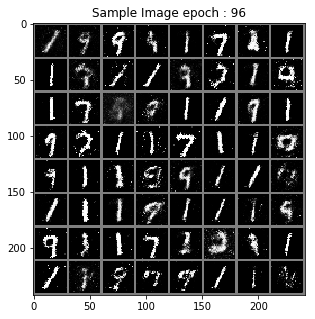

> Epoch : 98 Batch : 19 / 235 Loss_D : 0.5017385482788086 Loss_G : 2.295302152633667
> Epoch : 98 Batch : 39 / 235 Loss_D : 0.41067567467689514 Loss_G : 3.6275429725646973
> Epoch : 98 Batch : 59 / 235 Loss_D : 0.46792465448379517 Loss_G : 2.699570894241333
> Epoch : 98 Batch : 79 / 235 Loss_D : 0.36690616607666016 Loss_G : 3.202871084213257
> Epoch : 98 Batch : 99 / 235 Loss_D : 0.5670163631439209 Loss_G : 2.481645345687866
> Epoch : 98 Batch : 119 / 235 Loss_D : 0.5146857500076294 Loss_G : 2.4891347885131836
> Epoch : 98 Batch : 139 / 235 Loss_D : 0.34213608503341675 Loss_G : 3.0465283393859863
> Epoch : 98 Batch : 159 / 235 Loss_D : 0.4750587046146393 Loss_G : 2.6907031536102295
> Epoch : 98 Batch : 179 / 235 Loss_D : 0.43929749727249146 Loss_G : 2.31942081451416
> Epoch : 98 Batch : 199 / 235 Loss_D : 0.38133949041366577 Loss_G : 3.615544319152832
> Epoch : 98 Batch : 219 / 235 Loss_D : 0.5320113301277161 Loss_G : 2.9010884761810303


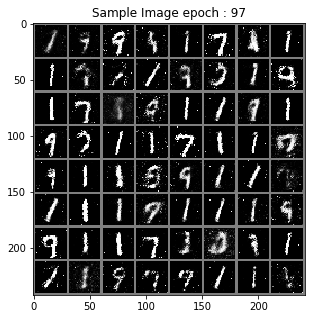

> Epoch : 99 Batch : 19 / 235 Loss_D : 0.617059051990509 Loss_G : 2.4242000579833984
> Epoch : 99 Batch : 39 / 235 Loss_D : 0.5175495147705078 Loss_G : 2.1452138423919678
> Epoch : 99 Batch : 59 / 235 Loss_D : 0.45329251885414124 Loss_G : 2.2220096588134766
> Epoch : 99 Batch : 79 / 235 Loss_D : 0.47882068157196045 Loss_G : 2.6420509815216064
> Epoch : 99 Batch : 99 / 235 Loss_D : 0.4200599789619446 Loss_G : 3.108219861984253
> Epoch : 99 Batch : 119 / 235 Loss_D : 0.44275206327438354 Loss_G : 3.3951663970947266
> Epoch : 99 Batch : 139 / 235 Loss_D : 0.336359441280365 Loss_G : 3.3732059001922607
> Epoch : 99 Batch : 159 / 235 Loss_D : 0.5205879807472229 Loss_G : 3.036062002182007
> Epoch : 99 Batch : 179 / 235 Loss_D : 0.4928520917892456 Loss_G : 2.4968225955963135
> Epoch : 99 Batch : 199 / 235 Loss_D : 0.45725566148757935 Loss_G : 2.2835357189178467
> Epoch : 99 Batch : 219 / 235 Loss_D : 0.4010816812515259 Loss_G : 3.269352674484253


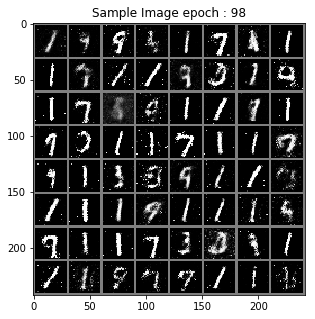

> Epoch : 100 Batch : 19 / 235 Loss_D : 0.4805484414100647 Loss_G : 2.9165899753570557
> Epoch : 100 Batch : 39 / 235 Loss_D : 0.39079391956329346 Loss_G : 2.263347864151001
> Epoch : 100 Batch : 59 / 235 Loss_D : 0.38519036769866943 Loss_G : 2.868966817855835
> Epoch : 100 Batch : 79 / 235 Loss_D : 0.39080744981765747 Loss_G : 2.8263702392578125
> Epoch : 100 Batch : 99 / 235 Loss_D : 0.3955346941947937 Loss_G : 2.9694621562957764
> Epoch : 100 Batch : 119 / 235 Loss_D : 0.586361825466156 Loss_G : 2.0515832901000977
> Epoch : 100 Batch : 139 / 235 Loss_D : 0.4351341724395752 Loss_G : 3.163001537322998
> Epoch : 100 Batch : 159 / 235 Loss_D : 0.45000869035720825 Loss_G : 2.6411750316619873
> Epoch : 100 Batch : 179 / 235 Loss_D : 0.427590012550354 Loss_G : 3.2991602420806885
> Epoch : 100 Batch : 199 / 235 Loss_D : 0.3379276990890503 Loss_G : 2.77852725982666
> Epoch : 100 Batch : 219 / 235 Loss_D : 0.5449988842010498 Loss_G : 2.099825143814087


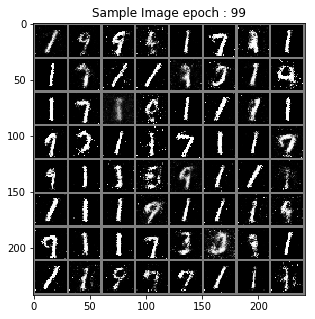

> Epoch : 101 Batch : 19 / 235 Loss_D : 0.4035859704017639 Loss_G : 2.9434146881103516
> Epoch : 101 Batch : 39 / 235 Loss_D : 0.39212533831596375 Loss_G : 2.8445262908935547
> Epoch : 101 Batch : 59 / 235 Loss_D : 0.45550644397735596 Loss_G : 3.178678512573242
> Epoch : 101 Batch : 79 / 235 Loss_D : 0.45347219705581665 Loss_G : 2.9365086555480957
> Epoch : 101 Batch : 99 / 235 Loss_D : 0.518221914768219 Loss_G : 2.7625250816345215
> Epoch : 101 Batch : 119 / 235 Loss_D : 0.5362300872802734 Loss_G : 2.877488613128662
> Epoch : 101 Batch : 139 / 235 Loss_D : 0.503221869468689 Loss_G : 3.3707103729248047
> Epoch : 101 Batch : 159 / 235 Loss_D : 0.44950568675994873 Loss_G : 3.1287150382995605
> Epoch : 101 Batch : 179 / 235 Loss_D : 0.576321005821228 Loss_G : 2.5110507011413574
> Epoch : 101 Batch : 199 / 235 Loss_D : 0.5310454368591309 Loss_G : 3.2292706966400146
> Epoch : 101 Batch : 219 / 235 Loss_D : 0.3815917372703552 Loss_G : 3.2493224143981934


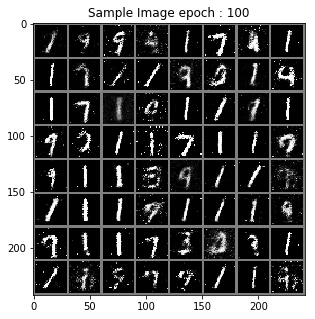

> Epoch : 102 Batch : 19 / 235 Loss_D : 0.41620802879333496 Loss_G : 3.693244695663452
> Epoch : 102 Batch : 39 / 235 Loss_D : 0.37620940804481506 Loss_G : 2.9382755756378174
> Epoch : 102 Batch : 59 / 235 Loss_D : 0.38926440477371216 Loss_G : 2.6326677799224854
> Epoch : 102 Batch : 79 / 235 Loss_D : 0.49451500177383423 Loss_G : 2.524510383605957
> Epoch : 102 Batch : 99 / 235 Loss_D : 0.40933120250701904 Loss_G : 3.1595120429992676
> Epoch : 102 Batch : 119 / 235 Loss_D : 0.4936024844646454 Loss_G : 3.50032901763916
> Epoch : 102 Batch : 139 / 235 Loss_D : 0.44046252965927124 Loss_G : 2.7268528938293457
> Epoch : 102 Batch : 159 / 235 Loss_D : 0.5723663568496704 Loss_G : 2.0467538833618164
> Epoch : 102 Batch : 179 / 235 Loss_D : 0.43358007073402405 Loss_G : 3.088627815246582
> Epoch : 102 Batch : 199 / 235 Loss_D : 0.39005815982818604 Loss_G : 3.3466176986694336
> Epoch : 102 Batch : 219 / 235 Loss_D : 0.3848420977592468 Loss_G : 3.652336835861206


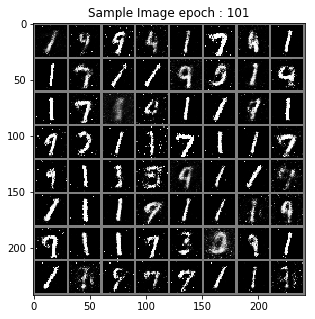

> Epoch : 103 Batch : 19 / 235 Loss_D : 0.4088672697544098 Loss_G : 2.749073028564453
> Epoch : 103 Batch : 39 / 235 Loss_D : 0.42731398344039917 Loss_G : 3.244743824005127
> Epoch : 103 Batch : 59 / 235 Loss_D : 0.40544748306274414 Loss_G : 3.2240869998931885
> Epoch : 103 Batch : 79 / 235 Loss_D : 0.4131239652633667 Loss_G : 3.0921411514282227
> Epoch : 103 Batch : 99 / 235 Loss_D : 0.6059995889663696 Loss_G : 3.4931023120880127
> Epoch : 103 Batch : 119 / 235 Loss_D : 0.4942549467086792 Loss_G : 3.702324390411377
> Epoch : 103 Batch : 139 / 235 Loss_D : 0.511506199836731 Loss_G : 2.5949723720550537
> Epoch : 103 Batch : 159 / 235 Loss_D : 0.42767369747161865 Loss_G : 2.7696776390075684
> Epoch : 103 Batch : 179 / 235 Loss_D : 0.5261121988296509 Loss_G : 2.4700193405151367
> Epoch : 103 Batch : 199 / 235 Loss_D : 0.4428527057170868 Loss_G : 2.8850173950195312
> Epoch : 103 Batch : 219 / 235 Loss_D : 0.5966392159461975 Loss_G : 3.2743704319000244


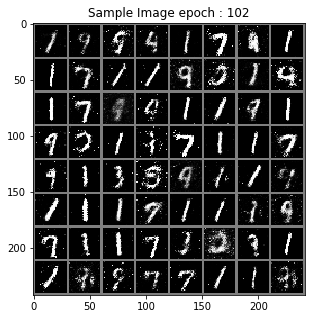

> Epoch : 104 Batch : 19 / 235 Loss_D : 0.3381592035293579 Loss_G : 3.34977388381958
> Epoch : 104 Batch : 39 / 235 Loss_D : 0.524900496006012 Loss_G : 2.5748636722564697
> Epoch : 104 Batch : 59 / 235 Loss_D : 0.4207739531993866 Loss_G : 2.6100730895996094
> Epoch : 104 Batch : 79 / 235 Loss_D : 0.5276042222976685 Loss_G : 2.4485068321228027
> Epoch : 104 Batch : 99 / 235 Loss_D : 0.4935223162174225 Loss_G : 2.8334264755249023
> Epoch : 104 Batch : 119 / 235 Loss_D : 0.3438625931739807 Loss_G : 2.7497446537017822
> Epoch : 104 Batch : 139 / 235 Loss_D : 0.5634905695915222 Loss_G : 2.6193833351135254
> Epoch : 104 Batch : 159 / 235 Loss_D : 0.47477203607559204 Loss_G : 2.3420228958129883
> Epoch : 104 Batch : 179 / 235 Loss_D : 0.40240082144737244 Loss_G : 2.4434940814971924
> Epoch : 104 Batch : 199 / 235 Loss_D : 0.4818114638328552 Loss_G : 2.580847978591919
> Epoch : 104 Batch : 219 / 235 Loss_D : 0.46876001358032227 Loss_G : 2.9418413639068604


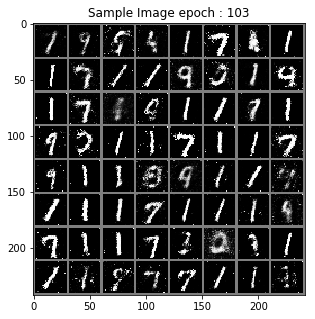

> Epoch : 105 Batch : 19 / 235 Loss_D : 0.41077327728271484 Loss_G : 2.9247519969940186
> Epoch : 105 Batch : 39 / 235 Loss_D : 0.4447115659713745 Loss_G : 3.2163922786712646
> Epoch : 105 Batch : 59 / 235 Loss_D : 0.4723765254020691 Loss_G : 2.463751792907715
> Epoch : 105 Batch : 79 / 235 Loss_D : 0.42686566710472107 Loss_G : 3.3809590339660645
> Epoch : 105 Batch : 99 / 235 Loss_D : 0.4850254952907562 Loss_G : 3.48164439201355
> Epoch : 105 Batch : 119 / 235 Loss_D : 0.6096804738044739 Loss_G : 2.221879482269287
> Epoch : 105 Batch : 139 / 235 Loss_D : 0.45506420731544495 Loss_G : 3.2077994346618652
> Epoch : 105 Batch : 159 / 235 Loss_D : 0.5630667209625244 Loss_G : 2.438040256500244
> Epoch : 105 Batch : 179 / 235 Loss_D : 0.3369819223880768 Loss_G : 3.3986406326293945
> Epoch : 105 Batch : 199 / 235 Loss_D : 0.5080463886260986 Loss_G : 2.2752432823181152
> Epoch : 105 Batch : 219 / 235 Loss_D : 0.4519341289997101 Loss_G : 3.116471529006958


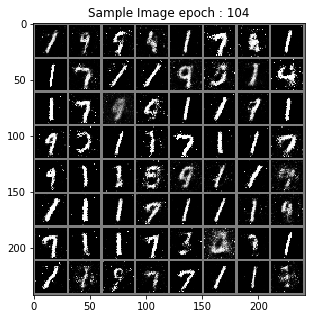

> Epoch : 106 Batch : 19 / 235 Loss_D : 0.5061963200569153 Loss_G : 2.5874369144439697
> Epoch : 106 Batch : 39 / 235 Loss_D : 0.3554641604423523 Loss_G : 3.3829803466796875
> Epoch : 106 Batch : 59 / 235 Loss_D : 0.6196897029876709 Loss_G : 2.5860016345977783
> Epoch : 106 Batch : 79 / 235 Loss_D : 0.5072168111801147 Loss_G : 2.947112798690796
> Epoch : 106 Batch : 99 / 235 Loss_D : 0.4639650285243988 Loss_G : 3.408250331878662
> Epoch : 106 Batch : 119 / 235 Loss_D : 0.5632192492485046 Loss_G : 2.3602771759033203
> Epoch : 106 Batch : 139 / 235 Loss_D : 0.38964784145355225 Loss_G : 2.474797248840332
> Epoch : 106 Batch : 159 / 235 Loss_D : 0.49339160323143005 Loss_G : 2.759735107421875
> Epoch : 106 Batch : 179 / 235 Loss_D : 0.36845821142196655 Loss_G : 2.8313748836517334
> Epoch : 106 Batch : 199 / 235 Loss_D : 0.47487229108810425 Loss_G : 2.8888726234436035
> Epoch : 106 Batch : 219 / 235 Loss_D : 0.481820285320282 Loss_G : 2.2008233070373535


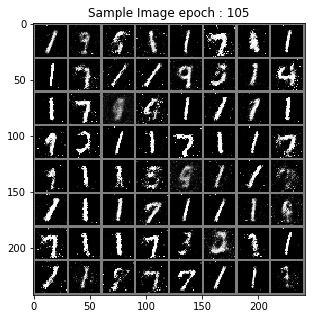

> Epoch : 107 Batch : 19 / 235 Loss_D : 0.48823675513267517 Loss_G : 2.6521780490875244
> Epoch : 107 Batch : 39 / 235 Loss_D : 0.47869327664375305 Loss_G : 2.621428966522217
> Epoch : 107 Batch : 59 / 235 Loss_D : 0.4943002760410309 Loss_G : 3.3685903549194336
> Epoch : 107 Batch : 79 / 235 Loss_D : 0.5517622828483582 Loss_G : 2.6160717010498047
> Epoch : 107 Batch : 99 / 235 Loss_D : 0.4432755410671234 Loss_G : 3.153268814086914
> Epoch : 107 Batch : 119 / 235 Loss_D : 0.5871627330780029 Loss_G : 2.7924838066101074
> Epoch : 107 Batch : 139 / 235 Loss_D : 0.37294477224349976 Loss_G : 2.544908046722412
> Epoch : 107 Batch : 159 / 235 Loss_D : 0.5318878293037415 Loss_G : 2.6953530311584473
> Epoch : 107 Batch : 179 / 235 Loss_D : 0.5497050285339355 Loss_G : 2.361198902130127
> Epoch : 107 Batch : 199 / 235 Loss_D : 0.5599713325500488 Loss_G : 2.4334001541137695
> Epoch : 107 Batch : 219 / 235 Loss_D : 0.39251041412353516 Loss_G : 2.825477123260498


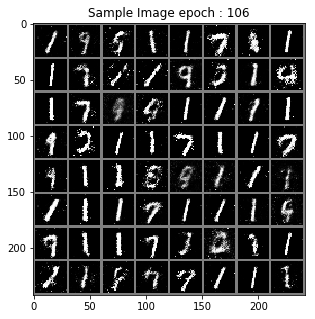

> Epoch : 108 Batch : 19 / 235 Loss_D : 0.5214844942092896 Loss_G : 2.615677833557129
> Epoch : 108 Batch : 39 / 235 Loss_D : 0.4623929560184479 Loss_G : 2.3794105052948
> Epoch : 108 Batch : 59 / 235 Loss_D : 0.543667197227478 Loss_G : 2.6708014011383057
> Epoch : 108 Batch : 79 / 235 Loss_D : 0.4808475971221924 Loss_G : 2.609424591064453
> Epoch : 108 Batch : 99 / 235 Loss_D : 0.4611584544181824 Loss_G : 2.7524473667144775
> Epoch : 108 Batch : 119 / 235 Loss_D : 0.5288315415382385 Loss_G : 2.428658962249756
> Epoch : 108 Batch : 139 / 235 Loss_D : 0.5411890745162964 Loss_G : 2.4383349418640137
> Epoch : 108 Batch : 159 / 235 Loss_D : 0.3730337619781494 Loss_G : 2.912950038909912
> Epoch : 108 Batch : 179 / 235 Loss_D : 0.6663946509361267 Loss_G : 2.1030330657958984
> Epoch : 108 Batch : 199 / 235 Loss_D : 0.41106653213500977 Loss_G : 3.1911392211914062
> Epoch : 108 Batch : 219 / 235 Loss_D : 0.6186190843582153 Loss_G : 3.800264835357666


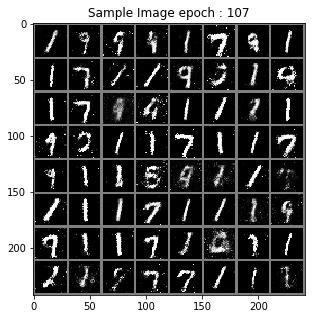

> Epoch : 109 Batch : 19 / 235 Loss_D : 0.5512319803237915 Loss_G : 2.521091938018799
> Epoch : 109 Batch : 39 / 235 Loss_D : 0.4708327353000641 Loss_G : 2.3938021659851074
> Epoch : 109 Batch : 59 / 235 Loss_D : 0.49510812759399414 Loss_G : 2.4438438415527344
> Epoch : 109 Batch : 79 / 235 Loss_D : 0.48529595136642456 Loss_G : 2.310798168182373
> Epoch : 109 Batch : 99 / 235 Loss_D : 0.49389657378196716 Loss_G : 2.5353972911834717
> Epoch : 109 Batch : 119 / 235 Loss_D : 0.4412248730659485 Loss_G : 2.8400936126708984
> Epoch : 109 Batch : 139 / 235 Loss_D : 0.617133378982544 Loss_G : 2.4611310958862305
> Epoch : 109 Batch : 159 / 235 Loss_D : 0.4793134331703186 Loss_G : 2.5773744583129883
> Epoch : 109 Batch : 179 / 235 Loss_D : 0.5089273452758789 Loss_G : 2.4305033683776855
> Epoch : 109 Batch : 199 / 235 Loss_D : 0.4133225083351135 Loss_G : 2.9915976524353027
> Epoch : 109 Batch : 219 / 235 Loss_D : 0.46853744983673096 Loss_G : 2.2959208488464355


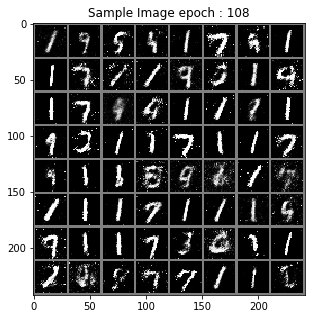

> Epoch : 110 Batch : 19 / 235 Loss_D : 0.4259719252586365 Loss_G : 3.232712745666504
> Epoch : 110 Batch : 39 / 235 Loss_D : 0.6998170018196106 Loss_G : 1.6888494491577148
> Epoch : 110 Batch : 59 / 235 Loss_D : 0.5308479070663452 Loss_G : 2.3761038780212402
> Epoch : 110 Batch : 79 / 235 Loss_D : 0.4786694347858429 Loss_G : 2.512716770172119
> Epoch : 110 Batch : 99 / 235 Loss_D : 0.6848166584968567 Loss_G : 2.133737325668335
> Epoch : 110 Batch : 119 / 235 Loss_D : 0.5223695635795593 Loss_G : 2.2518677711486816
> Epoch : 110 Batch : 139 / 235 Loss_D : 0.5198973417282104 Loss_G : 2.7699804306030273
> Epoch : 110 Batch : 159 / 235 Loss_D : 0.4286932945251465 Loss_G : 2.5036544799804688
> Epoch : 110 Batch : 179 / 235 Loss_D : 0.5492948293685913 Loss_G : 2.7938928604125977
> Epoch : 110 Batch : 199 / 235 Loss_D : 0.3109521269798279 Loss_G : 3.1413745880126953
> Epoch : 110 Batch : 219 / 235 Loss_D : 0.5090661644935608 Loss_G : 2.9052376747131348


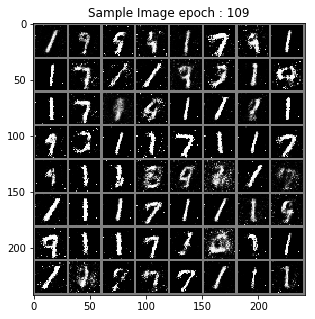

> Epoch : 111 Batch : 19 / 235 Loss_D : 0.3743229806423187 Loss_G : 3.486626386642456
> Epoch : 111 Batch : 39 / 235 Loss_D : 0.5753390192985535 Loss_G : 2.5020084381103516
> Epoch : 111 Batch : 59 / 235 Loss_D : 0.3921860456466675 Loss_G : 2.592080593109131
> Epoch : 111 Batch : 79 / 235 Loss_D : 0.6733013987541199 Loss_G : 2.262683391571045
> Epoch : 111 Batch : 99 / 235 Loss_D : 0.6123335957527161 Loss_G : 2.3990180492401123
> Epoch : 111 Batch : 119 / 235 Loss_D : 0.4719049036502838 Loss_G : 2.8062191009521484
> Epoch : 111 Batch : 139 / 235 Loss_D : 0.519540548324585 Loss_G : 2.8012161254882812
> Epoch : 111 Batch : 159 / 235 Loss_D : 0.5957618951797485 Loss_G : 1.9870473146438599
> Epoch : 111 Batch : 179 / 235 Loss_D : 0.4965630769729614 Loss_G : 3.1051673889160156
> Epoch : 111 Batch : 199 / 235 Loss_D : 0.48217514157295227 Loss_G : 2.3462071418762207
> Epoch : 111 Batch : 219 / 235 Loss_D : 0.5293653011322021 Loss_G : 1.6710021495819092


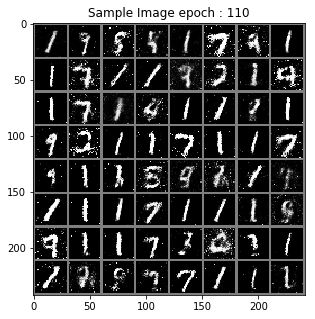

> Epoch : 112 Batch : 19 / 235 Loss_D : 0.5276662111282349 Loss_G : 2.5802712440490723
> Epoch : 112 Batch : 39 / 235 Loss_D : 0.48964923620224 Loss_G : 2.6179749965667725
> Epoch : 112 Batch : 59 / 235 Loss_D : 0.6240984201431274 Loss_G : 2.378782272338867
> Epoch : 112 Batch : 79 / 235 Loss_D : 0.5062968730926514 Loss_G : 2.5723469257354736
> Epoch : 112 Batch : 99 / 235 Loss_D : 0.5112195611000061 Loss_G : 2.153560161590576
> Epoch : 112 Batch : 119 / 235 Loss_D : 0.4769563674926758 Loss_G : 2.0045742988586426
> Epoch : 112 Batch : 139 / 235 Loss_D : 0.48098117113113403 Loss_G : 2.883498191833496
> Epoch : 112 Batch : 159 / 235 Loss_D : 0.5617848038673401 Loss_G : 2.2928037643432617
> Epoch : 112 Batch : 179 / 235 Loss_D : 0.43132519721984863 Loss_G : 2.503326177597046
> Epoch : 112 Batch : 199 / 235 Loss_D : 0.592086136341095 Loss_G : 2.365938901901245
> Epoch : 112 Batch : 219 / 235 Loss_D : 0.723300039768219 Loss_G : 1.9150278568267822


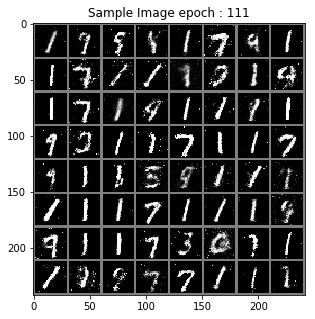

> Epoch : 113 Batch : 19 / 235 Loss_D : 0.5420836210250854 Loss_G : 2.399318218231201
> Epoch : 113 Batch : 39 / 235 Loss_D : 0.5663944482803345 Loss_G : 1.9632298946380615
> Epoch : 113 Batch : 59 / 235 Loss_D : 0.5203146934509277 Loss_G : 2.2356550693511963
> Epoch : 113 Batch : 79 / 235 Loss_D : 0.5412034392356873 Loss_G : 2.7319023609161377
> Epoch : 113 Batch : 99 / 235 Loss_D : 0.6085439324378967 Loss_G : 2.72660231590271
> Epoch : 113 Batch : 119 / 235 Loss_D : 0.6058328747749329 Loss_G : 2.4526920318603516
> Epoch : 113 Batch : 139 / 235 Loss_D : 0.5450326800346375 Loss_G : 2.761737108230591
> Epoch : 113 Batch : 159 / 235 Loss_D : 0.5202248096466064 Loss_G : 2.28472638130188
> Epoch : 113 Batch : 179 / 235 Loss_D : 0.5459797382354736 Loss_G : 2.458010673522949
> Epoch : 113 Batch : 199 / 235 Loss_D : 0.4888516068458557 Loss_G : 2.385819911956787
> Epoch : 113 Batch : 219 / 235 Loss_D : 0.5654090642929077 Loss_G : 2.398369789123535


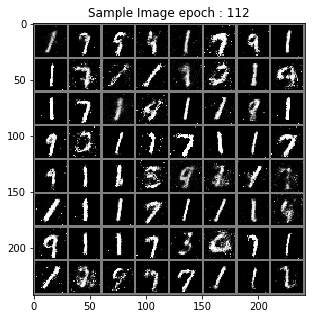

> Epoch : 114 Batch : 19 / 235 Loss_D : 0.47494158148765564 Loss_G : 2.299011468887329
> Epoch : 114 Batch : 39 / 235 Loss_D : 0.48882296681404114 Loss_G : 2.6389050483703613
> Epoch : 114 Batch : 59 / 235 Loss_D : 0.5392104387283325 Loss_G : 2.5278215408325195
> Epoch : 114 Batch : 79 / 235 Loss_D : 0.5757189393043518 Loss_G : 3.0244693756103516
> Epoch : 114 Batch : 99 / 235 Loss_D : 0.6248347759246826 Loss_G : 2.568812608718872
> Epoch : 114 Batch : 119 / 235 Loss_D : 0.5156235694885254 Loss_G : 2.7412729263305664
> Epoch : 114 Batch : 139 / 235 Loss_D : 0.5249974727630615 Loss_G : 2.7788336277008057
> Epoch : 114 Batch : 159 / 235 Loss_D : 0.5675028562545776 Loss_G : 2.6530258655548096
> Epoch : 114 Batch : 179 / 235 Loss_D : 0.5847665667533875 Loss_G : 2.9240994453430176
> Epoch : 114 Batch : 199 / 235 Loss_D : 0.5612406730651855 Loss_G : 2.5019803047180176
> Epoch : 114 Batch : 219 / 235 Loss_D : 0.598914384841919 Loss_G : 2.3861711025238037


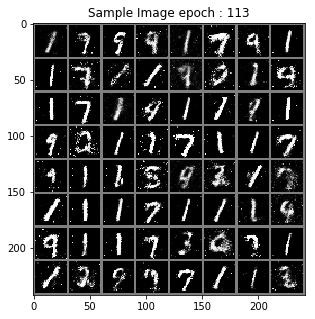

> Epoch : 115 Batch : 19 / 235 Loss_D : 0.40084266662597656 Loss_G : 2.1867499351501465
> Epoch : 115 Batch : 39 / 235 Loss_D : 0.6244174838066101 Loss_G : 2.4805235862731934
> Epoch : 115 Batch : 59 / 235 Loss_D : 0.5060579776763916 Loss_G : 2.318530797958374
> Epoch : 115 Batch : 79 / 235 Loss_D : 0.5315850973129272 Loss_G : 2.3386263847351074
> Epoch : 115 Batch : 99 / 235 Loss_D : 0.5866620540618896 Loss_G : 2.150078773498535
> Epoch : 115 Batch : 119 / 235 Loss_D : 0.48442572355270386 Loss_G : 2.3208327293395996
> Epoch : 115 Batch : 139 / 235 Loss_D : 0.6516849994659424 Loss_G : 2.5854668617248535
> Epoch : 115 Batch : 159 / 235 Loss_D : 0.5716278553009033 Loss_G : 2.5674328804016113
> Epoch : 115 Batch : 179 / 235 Loss_D : 0.43488770723342896 Loss_G : 3.7816355228424072
> Epoch : 115 Batch : 199 / 235 Loss_D : 0.5765918493270874 Loss_G : 1.744074821472168
> Epoch : 115 Batch : 219 / 235 Loss_D : 0.5794181823730469 Loss_G : 2.468968391418457


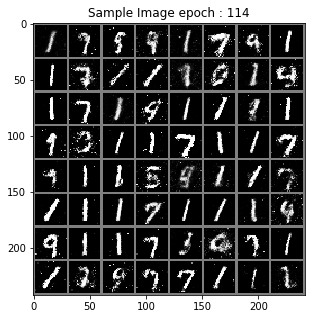

> Epoch : 116 Batch : 19 / 235 Loss_D : 0.5143517255783081 Loss_G : 2.5609960556030273
> Epoch : 116 Batch : 39 / 235 Loss_D : 0.5616458058357239 Loss_G : 2.585679531097412
> Epoch : 116 Batch : 59 / 235 Loss_D : 0.45312169194221497 Loss_G : 2.015925884246826
> Epoch : 116 Batch : 79 / 235 Loss_D : 0.5691763162612915 Loss_G : 2.61445951461792
> Epoch : 116 Batch : 99 / 235 Loss_D : 0.5429333448410034 Loss_G : 2.301679849624634
> Epoch : 116 Batch : 119 / 235 Loss_D : 0.4293637275695801 Loss_G : 2.433743953704834
> Epoch : 116 Batch : 139 / 235 Loss_D : 0.5103641748428345 Loss_G : 2.3037807941436768
> Epoch : 116 Batch : 159 / 235 Loss_D : 0.7138926982879639 Loss_G : 2.762450933456421
> Epoch : 116 Batch : 179 / 235 Loss_D : 0.6431282758712769 Loss_G : 2.4893078804016113
> Epoch : 116 Batch : 199 / 235 Loss_D : 0.44840461015701294 Loss_G : 2.2372727394104004
> Epoch : 116 Batch : 219 / 235 Loss_D : 0.548437237739563 Loss_G : 2.3259799480438232


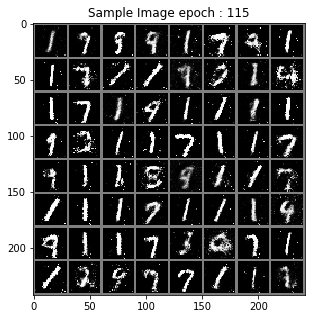

> Epoch : 117 Batch : 19 / 235 Loss_D : 0.5000213384628296 Loss_G : 2.269179105758667
> Epoch : 117 Batch : 39 / 235 Loss_D : 0.5248422026634216 Loss_G : 2.3584811687469482
> Epoch : 117 Batch : 59 / 235 Loss_D : 0.5709349513053894 Loss_G : 2.5737268924713135
> Epoch : 117 Batch : 79 / 235 Loss_D : 0.6691071391105652 Loss_G : 2.259410858154297
> Epoch : 117 Batch : 99 / 235 Loss_D : 0.5636590719223022 Loss_G : 2.6230292320251465
> Epoch : 117 Batch : 119 / 235 Loss_D : 0.6184655427932739 Loss_G : 2.5947203636169434
> Epoch : 117 Batch : 139 / 235 Loss_D : 0.5388470888137817 Loss_G : 2.7876017093658447
> Epoch : 117 Batch : 159 / 235 Loss_D : 0.5909221172332764 Loss_G : 2.6990890502929688
> Epoch : 117 Batch : 179 / 235 Loss_D : 0.5273040533065796 Loss_G : 2.4027631282806396
> Epoch : 117 Batch : 199 / 235 Loss_D : 0.5827492475509644 Loss_G : 2.31241512298584
> Epoch : 117 Batch : 219 / 235 Loss_D : 0.6093062162399292 Loss_G : 2.567807674407959


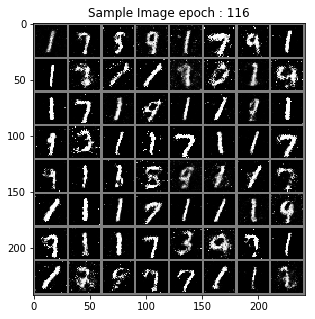

> Epoch : 118 Batch : 19 / 235 Loss_D : 0.5696710348129272 Loss_G : 2.2238168716430664
> Epoch : 118 Batch : 39 / 235 Loss_D : 0.6209850311279297 Loss_G : 2.724181890487671
> Epoch : 118 Batch : 59 / 235 Loss_D : 0.6086881160736084 Loss_G : 2.143740653991699
> Epoch : 118 Batch : 79 / 235 Loss_D : 0.6954218149185181 Loss_G : 2.9634876251220703
> Epoch : 118 Batch : 99 / 235 Loss_D : 0.6285163760185242 Loss_G : 2.5711824893951416
> Epoch : 118 Batch : 119 / 235 Loss_D : 0.5786772966384888 Loss_G : 2.5165181159973145
> Epoch : 118 Batch : 139 / 235 Loss_D : 0.7328493595123291 Loss_G : 2.2753260135650635
> Epoch : 118 Batch : 159 / 235 Loss_D : 0.4580129384994507 Loss_G : 2.8376801013946533
> Epoch : 118 Batch : 179 / 235 Loss_D : 0.6313292980194092 Loss_G : 2.2460756301879883
> Epoch : 118 Batch : 199 / 235 Loss_D : 0.6080296635627747 Loss_G : 2.7081315517425537
> Epoch : 118 Batch : 219 / 235 Loss_D : 0.5131468772888184 Loss_G : 2.4627466201782227


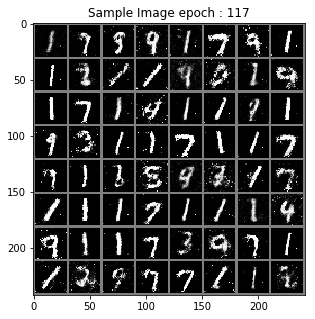

> Epoch : 119 Batch : 19 / 235 Loss_D : 0.5625609159469604 Loss_G : 2.6238744258880615
> Epoch : 119 Batch : 39 / 235 Loss_D : 0.6566289663314819 Loss_G : 2.0410170555114746
> Epoch : 119 Batch : 59 / 235 Loss_D : 0.5772009491920471 Loss_G : 2.346221685409546
> Epoch : 119 Batch : 79 / 235 Loss_D : 0.5230752825737 Loss_G : 3.142162799835205
> Epoch : 119 Batch : 99 / 235 Loss_D : 0.5732921361923218 Loss_G : 2.2786316871643066
> Epoch : 119 Batch : 119 / 235 Loss_D : 0.5731551051139832 Loss_G : 1.9643077850341797
> Epoch : 119 Batch : 139 / 235 Loss_D : 0.47293442487716675 Loss_G : 2.804083824157715
> Epoch : 119 Batch : 159 / 235 Loss_D : 0.612929105758667 Loss_G : 2.4323832988739014
> Epoch : 119 Batch : 179 / 235 Loss_D : 0.6468977332115173 Loss_G : 2.1898531913757324
> Epoch : 119 Batch : 199 / 235 Loss_D : 0.6371206045150757 Loss_G : 1.9057772159576416
> Epoch : 119 Batch : 219 / 235 Loss_D : 0.5241090059280396 Loss_G : 2.0757858753204346


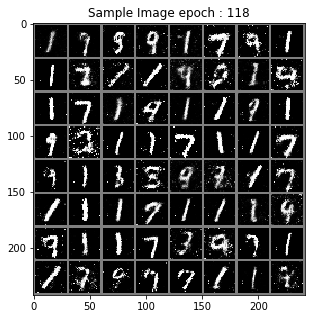

> Epoch : 120 Batch : 19 / 235 Loss_D : 0.5569331049919128 Loss_G : 2.809603214263916
> Epoch : 120 Batch : 39 / 235 Loss_D : 0.655504584312439 Loss_G : 2.3545069694519043
> Epoch : 120 Batch : 59 / 235 Loss_D : 0.43312790989875793 Loss_G : 2.726438045501709
> Epoch : 120 Batch : 79 / 235 Loss_D : 0.5591681003570557 Loss_G : 2.265071392059326
> Epoch : 120 Batch : 99 / 235 Loss_D : 0.588582456111908 Loss_G : 2.301137924194336
> Epoch : 120 Batch : 119 / 235 Loss_D : 0.5283066034317017 Loss_G : 2.425762176513672
> Epoch : 120 Batch : 139 / 235 Loss_D : 0.49244415760040283 Loss_G : 2.181734323501587
> Epoch : 120 Batch : 159 / 235 Loss_D : 0.6684191226959229 Loss_G : 1.7049047946929932
> Epoch : 120 Batch : 179 / 235 Loss_D : 0.6882559061050415 Loss_G : 2.375530958175659
> Epoch : 120 Batch : 199 / 235 Loss_D : 0.6196843385696411 Loss_G : 2.2287306785583496
> Epoch : 120 Batch : 219 / 235 Loss_D : 0.6272065043449402 Loss_G : 1.7918869256973267


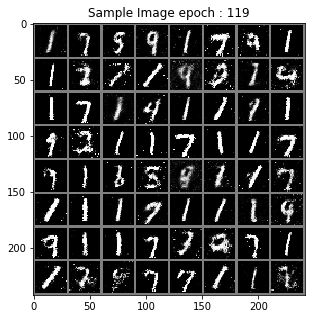

> Epoch : 121 Batch : 19 / 235 Loss_D : 0.6912654638290405 Loss_G : 2.812289237976074
> Epoch : 121 Batch : 39 / 235 Loss_D : 0.4534001350402832 Loss_G : 2.4326157569885254
> Epoch : 121 Batch : 59 / 235 Loss_D : 0.5099788904190063 Loss_G : 2.401688575744629
> Epoch : 121 Batch : 79 / 235 Loss_D : 0.776945948600769 Loss_G : 1.9387601613998413
> Epoch : 121 Batch : 99 / 235 Loss_D : 0.5381176471710205 Loss_G : 2.599400520324707
> Epoch : 121 Batch : 119 / 235 Loss_D : 0.5409497618675232 Loss_G : 2.7386956214904785
> Epoch : 121 Batch : 139 / 235 Loss_D : 0.5075467824935913 Loss_G : 2.0936124324798584
> Epoch : 121 Batch : 159 / 235 Loss_D : 0.4782795310020447 Loss_G : 2.1624417304992676
> Epoch : 121 Batch : 179 / 235 Loss_D : 0.501251220703125 Loss_G : 2.312398672103882
> Epoch : 121 Batch : 199 / 235 Loss_D : 0.49001410603523254 Loss_G : 2.0407886505126953
> Epoch : 121 Batch : 219 / 235 Loss_D : 0.6455958485603333 Loss_G : 2.0206243991851807


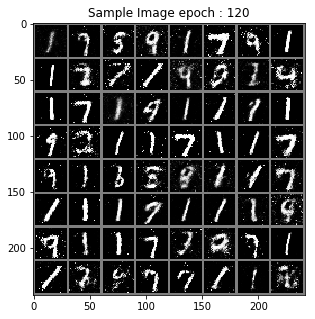

> Epoch : 122 Batch : 19 / 235 Loss_D : 0.7840785980224609 Loss_G : 2.1167635917663574
> Epoch : 122 Batch : 39 / 235 Loss_D : 0.561493992805481 Loss_G : 2.22928524017334
> Epoch : 122 Batch : 59 / 235 Loss_D : 0.6014015078544617 Loss_G : 2.6443893909454346
> Epoch : 122 Batch : 79 / 235 Loss_D : 0.5594997406005859 Loss_G : 2.1614856719970703
> Epoch : 122 Batch : 99 / 235 Loss_D : 0.48636558651924133 Loss_G : 3.21481990814209
> Epoch : 122 Batch : 119 / 235 Loss_D : 0.6190954446792603 Loss_G : 2.0348191261291504
> Epoch : 122 Batch : 139 / 235 Loss_D : 0.6656147837638855 Loss_G : 1.9070676565170288
> Epoch : 122 Batch : 159 / 235 Loss_D : 0.5547149181365967 Loss_G : 2.3632850646972656
> Epoch : 122 Batch : 179 / 235 Loss_D : 0.5661699175834656 Loss_G : 2.2335662841796875
> Epoch : 122 Batch : 199 / 235 Loss_D : 0.6259407997131348 Loss_G : 2.1558356285095215
> Epoch : 122 Batch : 219 / 235 Loss_D : 0.6008322238922119 Loss_G : 2.4320788383483887


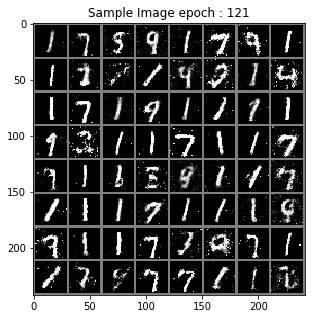

> Epoch : 123 Batch : 19 / 235 Loss_D : 0.6542385816574097 Loss_G : 2.30367374420166
> Epoch : 123 Batch : 39 / 235 Loss_D : 0.6400153040885925 Loss_G : 2.2625508308410645
> Epoch : 123 Batch : 59 / 235 Loss_D : 0.5814635157585144 Loss_G : 2.19777512550354
> Epoch : 123 Batch : 79 / 235 Loss_D : 0.5884717702865601 Loss_G : 2.1312952041625977
> Epoch : 123 Batch : 99 / 235 Loss_D : 0.5620297789573669 Loss_G : 2.8412580490112305
> Epoch : 123 Batch : 119 / 235 Loss_D : 0.6915715932846069 Loss_G : 1.8867998123168945
> Epoch : 123 Batch : 139 / 235 Loss_D : 0.5298952460289001 Loss_G : 2.587083339691162
> Epoch : 123 Batch : 159 / 235 Loss_D : 0.6505608558654785 Loss_G : 2.5535993576049805
> Epoch : 123 Batch : 179 / 235 Loss_D : 0.5966607332229614 Loss_G : 1.8410205841064453
> Epoch : 123 Batch : 199 / 235 Loss_D : 0.5800418853759766 Loss_G : 2.8133606910705566
> Epoch : 123 Batch : 219 / 235 Loss_D : 0.5544992685317993 Loss_G : 2.225104331970215


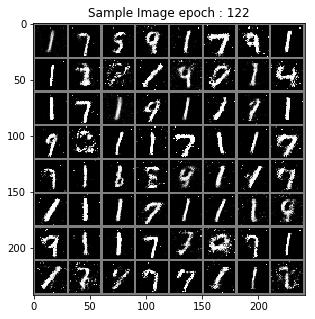

> Epoch : 124 Batch : 19 / 235 Loss_D : 0.670066237449646 Loss_G : 2.0124282836914062
> Epoch : 124 Batch : 39 / 235 Loss_D : 0.6043425798416138 Loss_G : 1.9453684091567993
> Epoch : 124 Batch : 59 / 235 Loss_D : 0.5930929183959961 Loss_G : 2.134972333908081
> Epoch : 124 Batch : 79 / 235 Loss_D : 0.5105284452438354 Loss_G : 2.6957550048828125
> Epoch : 124 Batch : 99 / 235 Loss_D : 0.7060427665710449 Loss_G : 2.2852566242218018
> Epoch : 124 Batch : 119 / 235 Loss_D : 0.5713132619857788 Loss_G : 2.094491958618164
> Epoch : 124 Batch : 139 / 235 Loss_D : 0.5745983123779297 Loss_G : 2.4255363941192627
> Epoch : 124 Batch : 159 / 235 Loss_D : 0.6499943137168884 Loss_G : 1.9898152351379395
> Epoch : 124 Batch : 179 / 235 Loss_D : 0.5410573482513428 Loss_G : 2.0430431365966797
> Epoch : 124 Batch : 199 / 235 Loss_D : 0.5474938154220581 Loss_G : 1.9269860982894897
> Epoch : 124 Batch : 219 / 235 Loss_D : 0.5226457118988037 Loss_G : 2.2258551120758057


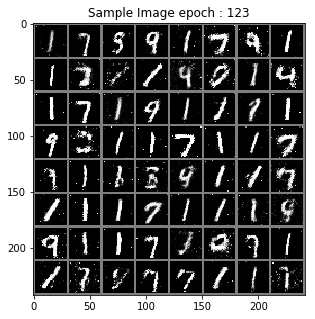

> Epoch : 125 Batch : 19 / 235 Loss_D : 0.6119158864021301 Loss_G : 2.183495044708252
> Epoch : 125 Batch : 39 / 235 Loss_D : 0.5653285384178162 Loss_G : 2.666154623031616
> Epoch : 125 Batch : 59 / 235 Loss_D : 0.664446234703064 Loss_G : 2.10941219329834
> Epoch : 125 Batch : 79 / 235 Loss_D : 0.6957238912582397 Loss_G : 2.2962896823883057
> Epoch : 125 Batch : 99 / 235 Loss_D : 0.5455837249755859 Loss_G : 2.156895160675049
> Epoch : 125 Batch : 119 / 235 Loss_D : 0.5396023988723755 Loss_G : 2.646103858947754
> Epoch : 125 Batch : 139 / 235 Loss_D : 0.5257381796836853 Loss_G : 2.2706005573272705
> Epoch : 125 Batch : 159 / 235 Loss_D : 0.6761987209320068 Loss_G : 2.3758716583251953
> Epoch : 125 Batch : 179 / 235 Loss_D : 0.6457196474075317 Loss_G : 2.063382148742676
> Epoch : 125 Batch : 199 / 235 Loss_D : 0.5464832186698914 Loss_G : 2.18564510345459
> Epoch : 125 Batch : 219 / 235 Loss_D : 0.5577992796897888 Loss_G : 2.5505733489990234


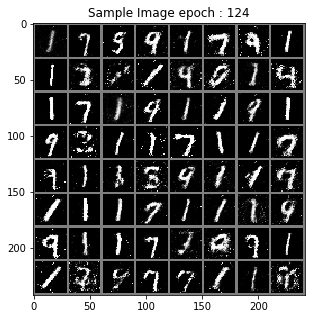

> Epoch : 126 Batch : 19 / 235 Loss_D : 0.5940233469009399 Loss_G : 2.455350160598755
> Epoch : 126 Batch : 39 / 235 Loss_D : 0.5568798184394836 Loss_G : 2.277439832687378
> Epoch : 126 Batch : 59 / 235 Loss_D : 0.6198669075965881 Loss_G : 2.2321619987487793
> Epoch : 126 Batch : 79 / 235 Loss_D : 0.5540404915809631 Loss_G : 2.2504329681396484
> Epoch : 126 Batch : 99 / 235 Loss_D : 0.6877131462097168 Loss_G : 2.3693013191223145
> Epoch : 126 Batch : 119 / 235 Loss_D : 0.624093770980835 Loss_G : 2.4390645027160645
> Epoch : 126 Batch : 139 / 235 Loss_D : 0.6459548473358154 Loss_G : 2.3799002170562744
> Epoch : 126 Batch : 159 / 235 Loss_D : 0.5160626769065857 Loss_G : 2.3030052185058594
> Epoch : 126 Batch : 179 / 235 Loss_D : 0.5821359157562256 Loss_G : 2.6272549629211426
> Epoch : 126 Batch : 199 / 235 Loss_D : 0.5871086120605469 Loss_G : 2.104612112045288
> Epoch : 126 Batch : 219 / 235 Loss_D : 0.48342615365982056 Loss_G : 2.4576833248138428


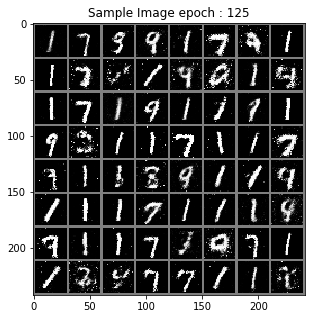

> Epoch : 127 Batch : 19 / 235 Loss_D : 0.5093429088592529 Loss_G : 2.6461386680603027
> Epoch : 127 Batch : 39 / 235 Loss_D : 0.6090174317359924 Loss_G : 2.3962655067443848
> Epoch : 127 Batch : 59 / 235 Loss_D : 0.6213268041610718 Loss_G : 1.8220133781433105
> Epoch : 127 Batch : 79 / 235 Loss_D : 0.6544357538223267 Loss_G : 2.0288400650024414
> Epoch : 127 Batch : 99 / 235 Loss_D : 0.5053308010101318 Loss_G : 2.34621000289917
> Epoch : 127 Batch : 119 / 235 Loss_D : 0.5710355043411255 Loss_G : 2.216365337371826
> Epoch : 127 Batch : 139 / 235 Loss_D : 0.4706369936466217 Loss_G : 2.2294769287109375
> Epoch : 127 Batch : 159 / 235 Loss_D : 0.5441807508468628 Loss_G : 2.168323516845703
> Epoch : 127 Batch : 179 / 235 Loss_D : 0.4938051402568817 Loss_G : 2.568239212036133
> Epoch : 127 Batch : 199 / 235 Loss_D : 0.6115099191665649 Loss_G : 2.691649913787842
> Epoch : 127 Batch : 219 / 235 Loss_D : 0.49469491839408875 Loss_G : 2.352426052093506


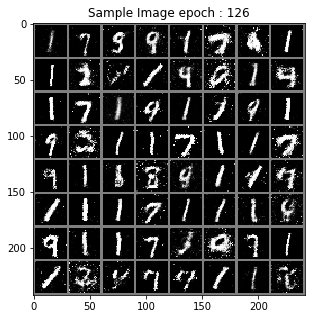

> Epoch : 128 Batch : 19 / 235 Loss_D : 0.6879239082336426 Loss_G : 2.4341530799865723
> Epoch : 128 Batch : 39 / 235 Loss_D : 0.5783547163009644 Loss_G : 2.7293922901153564
> Epoch : 128 Batch : 59 / 235 Loss_D : 0.6430134773254395 Loss_G : 1.9479261636734009
> Epoch : 128 Batch : 79 / 235 Loss_D : 0.5586140155792236 Loss_G : 2.293928861618042
> Epoch : 128 Batch : 99 / 235 Loss_D : 0.5128803849220276 Loss_G : 2.8230934143066406
> Epoch : 128 Batch : 119 / 235 Loss_D : 0.6955586671829224 Loss_G : 2.0255770683288574
> Epoch : 128 Batch : 139 / 235 Loss_D : 0.6102887392044067 Loss_G : 2.130558490753174
> Epoch : 128 Batch : 159 / 235 Loss_D : 0.5507398843765259 Loss_G : 2.634305477142334
> Epoch : 128 Batch : 179 / 235 Loss_D : 0.6040371656417847 Loss_G : 2.1638925075531006
> Epoch : 128 Batch : 199 / 235 Loss_D : 0.6152666807174683 Loss_G : 1.675525188446045
> Epoch : 128 Batch : 219 / 235 Loss_D : 0.5648528337478638 Loss_G : 2.4535770416259766


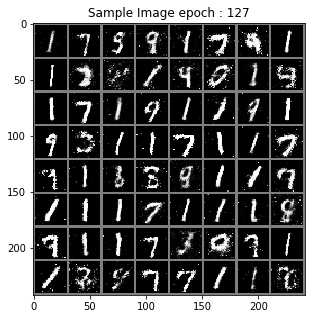

> Epoch : 129 Batch : 19 / 235 Loss_D : 0.5807784795761108 Loss_G : 2.3562231063842773
> Epoch : 129 Batch : 39 / 235 Loss_D : 0.5358765125274658 Loss_G : 2.308422088623047
> Epoch : 129 Batch : 59 / 235 Loss_D : 0.7234244346618652 Loss_G : 2.403829574584961
> Epoch : 129 Batch : 79 / 235 Loss_D : 0.6411340236663818 Loss_G : 2.083040237426758
> Epoch : 129 Batch : 99 / 235 Loss_D : 0.5853096842765808 Loss_G : 2.6794276237487793
> Epoch : 129 Batch : 119 / 235 Loss_D : 0.6274025440216064 Loss_G : 2.228762149810791
> Epoch : 129 Batch : 139 / 235 Loss_D : 0.5802780985832214 Loss_G : 1.9432200193405151
> Epoch : 129 Batch : 159 / 235 Loss_D : 0.6254892945289612 Loss_G : 2.019418716430664
> Epoch : 129 Batch : 179 / 235 Loss_D : 0.5255610346794128 Loss_G : 2.166557788848877
> Epoch : 129 Batch : 199 / 235 Loss_D : 0.5676214098930359 Loss_G : 2.4578495025634766
> Epoch : 129 Batch : 219 / 235 Loss_D : 0.6120713353157043 Loss_G : 2.0621118545532227


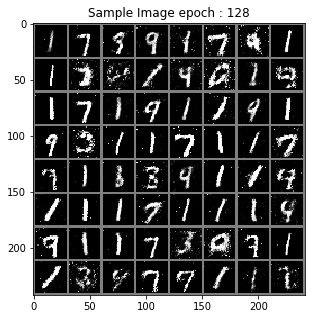

> Epoch : 130 Batch : 19 / 235 Loss_D : 0.5739691853523254 Loss_G : 2.2701704502105713
> Epoch : 130 Batch : 39 / 235 Loss_D : 0.5631458163261414 Loss_G : 2.6120777130126953
> Epoch : 130 Batch : 59 / 235 Loss_D : 0.6559038162231445 Loss_G : 1.8416451215744019
> Epoch : 130 Batch : 79 / 235 Loss_D : 0.7087582349777222 Loss_G : 2.030099630355835
> Epoch : 130 Batch : 99 / 235 Loss_D : 0.5696182250976562 Loss_G : 1.9081990718841553
> Epoch : 130 Batch : 119 / 235 Loss_D : 0.5841317176818848 Loss_G : 2.1268553733825684
> Epoch : 130 Batch : 139 / 235 Loss_D : 0.70169597864151 Loss_G : 2.4174644947052
> Epoch : 130 Batch : 159 / 235 Loss_D : 0.682746171951294 Loss_G : 1.8205935955047607
> Epoch : 130 Batch : 179 / 235 Loss_D : 0.715889573097229 Loss_G : 2.3048417568206787
> Epoch : 130 Batch : 199 / 235 Loss_D : 0.6212490797042847 Loss_G : 2.3139936923980713
> Epoch : 130 Batch : 219 / 235 Loss_D : 0.5206827521324158 Loss_G : 2.0915212631225586


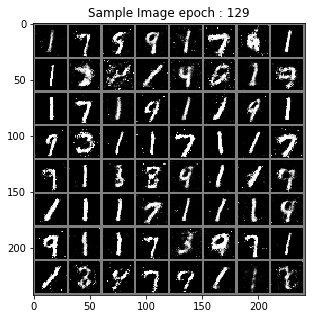

> Epoch : 131 Batch : 19 / 235 Loss_D : 0.7130510807037354 Loss_G : 2.061514377593994
> Epoch : 131 Batch : 39 / 235 Loss_D : 0.6439882516860962 Loss_G : 2.4038681983947754
> Epoch : 131 Batch : 59 / 235 Loss_D : 0.49840620160102844 Loss_G : 2.5837297439575195
> Epoch : 131 Batch : 79 / 235 Loss_D : 0.5776059627532959 Loss_G : 2.517258644104004
> Epoch : 131 Batch : 99 / 235 Loss_D : 0.5056384205818176 Loss_G : 2.2923600673675537
> Epoch : 131 Batch : 119 / 235 Loss_D : 0.5233282446861267 Loss_G : 2.391354560852051
> Epoch : 131 Batch : 139 / 235 Loss_D : 0.7122839689254761 Loss_G : 1.8016531467437744
> Epoch : 131 Batch : 159 / 235 Loss_D : 0.5971859693527222 Loss_G : 2.179551124572754
> Epoch : 131 Batch : 179 / 235 Loss_D : 0.5361200571060181 Loss_G : 2.2712368965148926
> Epoch : 131 Batch : 199 / 235 Loss_D : 0.5282208323478699 Loss_G : 2.417778491973877
> Epoch : 131 Batch : 219 / 235 Loss_D : 0.8107004165649414 Loss_G : 2.6381173133850098


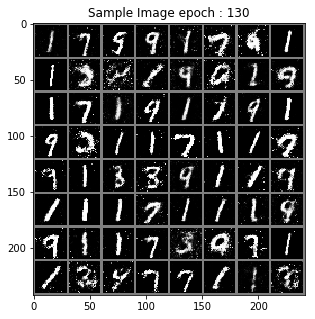

> Epoch : 132 Batch : 19 / 235 Loss_D : 0.5735236406326294 Loss_G : 2.5383739471435547
> Epoch : 132 Batch : 39 / 235 Loss_D : 0.5944326519966125 Loss_G : 2.2047948837280273
> Epoch : 132 Batch : 59 / 235 Loss_D : 0.678388237953186 Loss_G : 2.1540443897247314
> Epoch : 132 Batch : 79 / 235 Loss_D : 0.5838410258293152 Loss_G : 2.619515895843506
> Epoch : 132 Batch : 99 / 235 Loss_D : 0.5725176334381104 Loss_G : 2.10490345954895
> Epoch : 132 Batch : 119 / 235 Loss_D : 0.6843804717063904 Loss_G : 2.313025951385498
> Epoch : 132 Batch : 139 / 235 Loss_D : 0.6159793138504028 Loss_G : 1.9339470863342285
> Epoch : 132 Batch : 159 / 235 Loss_D : 0.6491014957427979 Loss_G : 2.4427926540374756
> Epoch : 132 Batch : 179 / 235 Loss_D : 0.621426522731781 Loss_G : 2.0881240367889404
> Epoch : 132 Batch : 199 / 235 Loss_D : 0.5740042328834534 Loss_G : 2.1425135135650635
> Epoch : 132 Batch : 219 / 235 Loss_D : 0.7421992421150208 Loss_G : 1.9612526893615723


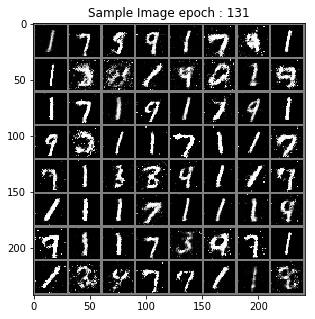

> Epoch : 133 Batch : 19 / 235 Loss_D : 0.5696195960044861 Loss_G : 2.0886261463165283
> Epoch : 133 Batch : 39 / 235 Loss_D : 0.5696078538894653 Loss_G : 2.410447359085083
> Epoch : 133 Batch : 59 / 235 Loss_D : 0.6399476528167725 Loss_G : 2.223853349685669
> Epoch : 133 Batch : 79 / 235 Loss_D : 0.7573646903038025 Loss_G : 2.191761016845703
> Epoch : 133 Batch : 99 / 235 Loss_D : 0.5841076970100403 Loss_G : 2.222914695739746
> Epoch : 133 Batch : 119 / 235 Loss_D : 0.6434267163276672 Loss_G : 2.1540448665618896
> Epoch : 133 Batch : 139 / 235 Loss_D : 0.665229082107544 Loss_G : 2.0121421813964844
> Epoch : 133 Batch : 159 / 235 Loss_D : 0.5984599590301514 Loss_G : 2.1563916206359863
> Epoch : 133 Batch : 179 / 235 Loss_D : 0.6799691915512085 Loss_G : 2.253509521484375
> Epoch : 133 Batch : 199 / 235 Loss_D : 0.6954951286315918 Loss_G : 2.2842562198638916
> Epoch : 133 Batch : 219 / 235 Loss_D : 0.611832857131958 Loss_G : 2.4953651428222656


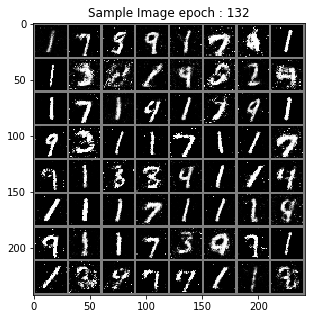

> Epoch : 134 Batch : 19 / 235 Loss_D : 0.605076253414154 Loss_G : 2.297452688217163
> Epoch : 134 Batch : 39 / 235 Loss_D : 0.5605090856552124 Loss_G : 2.403268814086914
> Epoch : 134 Batch : 59 / 235 Loss_D : 0.5556248426437378 Loss_G : 2.4923529624938965
> Epoch : 134 Batch : 79 / 235 Loss_D : 0.6791378855705261 Loss_G : 2.2695152759552
> Epoch : 134 Batch : 99 / 235 Loss_D : 0.6703914999961853 Loss_G : 2.0259175300598145
> Epoch : 134 Batch : 119 / 235 Loss_D : 0.5794376730918884 Loss_G : 1.9435395002365112
> Epoch : 134 Batch : 139 / 235 Loss_D : 0.6155404448509216 Loss_G : 1.9870890378952026
> Epoch : 134 Batch : 159 / 235 Loss_D : 0.7097089886665344 Loss_G : 1.8725230693817139
> Epoch : 134 Batch : 179 / 235 Loss_D : 0.6201543211936951 Loss_G : 2.1626040935516357
> Epoch : 134 Batch : 199 / 235 Loss_D : 0.6609804034233093 Loss_G : 2.0478897094726562
> Epoch : 134 Batch : 219 / 235 Loss_D : 0.6678588390350342 Loss_G : 1.9657553434371948


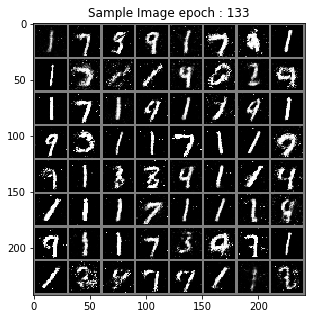

> Epoch : 135 Batch : 19 / 235 Loss_D : 0.6958525776863098 Loss_G : 2.191098213195801
> Epoch : 135 Batch : 39 / 235 Loss_D : 0.6176352500915527 Loss_G : 2.185770034790039
> Epoch : 135 Batch : 59 / 235 Loss_D : 0.5603470802307129 Loss_G : 2.1030333042144775
> Epoch : 135 Batch : 79 / 235 Loss_D : 0.7398166060447693 Loss_G : 2.1125917434692383
> Epoch : 135 Batch : 99 / 235 Loss_D : 0.5817176103591919 Loss_G : 2.361781597137451
> Epoch : 135 Batch : 119 / 235 Loss_D : 0.590990424156189 Loss_G : 2.313141345977783
> Epoch : 135 Batch : 139 / 235 Loss_D : 0.5592831969261169 Loss_G : 2.1458115577697754
> Epoch : 135 Batch : 159 / 235 Loss_D : 0.6576525568962097 Loss_G : 2.5189623832702637
> Epoch : 135 Batch : 179 / 235 Loss_D : 0.5242501497268677 Loss_G : 2.663379192352295
> Epoch : 135 Batch : 199 / 235 Loss_D : 0.6344078779220581 Loss_G : 2.0530052185058594
> Epoch : 135 Batch : 219 / 235 Loss_D : 0.7228916883468628 Loss_G : 2.5174245834350586


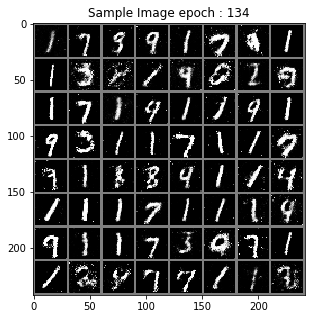

> Epoch : 136 Batch : 19 / 235 Loss_D : 0.5111161470413208 Loss_G : 2.4185523986816406
> Epoch : 136 Batch : 39 / 235 Loss_D : 0.7053207755088806 Loss_G : 2.0606255531311035
> Epoch : 136 Batch : 59 / 235 Loss_D : 0.6016262769699097 Loss_G : 2.2048346996307373
> Epoch : 136 Batch : 79 / 235 Loss_D : 0.5528116822242737 Loss_G : 2.152500629425049
> Epoch : 136 Batch : 99 / 235 Loss_D : 0.6341779828071594 Loss_G : 2.3691985607147217
> Epoch : 136 Batch : 119 / 235 Loss_D : 0.643386721611023 Loss_G : 2.2910263538360596
> Epoch : 136 Batch : 139 / 235 Loss_D : 0.7393958568572998 Loss_G : 1.9819726943969727
> Epoch : 136 Batch : 159 / 235 Loss_D : 0.5131697058677673 Loss_G : 2.2401068210601807
> Epoch : 136 Batch : 179 / 235 Loss_D : 0.6674026846885681 Loss_G : 2.074523687362671
> Epoch : 136 Batch : 199 / 235 Loss_D : 0.6820274591445923 Loss_G : 2.3746652603149414
> Epoch : 136 Batch : 219 / 235 Loss_D : 0.5918292999267578 Loss_G : 2.024538040161133


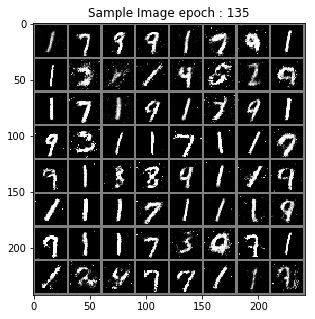

> Epoch : 137 Batch : 19 / 235 Loss_D : 0.7174481749534607 Loss_G : 1.888913869857788
> Epoch : 137 Batch : 39 / 235 Loss_D : 0.6324780583381653 Loss_G : 2.2458276748657227
> Epoch : 137 Batch : 59 / 235 Loss_D : 0.5659918785095215 Loss_G : 2.3440089225769043
> Epoch : 137 Batch : 79 / 235 Loss_D : 0.6797826886177063 Loss_G : 1.9933209419250488
> Epoch : 137 Batch : 99 / 235 Loss_D : 0.5604938268661499 Loss_G : 2.0562798976898193
> Epoch : 137 Batch : 119 / 235 Loss_D : 0.6296557188034058 Loss_G : 1.825481653213501
> Epoch : 137 Batch : 139 / 235 Loss_D : 0.6574814319610596 Loss_G : 1.799364447593689
> Epoch : 137 Batch : 159 / 235 Loss_D : 0.5048446655273438 Loss_G : 2.510586738586426
> Epoch : 137 Batch : 179 / 235 Loss_D : 0.7024688720703125 Loss_G : 2.4736194610595703
> Epoch : 137 Batch : 199 / 235 Loss_D : 0.6066927909851074 Loss_G : 2.22554349899292
> Epoch : 137 Batch : 219 / 235 Loss_D : 0.7402293682098389 Loss_G : 2.259524345397949


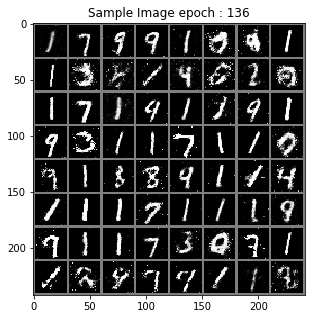

> Epoch : 138 Batch : 19 / 235 Loss_D : 0.5816884636878967 Loss_G : 2.1644468307495117
> Epoch : 138 Batch : 39 / 235 Loss_D : 0.5509792566299438 Loss_G : 1.9117152690887451
> Epoch : 138 Batch : 59 / 235 Loss_D : 0.5264178514480591 Loss_G : 2.221031665802002
> Epoch : 138 Batch : 79 / 235 Loss_D : 0.7090110182762146 Loss_G : 1.8138562440872192
> Epoch : 138 Batch : 99 / 235 Loss_D : 0.50777268409729 Loss_G : 2.06508731842041
> Epoch : 138 Batch : 119 / 235 Loss_D : 0.6501024961471558 Loss_G : 1.7511234283447266
> Epoch : 138 Batch : 139 / 235 Loss_D : 0.6749657392501831 Loss_G : 2.545125722885132
> Epoch : 138 Batch : 159 / 235 Loss_D : 0.5684802532196045 Loss_G : 2.443779230117798
> Epoch : 138 Batch : 179 / 235 Loss_D : 0.5892469882965088 Loss_G : 2.128176212310791
> Epoch : 138 Batch : 199 / 235 Loss_D : 0.7414613962173462 Loss_G : 2.0271782875061035
> Epoch : 138 Batch : 219 / 235 Loss_D : 0.7876229286193848 Loss_G : 1.9331843852996826


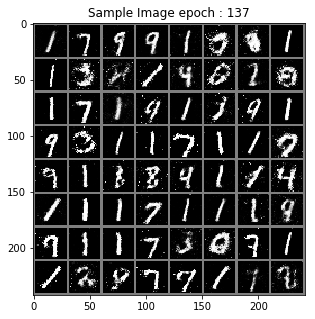

> Epoch : 139 Batch : 19 / 235 Loss_D : 0.6527053117752075 Loss_G : 2.1163766384124756
> Epoch : 139 Batch : 39 / 235 Loss_D : 0.6380680799484253 Loss_G : 1.9846185445785522
> Epoch : 139 Batch : 59 / 235 Loss_D : 0.6011177897453308 Loss_G : 2.4427201747894287
> Epoch : 139 Batch : 79 / 235 Loss_D : 0.5846482515335083 Loss_G : 2.396955728530884
> Epoch : 139 Batch : 99 / 235 Loss_D : 0.6313834190368652 Loss_G : 1.8934729099273682
> Epoch : 139 Batch : 119 / 235 Loss_D : 0.7014155983924866 Loss_G : 2.075401782989502
> Epoch : 139 Batch : 139 / 235 Loss_D : 0.5578279495239258 Loss_G : 2.440013885498047
> Epoch : 139 Batch : 159 / 235 Loss_D : 0.8036397695541382 Loss_G : 1.9357019662857056
> Epoch : 139 Batch : 179 / 235 Loss_D : 0.5855758786201477 Loss_G : 1.9831030368804932
> Epoch : 139 Batch : 199 / 235 Loss_D : 0.5729212164878845 Loss_G : 2.3035173416137695
> Epoch : 139 Batch : 219 / 235 Loss_D : 0.9965425729751587 Loss_G : 1.6337215900421143


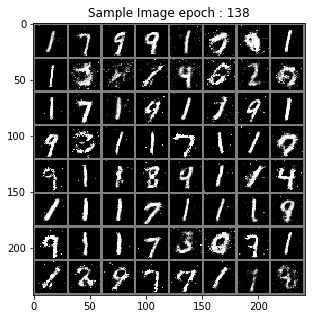

> Epoch : 140 Batch : 19 / 235 Loss_D : 0.6291630268096924 Loss_G : 2.103484630584717
> Epoch : 140 Batch : 39 / 235 Loss_D : 0.8357627391815186 Loss_G : 1.661712884902954
> Epoch : 140 Batch : 59 / 235 Loss_D : 0.7133135795593262 Loss_G : 2.000133752822876
> Epoch : 140 Batch : 79 / 235 Loss_D : 0.8142657279968262 Loss_G : 1.766709327697754
> Epoch : 140 Batch : 99 / 235 Loss_D : 0.5085251331329346 Loss_G : 2.240435838699341
> Epoch : 140 Batch : 119 / 235 Loss_D : 0.5964982509613037 Loss_G : 1.9654514789581299
> Epoch : 140 Batch : 139 / 235 Loss_D : 0.6570119261741638 Loss_G : 1.9963303804397583
> Epoch : 140 Batch : 159 / 235 Loss_D : 0.7082021236419678 Loss_G : 1.9976067543029785
> Epoch : 140 Batch : 179 / 235 Loss_D : 0.6142652034759521 Loss_G : 2.241118907928467
> Epoch : 140 Batch : 199 / 235 Loss_D : 0.5693565607070923 Loss_G : 2.643524169921875
> Epoch : 140 Batch : 219 / 235 Loss_D : 0.7906442880630493 Loss_G : 1.932917833328247


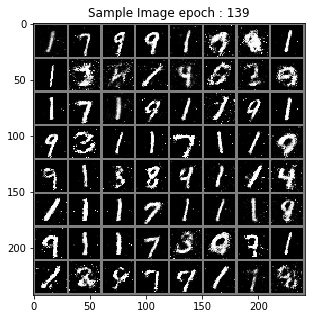

> Epoch : 141 Batch : 19 / 235 Loss_D : 0.5296453237533569 Loss_G : 2.8405447006225586
> Epoch : 141 Batch : 39 / 235 Loss_D : 0.7086950540542603 Loss_G : 2.655122995376587
> Epoch : 141 Batch : 59 / 235 Loss_D : 0.6503175497055054 Loss_G : 2.4548397064208984
> Epoch : 141 Batch : 79 / 235 Loss_D : 0.576653778553009 Loss_G : 2.2417564392089844
> Epoch : 141 Batch : 99 / 235 Loss_D : 0.6732783913612366 Loss_G : 1.8804850578308105
> Epoch : 141 Batch : 119 / 235 Loss_D : 0.628287136554718 Loss_G : 1.9018197059631348
> Epoch : 141 Batch : 139 / 235 Loss_D : 0.6046782732009888 Loss_G : 1.8762154579162598
> Epoch : 141 Batch : 159 / 235 Loss_D : 0.6258583068847656 Loss_G : 2.180295944213867
> Epoch : 141 Batch : 179 / 235 Loss_D : 0.5501325130462646 Loss_G : 2.4669110774993896
> Epoch : 141 Batch : 199 / 235 Loss_D : 0.6392011642456055 Loss_G : 1.9103572368621826
> Epoch : 141 Batch : 219 / 235 Loss_D : 0.6566678881645203 Loss_G : 1.978305697441101


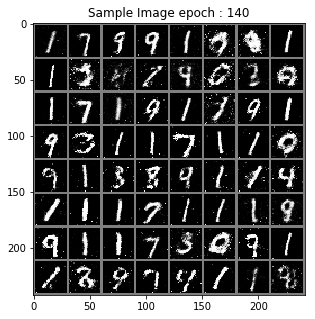

> Epoch : 142 Batch : 19 / 235 Loss_D : 0.5701451301574707 Loss_G : 2.674126148223877
> Epoch : 142 Batch : 39 / 235 Loss_D : 0.6624726057052612 Loss_G : 2.2297821044921875
> Epoch : 142 Batch : 59 / 235 Loss_D : 0.6900621056556702 Loss_G : 1.5756943225860596
> Epoch : 142 Batch : 79 / 235 Loss_D : 0.7378231287002563 Loss_G : 1.6103129386901855
> Epoch : 142 Batch : 99 / 235 Loss_D : 0.6293152570724487 Loss_G : 2.079265594482422
> Epoch : 142 Batch : 119 / 235 Loss_D : 0.6633141040802002 Loss_G : 1.969770073890686
> Epoch : 142 Batch : 139 / 235 Loss_D : 0.6967517733573914 Loss_G : 1.868742823600769
> Epoch : 142 Batch : 159 / 235 Loss_D : 0.7612543106079102 Loss_G : 1.6623334884643555
> Epoch : 142 Batch : 179 / 235 Loss_D : 0.6629454493522644 Loss_G : 1.718167781829834
> Epoch : 142 Batch : 199 / 235 Loss_D : 0.644361138343811 Loss_G : 2.2221953868865967
> Epoch : 142 Batch : 219 / 235 Loss_D : 0.5876003503799438 Loss_G : 2.112384796142578


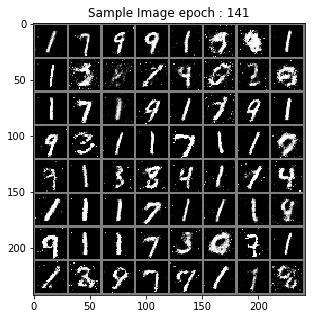

> Epoch : 143 Batch : 19 / 235 Loss_D : 0.6459724307060242 Loss_G : 1.8111402988433838
> Epoch : 143 Batch : 39 / 235 Loss_D : 0.5727563500404358 Loss_G : 2.1124465465545654
> Epoch : 143 Batch : 59 / 235 Loss_D : 0.7658756971359253 Loss_G : 2.030909299850464
> Epoch : 143 Batch : 79 / 235 Loss_D : 0.5612837076187134 Loss_G : 2.229337692260742
> Epoch : 143 Batch : 99 / 235 Loss_D : 0.6687960028648376 Loss_G : 2.149674654006958
> Epoch : 143 Batch : 119 / 235 Loss_D : 0.7518064975738525 Loss_G : 1.8367055654525757
> Epoch : 143 Batch : 139 / 235 Loss_D : 0.5761446952819824 Loss_G : 2.2820401191711426
> Epoch : 143 Batch : 159 / 235 Loss_D : 0.7122353315353394 Loss_G : 1.7445565462112427
> Epoch : 143 Batch : 179 / 235 Loss_D : 0.707369327545166 Loss_G : 1.8762145042419434
> Epoch : 143 Batch : 199 / 235 Loss_D : 0.6630038022994995 Loss_G : 1.9399805068969727
> Epoch : 143 Batch : 219 / 235 Loss_D : 0.5852068662643433 Loss_G : 2.055121660232544


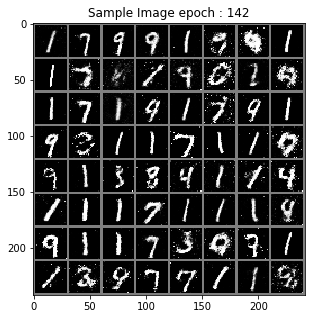

> Epoch : 144 Batch : 19 / 235 Loss_D : 0.7713013887405396 Loss_G : 1.6088151931762695
> Epoch : 144 Batch : 39 / 235 Loss_D : 0.7360247373580933 Loss_G : 2.1464180946350098
> Epoch : 144 Batch : 59 / 235 Loss_D : 0.6271951198577881 Loss_G : 1.8622267246246338
> Epoch : 144 Batch : 79 / 235 Loss_D : 0.6656241416931152 Loss_G : 1.4943277835845947
> Epoch : 144 Batch : 99 / 235 Loss_D : 0.708937406539917 Loss_G : 1.861533522605896
> Epoch : 144 Batch : 119 / 235 Loss_D : 0.6941946148872375 Loss_G : 2.2102065086364746
> Epoch : 144 Batch : 139 / 235 Loss_D : 0.6895145177841187 Loss_G : 2.0367746353149414
> Epoch : 144 Batch : 159 / 235 Loss_D : 0.6329383850097656 Loss_G : 2.0760040283203125
> Epoch : 144 Batch : 179 / 235 Loss_D : 0.7069297432899475 Loss_G : 1.9588106870651245
> Epoch : 144 Batch : 199 / 235 Loss_D : 0.5843597650527954 Loss_G : 2.155595541000366
> Epoch : 144 Batch : 219 / 235 Loss_D : 0.7199305891990662 Loss_G : 1.7687060832977295


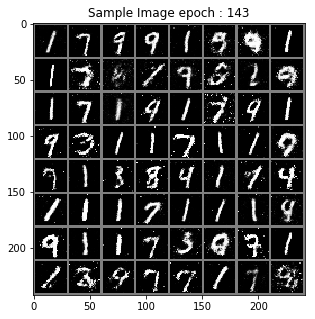

> Epoch : 145 Batch : 19 / 235 Loss_D : 0.656922459602356 Loss_G : 2.276495933532715
> Epoch : 145 Batch : 39 / 235 Loss_D : 0.7997645139694214 Loss_G : 1.8244833946228027
> Epoch : 145 Batch : 59 / 235 Loss_D : 0.6725761890411377 Loss_G : 1.9533922672271729
> Epoch : 145 Batch : 79 / 235 Loss_D : 0.7034229040145874 Loss_G : 1.8260676860809326
> Epoch : 145 Batch : 99 / 235 Loss_D : 0.6364074945449829 Loss_G : 1.9333752393722534
> Epoch : 145 Batch : 119 / 235 Loss_D : 0.7291578054428101 Loss_G : 1.8379971981048584
> Epoch : 145 Batch : 139 / 235 Loss_D : 0.726375937461853 Loss_G : 1.7367899417877197
> Epoch : 145 Batch : 159 / 235 Loss_D : 0.6671937704086304 Loss_G : 2.116227149963379
> Epoch : 145 Batch : 179 / 235 Loss_D : 0.7179321050643921 Loss_G : 1.8694592714309692
> Epoch : 145 Batch : 199 / 235 Loss_D : 0.6048779487609863 Loss_G : 2.2051877975463867
> Epoch : 145 Batch : 219 / 235 Loss_D : 0.6699191927909851 Loss_G : 2.2273707389831543


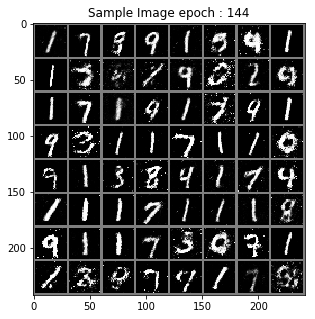

> Epoch : 146 Batch : 19 / 235 Loss_D : 0.6652553081512451 Loss_G : 2.2210350036621094
> Epoch : 146 Batch : 39 / 235 Loss_D : 0.7696470022201538 Loss_G : 1.8361248970031738
> Epoch : 146 Batch : 59 / 235 Loss_D : 0.727986216545105 Loss_G : 1.596191167831421
> Epoch : 146 Batch : 79 / 235 Loss_D : 0.6325526237487793 Loss_G : 1.8991234302520752
> Epoch : 146 Batch : 99 / 235 Loss_D : 0.7028697729110718 Loss_G : 1.7214481830596924
> Epoch : 146 Batch : 119 / 235 Loss_D : 0.6733969449996948 Loss_G : 1.5905693769454956
> Epoch : 146 Batch : 139 / 235 Loss_D : 0.5833231806755066 Loss_G : 2.143393039703369
> Epoch : 146 Batch : 159 / 235 Loss_D : 0.7243950963020325 Loss_G : 1.9967416524887085
> Epoch : 146 Batch : 179 / 235 Loss_D : 0.6848939657211304 Loss_G : 1.9829119443893433
> Epoch : 146 Batch : 199 / 235 Loss_D : 0.7019869089126587 Loss_G : 1.6520719528198242
> Epoch : 146 Batch : 219 / 235 Loss_D : 0.6959406137466431 Loss_G : 1.8447297811508179


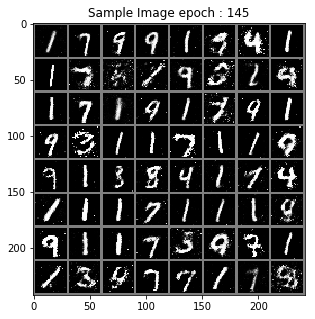

> Epoch : 147 Batch : 19 / 235 Loss_D : 0.7255343198776245 Loss_G : 2.013451099395752
> Epoch : 147 Batch : 39 / 235 Loss_D : 0.6356953978538513 Loss_G : 2.227759838104248
> Epoch : 147 Batch : 59 / 235 Loss_D : 0.8812595009803772 Loss_G : 2.2555904388427734
> Epoch : 147 Batch : 79 / 235 Loss_D : 0.7116931676864624 Loss_G : 2.2834701538085938
> Epoch : 147 Batch : 99 / 235 Loss_D : 0.7761329412460327 Loss_G : 1.988137125968933
> Epoch : 147 Batch : 119 / 235 Loss_D : 0.5825592279434204 Loss_G : 2.458725929260254
> Epoch : 147 Batch : 139 / 235 Loss_D : 0.7953156232833862 Loss_G : 2.010059356689453
> Epoch : 147 Batch : 159 / 235 Loss_D : 0.6278280019760132 Loss_G : 2.307952880859375
> Epoch : 147 Batch : 179 / 235 Loss_D : 0.821932315826416 Loss_G : 1.5555822849273682
> Epoch : 147 Batch : 199 / 235 Loss_D : 0.6775550246238708 Loss_G : 1.5137602090835571
> Epoch : 147 Batch : 219 / 235 Loss_D : 0.6266975402832031 Loss_G : 2.217616558074951


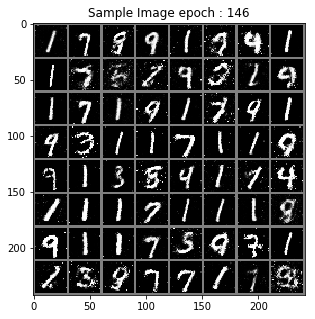

> Epoch : 148 Batch : 19 / 235 Loss_D : 0.682193398475647 Loss_G : 1.9619910717010498
> Epoch : 148 Batch : 39 / 235 Loss_D : 0.6887803077697754 Loss_G : 1.5888906717300415
> Epoch : 148 Batch : 59 / 235 Loss_D : 0.6792737245559692 Loss_G : 1.701967477798462
> Epoch : 148 Batch : 79 / 235 Loss_D : 0.7372143268585205 Loss_G : 1.8669356107711792
> Epoch : 148 Batch : 99 / 235 Loss_D : 0.6738236546516418 Loss_G : 2.192429542541504
> Epoch : 148 Batch : 119 / 235 Loss_D : 0.705660343170166 Loss_G : 2.196483850479126
> Epoch : 148 Batch : 139 / 235 Loss_D : 0.635114848613739 Loss_G : 2.102782726287842
> Epoch : 148 Batch : 159 / 235 Loss_D : 0.6984509229660034 Loss_G : 2.1117427349090576
> Epoch : 148 Batch : 179 / 235 Loss_D : 0.766148030757904 Loss_G : 1.8538880348205566
> Epoch : 148 Batch : 199 / 235 Loss_D : 0.6159654855728149 Loss_G : 1.916140079498291
> Epoch : 148 Batch : 219 / 235 Loss_D : 0.7176098823547363 Loss_G : 1.71417236328125


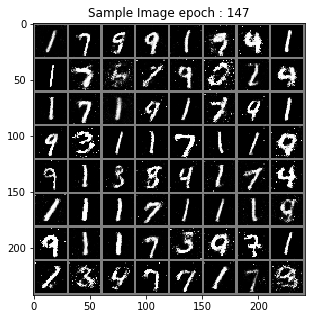

> Epoch : 149 Batch : 19 / 235 Loss_D : 0.569362998008728 Loss_G : 2.098621368408203
> Epoch : 149 Batch : 39 / 235 Loss_D : 0.7660045623779297 Loss_G : 1.7417598962783813
> Epoch : 149 Batch : 59 / 235 Loss_D : 0.7525036931037903 Loss_G : 1.681562900543213
> Epoch : 149 Batch : 79 / 235 Loss_D : 0.6459068655967712 Loss_G : 2.2786812782287598
> Epoch : 149 Batch : 99 / 235 Loss_D : 0.7407311201095581 Loss_G : 1.6892979145050049
> Epoch : 149 Batch : 119 / 235 Loss_D : 0.7282789349555969 Loss_G : 1.74102783203125
> Epoch : 149 Batch : 139 / 235 Loss_D : 0.6742405295372009 Loss_G : 1.7716240882873535
> Epoch : 149 Batch : 159 / 235 Loss_D : 0.7229126691818237 Loss_G : 1.9747343063354492
> Epoch : 149 Batch : 179 / 235 Loss_D : 0.6228644847869873 Loss_G : 2.7664592266082764
> Epoch : 149 Batch : 199 / 235 Loss_D : 0.6952177286148071 Loss_G : 2.152833938598633
> Epoch : 149 Batch : 219 / 235 Loss_D : 0.5993564128875732 Loss_G : 2.1160666942596436


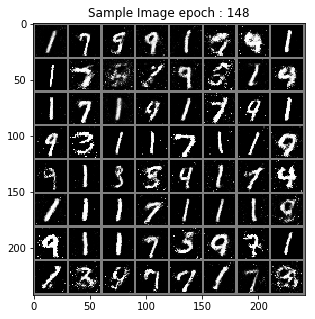

> Epoch : 150 Batch : 19 / 235 Loss_D : 0.7601646184921265 Loss_G : 1.8611364364624023
> Epoch : 150 Batch : 39 / 235 Loss_D : 0.5943809747695923 Loss_G : 2.316652774810791
> Epoch : 150 Batch : 59 / 235 Loss_D : 0.7021268606185913 Loss_G : 2.040893077850342
> Epoch : 150 Batch : 79 / 235 Loss_D : 0.650222897529602 Loss_G : 1.8642253875732422
> Epoch : 150 Batch : 99 / 235 Loss_D : 0.7634948492050171 Loss_G : 1.8500211238861084
> Epoch : 150 Batch : 119 / 235 Loss_D : 0.6220759749412537 Loss_G : 2.3634824752807617
> Epoch : 150 Batch : 139 / 235 Loss_D : 0.73675537109375 Loss_G : 1.9977880716323853
> Epoch : 150 Batch : 159 / 235 Loss_D : 0.70582515001297 Loss_G : 1.898585557937622
> Epoch : 150 Batch : 179 / 235 Loss_D : 0.6919823288917542 Loss_G : 1.8722624778747559
> Epoch : 150 Batch : 199 / 235 Loss_D : 0.7741326093673706 Loss_G : 1.8503646850585938
> Epoch : 150 Batch : 219 / 235 Loss_D : 0.6749945282936096 Loss_G : 1.97217857837677


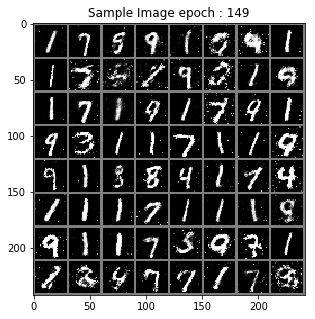

> Epoch : 151 Batch : 19 / 235 Loss_D : 0.6484551429748535 Loss_G : 2.3344314098358154
> Epoch : 151 Batch : 39 / 235 Loss_D : 0.901197075843811 Loss_G : 1.803074598312378
> Epoch : 151 Batch : 59 / 235 Loss_D : 0.6801015138626099 Loss_G : 1.9802488088607788
> Epoch : 151 Batch : 79 / 235 Loss_D : 0.6556306481361389 Loss_G : 1.8619498014450073
> Epoch : 151 Batch : 99 / 235 Loss_D : 0.7268728613853455 Loss_G : 1.7570922374725342
> Epoch : 151 Batch : 119 / 235 Loss_D : 0.6632356643676758 Loss_G : 2.14084529876709
> Epoch : 151 Batch : 139 / 235 Loss_D : 0.648041307926178 Loss_G : 1.8840830326080322
> Epoch : 151 Batch : 159 / 235 Loss_D : 0.5796598792076111 Loss_G : 2.0343151092529297
> Epoch : 151 Batch : 179 / 235 Loss_D : 0.7377322912216187 Loss_G : 2.0210444927215576
> Epoch : 151 Batch : 199 / 235 Loss_D : 0.6302189826965332 Loss_G : 2.118694305419922
> Epoch : 151 Batch : 219 / 235 Loss_D : 0.7230018377304077 Loss_G : 1.7317020893096924


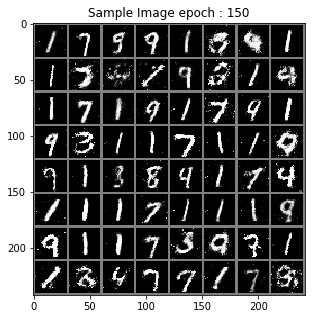

> Epoch : 152 Batch : 19 / 235 Loss_D : 0.831588864326477 Loss_G : 1.9538404941558838
> Epoch : 152 Batch : 39 / 235 Loss_D : 0.6053807735443115 Loss_G : 1.8945608139038086
> Epoch : 152 Batch : 59 / 235 Loss_D : 0.7341234683990479 Loss_G : 2.203795909881592
> Epoch : 152 Batch : 79 / 235 Loss_D : 0.6764390468597412 Loss_G : 2.077204704284668
> Epoch : 152 Batch : 99 / 235 Loss_D : 0.6926918029785156 Loss_G : 1.7427464723587036
> Epoch : 152 Batch : 119 / 235 Loss_D : 0.6566462516784668 Loss_G : 2.313413619995117
> Epoch : 152 Batch : 139 / 235 Loss_D : 0.773809552192688 Loss_G : 1.6495113372802734
> Epoch : 152 Batch : 159 / 235 Loss_D : 0.7469059824943542 Loss_G : 1.6910420656204224
> Epoch : 152 Batch : 179 / 235 Loss_D : 0.7941302061080933 Loss_G : 2.005215644836426
> Epoch : 152 Batch : 199 / 235 Loss_D : 0.7318953275680542 Loss_G : 1.8810733556747437
> Epoch : 152 Batch : 219 / 235 Loss_D : 0.7389888763427734 Loss_G : 1.951361894607544


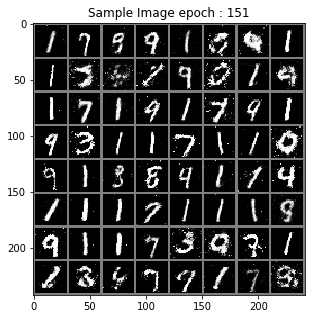

> Epoch : 153 Batch : 19 / 235 Loss_D : 0.6684379577636719 Loss_G : 2.1572983264923096
> Epoch : 153 Batch : 39 / 235 Loss_D : 0.7677854895591736 Loss_G : 1.980738878250122
> Epoch : 153 Batch : 59 / 235 Loss_D : 0.7498899102210999 Loss_G : 1.9239532947540283
> Epoch : 153 Batch : 79 / 235 Loss_D : 0.7479943037033081 Loss_G : 1.6735267639160156
> Epoch : 153 Batch : 99 / 235 Loss_D : 0.6480676531791687 Loss_G : 2.042426586151123
> Epoch : 153 Batch : 119 / 235 Loss_D : 0.8156471252441406 Loss_G : 2.2253942489624023
> Epoch : 153 Batch : 139 / 235 Loss_D : 0.7584530115127563 Loss_G : 2.438087224960327
> Epoch : 153 Batch : 159 / 235 Loss_D : 0.6571990251541138 Loss_G : 2.0867257118225098
> Epoch : 153 Batch : 179 / 235 Loss_D : 0.7712094187736511 Loss_G : 1.8579994440078735
> Epoch : 153 Batch : 199 / 235 Loss_D : 0.8080848455429077 Loss_G : 1.8498880863189697
> Epoch : 153 Batch : 219 / 235 Loss_D : 0.6495015621185303 Loss_G : 1.9550507068634033


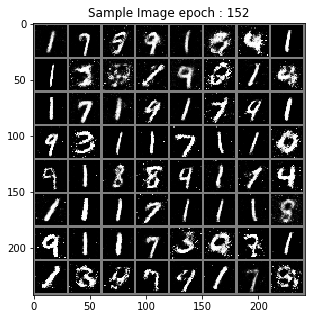

> Epoch : 154 Batch : 19 / 235 Loss_D : 0.6599529981613159 Loss_G : 1.9575214385986328
> Epoch : 154 Batch : 39 / 235 Loss_D : 0.6235626935958862 Loss_G : 2.1766905784606934
> Epoch : 154 Batch : 59 / 235 Loss_D : 0.825096070766449 Loss_G : 1.9479625225067139
> Epoch : 154 Batch : 79 / 235 Loss_D : 0.8001894950866699 Loss_G : 1.813560962677002
> Epoch : 154 Batch : 99 / 235 Loss_D : 0.6386041641235352 Loss_G : 1.8538227081298828
> Epoch : 154 Batch : 119 / 235 Loss_D : 0.6839060187339783 Loss_G : 1.6807509660720825
> Epoch : 154 Batch : 139 / 235 Loss_D : 0.715863823890686 Loss_G : 2.2035233974456787
> Epoch : 154 Batch : 159 / 235 Loss_D : 0.6635335087776184 Loss_G : 2.1092512607574463
> Epoch : 154 Batch : 179 / 235 Loss_D : 0.6250888109207153 Loss_G : 2.0944247245788574
> Epoch : 154 Batch : 199 / 235 Loss_D : 0.7339507341384888 Loss_G : 2.0976810455322266
> Epoch : 154 Batch : 219 / 235 Loss_D : 0.6867949962615967 Loss_G : 1.7183424234390259


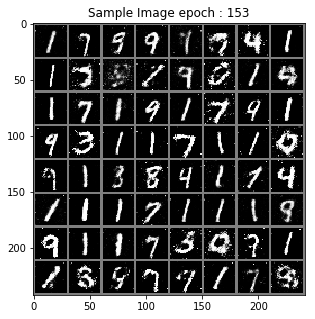

> Epoch : 155 Batch : 19 / 235 Loss_D : 0.6639544367790222 Loss_G : 1.9039729833602905
> Epoch : 155 Batch : 39 / 235 Loss_D : 0.6582889556884766 Loss_G : 1.879584789276123
> Epoch : 155 Batch : 59 / 235 Loss_D : 0.6779495477676392 Loss_G : 2.043015480041504
> Epoch : 155 Batch : 79 / 235 Loss_D : 0.6999554634094238 Loss_G : 2.2626285552978516
> Epoch : 155 Batch : 99 / 235 Loss_D : 0.7602896690368652 Loss_G : 1.9671525955200195
> Epoch : 155 Batch : 119 / 235 Loss_D : 0.7572886943817139 Loss_G : 1.729407787322998
> Epoch : 155 Batch : 139 / 235 Loss_D : 0.6609116792678833 Loss_G : 2.3871002197265625
> Epoch : 155 Batch : 159 / 235 Loss_D : 0.7590841054916382 Loss_G : 1.5931813716888428
> Epoch : 155 Batch : 179 / 235 Loss_D : 0.7589495182037354 Loss_G : 1.863978624343872
> Epoch : 155 Batch : 199 / 235 Loss_D : 0.5991833209991455 Loss_G : 1.8584935665130615
> Epoch : 155 Batch : 219 / 235 Loss_D : 0.7478330135345459 Loss_G : 1.9291627407073975


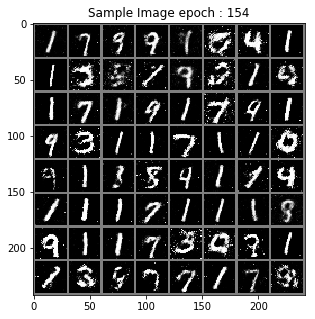

> Epoch : 156 Batch : 19 / 235 Loss_D : 0.6712890863418579 Loss_G : 1.7252869606018066
> Epoch : 156 Batch : 39 / 235 Loss_D : 0.723335325717926 Loss_G : 2.0513782501220703
> Epoch : 156 Batch : 59 / 235 Loss_D : 0.8619847297668457 Loss_G : 1.7731887102127075
> Epoch : 156 Batch : 79 / 235 Loss_D : 0.6897468566894531 Loss_G : 1.974245309829712
> Epoch : 156 Batch : 99 / 235 Loss_D : 0.8539104461669922 Loss_G : 1.9006259441375732
> Epoch : 156 Batch : 119 / 235 Loss_D : 0.6096205711364746 Loss_G : 2.196622848510742
> Epoch : 156 Batch : 139 / 235 Loss_D : 0.7286361455917358 Loss_G : 1.8442851305007935
> Epoch : 156 Batch : 159 / 235 Loss_D : 0.7644611597061157 Loss_G : 2.208716869354248
> Epoch : 156 Batch : 179 / 235 Loss_D : 0.8554543256759644 Loss_G : 1.6319472789764404
> Epoch : 156 Batch : 199 / 235 Loss_D : 0.7009373903274536 Loss_G : 1.6907343864440918
> Epoch : 156 Batch : 219 / 235 Loss_D : 0.7725515365600586 Loss_G : 2.0258848667144775


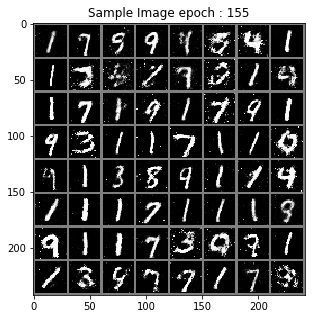

> Epoch : 157 Batch : 19 / 235 Loss_D : 0.7455321550369263 Loss_G : 1.8196113109588623
> Epoch : 157 Batch : 39 / 235 Loss_D : 0.5349826812744141 Loss_G : 2.16292405128479
> Epoch : 157 Batch : 59 / 235 Loss_D : 0.7715429663658142 Loss_G : 1.8786468505859375
> Epoch : 157 Batch : 79 / 235 Loss_D : 0.6206001043319702 Loss_G : 2.4667892456054688
> Epoch : 157 Batch : 99 / 235 Loss_D : 0.8579872846603394 Loss_G : 1.4904156923294067
> Epoch : 157 Batch : 119 / 235 Loss_D : 0.6342519521713257 Loss_G : 1.81685471534729
> Epoch : 157 Batch : 139 / 235 Loss_D : 0.7508556842803955 Loss_G : 1.583766222000122
> Epoch : 157 Batch : 159 / 235 Loss_D : 0.7089865207672119 Loss_G : 2.3078293800354004
> Epoch : 157 Batch : 179 / 235 Loss_D : 0.7519621849060059 Loss_G : 2.29335355758667
> Epoch : 157 Batch : 199 / 235 Loss_D : 0.7051244378089905 Loss_G : 2.1829421520233154
> Epoch : 157 Batch : 219 / 235 Loss_D : 0.695907473564148 Loss_G : 1.7502315044403076


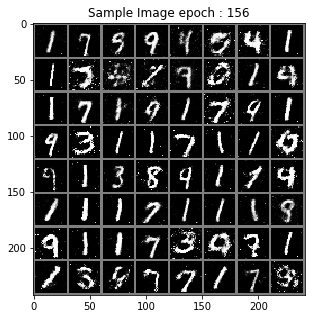

> Epoch : 158 Batch : 19 / 235 Loss_D : 0.6121286153793335 Loss_G : 1.787472128868103
> Epoch : 158 Batch : 39 / 235 Loss_D : 0.6596351861953735 Loss_G : 2.012303352355957
> Epoch : 158 Batch : 59 / 235 Loss_D : 0.6672617197036743 Loss_G : 1.890367031097412
> Epoch : 158 Batch : 79 / 235 Loss_D : 0.6898314952850342 Loss_G : 1.9018468856811523
> Epoch : 158 Batch : 99 / 235 Loss_D : 0.7783302068710327 Loss_G : 1.6997711658477783
> Epoch : 158 Batch : 119 / 235 Loss_D : 0.7856544256210327 Loss_G : 2.0161221027374268
> Epoch : 158 Batch : 139 / 235 Loss_D : 0.7126041054725647 Loss_G : 2.2385873794555664
> Epoch : 158 Batch : 159 / 235 Loss_D : 0.7092148065567017 Loss_G : 1.9718109369277954
> Epoch : 158 Batch : 179 / 235 Loss_D : 0.7107185125350952 Loss_G : 1.9044342041015625
> Epoch : 158 Batch : 199 / 235 Loss_D : 0.7340694665908813 Loss_G : 1.8610063791275024
> Epoch : 158 Batch : 219 / 235 Loss_D : 0.6805219650268555 Loss_G : 1.7101998329162598


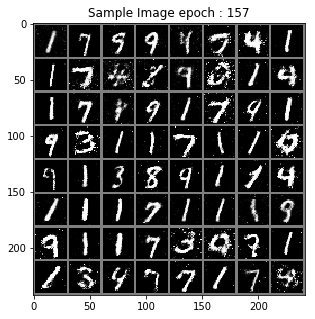

> Epoch : 159 Batch : 19 / 235 Loss_D : 0.7614924311637878 Loss_G : 2.0224130153656006
> Epoch : 159 Batch : 39 / 235 Loss_D : 0.6326957941055298 Loss_G : 2.31008243560791
> Epoch : 159 Batch : 59 / 235 Loss_D : 0.8031095266342163 Loss_G : 1.5853406190872192
> Epoch : 159 Batch : 79 / 235 Loss_D : 0.6305840015411377 Loss_G : 1.9039978981018066
> Epoch : 159 Batch : 99 / 235 Loss_D : 0.7600220441818237 Loss_G : 2.03680419921875
> Epoch : 159 Batch : 119 / 235 Loss_D : 0.7127633094787598 Loss_G : 1.8481132984161377
> Epoch : 159 Batch : 139 / 235 Loss_D : 0.721328854560852 Loss_G : 1.8978711366653442
> Epoch : 159 Batch : 159 / 235 Loss_D : 0.6240004301071167 Loss_G : 2.349428653717041
> Epoch : 159 Batch : 179 / 235 Loss_D : 0.8235176801681519 Loss_G : 1.8630266189575195
> Epoch : 159 Batch : 199 / 235 Loss_D : 0.5784331560134888 Loss_G : 1.9731439352035522
> Epoch : 159 Batch : 219 / 235 Loss_D : 0.8634782433509827 Loss_G : 1.6104588508605957


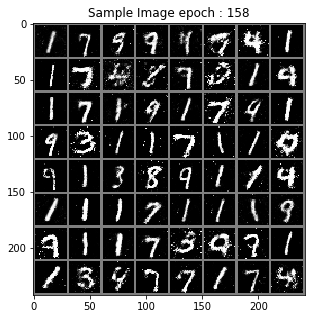

> Epoch : 160 Batch : 19 / 235 Loss_D : 0.8302688598632812 Loss_G : 1.6175596714019775
> Epoch : 160 Batch : 39 / 235 Loss_D : 0.7010971903800964 Loss_G : 1.6601084470748901
> Epoch : 160 Batch : 59 / 235 Loss_D : 0.791853129863739 Loss_G : 1.5960752964019775
> Epoch : 160 Batch : 79 / 235 Loss_D : 0.5146675705909729 Loss_G : 2.11293888092041
> Epoch : 160 Batch : 99 / 235 Loss_D : 0.7700239419937134 Loss_G : 1.6900522708892822
> Epoch : 160 Batch : 119 / 235 Loss_D : 0.7481060028076172 Loss_G : 1.8572356700897217
> Epoch : 160 Batch : 139 / 235 Loss_D : 0.7422373294830322 Loss_G : 2.108914852142334
> Epoch : 160 Batch : 159 / 235 Loss_D : 0.662828803062439 Loss_G : 1.8673218488693237
> Epoch : 160 Batch : 179 / 235 Loss_D : 0.6419360041618347 Loss_G : 2.10990834236145
> Epoch : 160 Batch : 199 / 235 Loss_D : 0.7214148044586182 Loss_G : 1.8872668743133545
> Epoch : 160 Batch : 219 / 235 Loss_D : 0.6728600263595581 Loss_G : 2.353485107421875


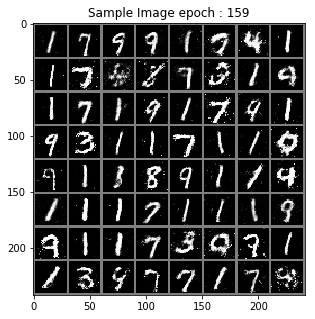

> Epoch : 161 Batch : 19 / 235 Loss_D : 0.7672390937805176 Loss_G : 2.2180581092834473
> Epoch : 161 Batch : 39 / 235 Loss_D : 0.7097870111465454 Loss_G : 2.1241605281829834
> Epoch : 161 Batch : 59 / 235 Loss_D : 0.6547242999076843 Loss_G : 2.1835687160491943
> Epoch : 161 Batch : 79 / 235 Loss_D : 0.7823880910873413 Loss_G : 1.5869660377502441
> Epoch : 161 Batch : 99 / 235 Loss_D : 0.6938681602478027 Loss_G : 2.07326602935791
> Epoch : 161 Batch : 119 / 235 Loss_D : 0.8020755052566528 Loss_G : 1.8449320793151855
> Epoch : 161 Batch : 139 / 235 Loss_D : 0.6972423791885376 Loss_G : 2.116008758544922
> Epoch : 161 Batch : 159 / 235 Loss_D : 0.5817000865936279 Loss_G : 2.0669407844543457
> Epoch : 161 Batch : 179 / 235 Loss_D : 0.6070658564567566 Loss_G : 1.912864327430725
> Epoch : 161 Batch : 199 / 235 Loss_D : 0.7328433990478516 Loss_G : 1.8635728359222412
> Epoch : 161 Batch : 219 / 235 Loss_D : 0.6374974250793457 Loss_G : 2.167902708053589


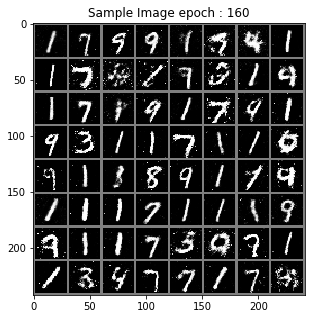

> Epoch : 162 Batch : 19 / 235 Loss_D : 0.6995545029640198 Loss_G : 1.9661226272583008
> Epoch : 162 Batch : 39 / 235 Loss_D : 0.6854756474494934 Loss_G : 1.9524383544921875
> Epoch : 162 Batch : 59 / 235 Loss_D : 0.5928663015365601 Loss_G : 1.9015182256698608
> Epoch : 162 Batch : 79 / 235 Loss_D : 0.7255019545555115 Loss_G : 2.0757527351379395
> Epoch : 162 Batch : 99 / 235 Loss_D : 0.6960917115211487 Loss_G : 1.8486692905426025
> Epoch : 162 Batch : 119 / 235 Loss_D : 0.8123558759689331 Loss_G : 2.0646135807037354
> Epoch : 162 Batch : 139 / 235 Loss_D : 0.6955087184906006 Loss_G : 1.9362661838531494
> Epoch : 162 Batch : 159 / 235 Loss_D : 0.8619221448898315 Loss_G : 1.6373151540756226
> Epoch : 162 Batch : 179 / 235 Loss_D : 0.6853859424591064 Loss_G : 1.8659186363220215
> Epoch : 162 Batch : 199 / 235 Loss_D : 0.6812849640846252 Loss_G : 1.8957493305206299
> Epoch : 162 Batch : 219 / 235 Loss_D : 0.7515649199485779 Loss_G : 1.6973598003387451


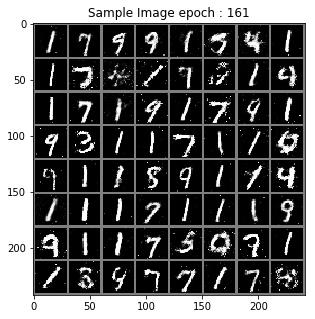

> Epoch : 163 Batch : 19 / 235 Loss_D : 0.7482163310050964 Loss_G : 1.96422278881073
> Epoch : 163 Batch : 39 / 235 Loss_D : 0.6515158414840698 Loss_G : 1.8478105068206787
> Epoch : 163 Batch : 59 / 235 Loss_D : 0.6755663156509399 Loss_G : 1.7895430326461792
> Epoch : 163 Batch : 79 / 235 Loss_D : 0.7278250455856323 Loss_G : 1.7055128812789917
> Epoch : 163 Batch : 99 / 235 Loss_D : 0.7211194038391113 Loss_G : 1.6923542022705078
> Epoch : 163 Batch : 119 / 235 Loss_D : 0.6446599960327148 Loss_G : 1.6891268491744995
> Epoch : 163 Batch : 139 / 235 Loss_D : 0.6793906688690186 Loss_G : 1.6740628480911255
> Epoch : 163 Batch : 159 / 235 Loss_D : 0.7107754945755005 Loss_G : 2.019054412841797
> Epoch : 163 Batch : 179 / 235 Loss_D : 0.6505056619644165 Loss_G : 2.0070958137512207
> Epoch : 163 Batch : 199 / 235 Loss_D : 0.6571066975593567 Loss_G : 1.8445852994918823
> Epoch : 163 Batch : 219 / 235 Loss_D : 0.9165014624595642 Loss_G : 1.6652501821517944


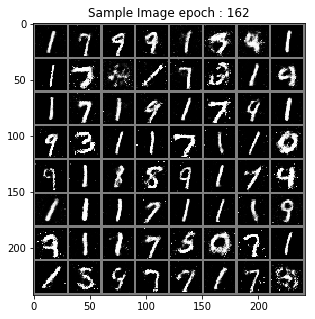

> Epoch : 164 Batch : 19 / 235 Loss_D : 0.8009536862373352 Loss_G : 1.6712372303009033
> Epoch : 164 Batch : 39 / 235 Loss_D : 0.7277821898460388 Loss_G : 1.9446420669555664
> Epoch : 164 Batch : 59 / 235 Loss_D : 0.675622820854187 Loss_G : 1.680509328842163
> Epoch : 164 Batch : 79 / 235 Loss_D : 0.8611814379692078 Loss_G : 1.905584454536438
> Epoch : 164 Batch : 99 / 235 Loss_D : 0.836611270904541 Loss_G : 1.766817569732666
> Epoch : 164 Batch : 119 / 235 Loss_D : 0.6575676798820496 Loss_G : 1.6839159727096558
> Epoch : 164 Batch : 139 / 235 Loss_D : 0.7267907857894897 Loss_G : 1.9706884622573853
> Epoch : 164 Batch : 159 / 235 Loss_D : 0.706146240234375 Loss_G : 1.9854562282562256
> Epoch : 164 Batch : 179 / 235 Loss_D : 0.7283935546875 Loss_G : 1.9632800817489624
> Epoch : 164 Batch : 199 / 235 Loss_D : 0.7081199288368225 Loss_G : 1.748119592666626
> Epoch : 164 Batch : 219 / 235 Loss_D : 0.6831153631210327 Loss_G : 1.685892105102539


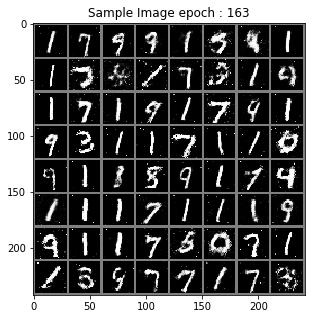

> Epoch : 165 Batch : 19 / 235 Loss_D : 0.7129912376403809 Loss_G : 1.9489545822143555
> Epoch : 165 Batch : 39 / 235 Loss_D : 0.7429773807525635 Loss_G : 1.7970032691955566
> Epoch : 165 Batch : 59 / 235 Loss_D : 0.6612390279769897 Loss_G : 1.9757239818572998
> Epoch : 165 Batch : 79 / 235 Loss_D : 0.7014760971069336 Loss_G : 1.6374413967132568
> Epoch : 165 Batch : 99 / 235 Loss_D : 0.7100847959518433 Loss_G : 1.8676719665527344
> Epoch : 165 Batch : 119 / 235 Loss_D : 0.7417080402374268 Loss_G : 1.8521027565002441
> Epoch : 165 Batch : 139 / 235 Loss_D : 0.6136583089828491 Loss_G : 2.248809814453125
> Epoch : 165 Batch : 159 / 235 Loss_D : 0.8085693120956421 Loss_G : 1.7215468883514404
> Epoch : 165 Batch : 179 / 235 Loss_D : 0.6720578670501709 Loss_G : 1.686213493347168
> Epoch : 165 Batch : 199 / 235 Loss_D : 0.718955934047699 Loss_G : 1.7911628484725952
> Epoch : 165 Batch : 219 / 235 Loss_D : 0.7004575729370117 Loss_G : 2.2969446182250977


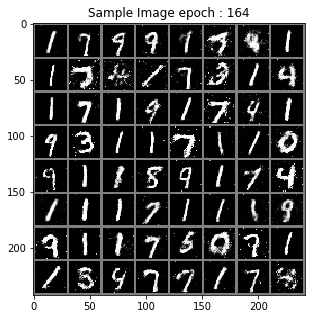

> Epoch : 166 Batch : 19 / 235 Loss_D : 0.7314321994781494 Loss_G : 1.561323881149292
> Epoch : 166 Batch : 39 / 235 Loss_D : 0.7734529376029968 Loss_G : 1.8339240550994873
> Epoch : 166 Batch : 59 / 235 Loss_D : 0.7218170166015625 Loss_G : 1.7501070499420166
> Epoch : 166 Batch : 79 / 235 Loss_D : 0.7100809812545776 Loss_G : 1.9391229152679443
> Epoch : 166 Batch : 99 / 235 Loss_D : 0.7505954504013062 Loss_G : 2.0248918533325195
> Epoch : 166 Batch : 119 / 235 Loss_D : 0.7932968139648438 Loss_G : 1.6860623359680176
> Epoch : 166 Batch : 139 / 235 Loss_D : 0.8605744242668152 Loss_G : 1.868412733078003
> Epoch : 166 Batch : 159 / 235 Loss_D : 0.6998878717422485 Loss_G : 2.1375279426574707
> Epoch : 166 Batch : 179 / 235 Loss_D : 0.5966514348983765 Loss_G : 2.3824028968811035
> Epoch : 166 Batch : 199 / 235 Loss_D : 0.6587280035018921 Loss_G : 1.7774362564086914
> Epoch : 166 Batch : 219 / 235 Loss_D : 0.7331312298774719 Loss_G : 1.9524123668670654


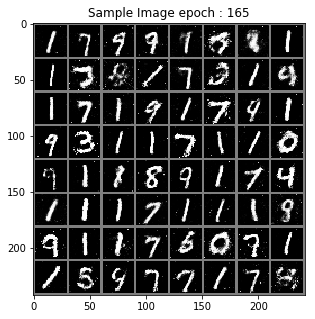

> Epoch : 167 Batch : 19 / 235 Loss_D : 0.8215632438659668 Loss_G : 2.0504674911499023
> Epoch : 167 Batch : 39 / 235 Loss_D : 0.7462817430496216 Loss_G : 2.087724208831787
> Epoch : 167 Batch : 59 / 235 Loss_D : 0.6828545331954956 Loss_G : 1.907038927078247
> Epoch : 167 Batch : 79 / 235 Loss_D : 0.6864840984344482 Loss_G : 1.960260272026062
> Epoch : 167 Batch : 99 / 235 Loss_D : 0.7210847735404968 Loss_G : 2.410095691680908
> Epoch : 167 Batch : 119 / 235 Loss_D : 0.8388906121253967 Loss_G : 1.7121734619140625
> Epoch : 167 Batch : 139 / 235 Loss_D : 0.7395623922348022 Loss_G : 1.870020866394043
> Epoch : 167 Batch : 159 / 235 Loss_D : 0.6147199273109436 Loss_G : 1.679408311843872
> Epoch : 167 Batch : 179 / 235 Loss_D : 0.7058799862861633 Loss_G : 1.5360572338104248
> Epoch : 167 Batch : 199 / 235 Loss_D : 0.7418778538703918 Loss_G : 2.0440573692321777
> Epoch : 167 Batch : 219 / 235 Loss_D : 0.7441190481185913 Loss_G : 2.084294080734253


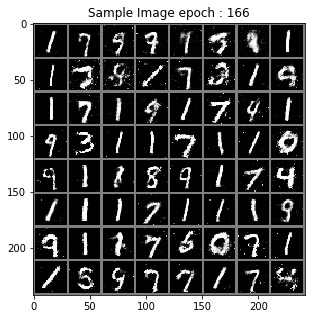

> Epoch : 168 Batch : 19 / 235 Loss_D : 0.6931827068328857 Loss_G : 1.9239895343780518
> Epoch : 168 Batch : 39 / 235 Loss_D : 0.5578030943870544 Loss_G : 1.8474781513214111
> Epoch : 168 Batch : 59 / 235 Loss_D : 0.8369909524917603 Loss_G : 1.7702562808990479
> Epoch : 168 Batch : 79 / 235 Loss_D : 0.6581091284751892 Loss_G : 1.7880275249481201
> Epoch : 168 Batch : 99 / 235 Loss_D : 0.711516261100769 Loss_G : 1.6991097927093506
> Epoch : 168 Batch : 119 / 235 Loss_D : 0.678105890750885 Loss_G : 1.751990795135498
> Epoch : 168 Batch : 139 / 235 Loss_D : 0.5961732864379883 Loss_G : 1.9506847858428955
> Epoch : 168 Batch : 159 / 235 Loss_D : 0.7201046347618103 Loss_G : 1.8426347970962524
> Epoch : 168 Batch : 179 / 235 Loss_D : 0.706028938293457 Loss_G : 1.8393466472625732
> Epoch : 168 Batch : 199 / 235 Loss_D : 0.6984722018241882 Loss_G : 1.6864502429962158
> Epoch : 168 Batch : 219 / 235 Loss_D : 0.8283805847167969 Loss_G : 1.4441405534744263


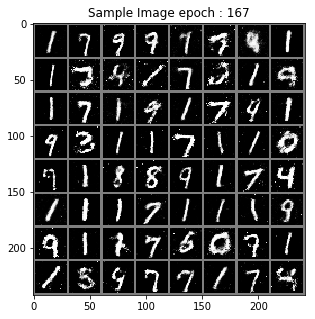

> Epoch : 169 Batch : 19 / 235 Loss_D : 0.7397990226745605 Loss_G : 1.786308765411377
> Epoch : 169 Batch : 39 / 235 Loss_D : 0.6156412363052368 Loss_G : 2.186436653137207
> Epoch : 169 Batch : 59 / 235 Loss_D : 0.7148025035858154 Loss_G : 2.0474298000335693
> Epoch : 169 Batch : 79 / 235 Loss_D : 0.7882242798805237 Loss_G : 2.116642475128174
> Epoch : 169 Batch : 99 / 235 Loss_D : 0.7708680629730225 Loss_G : 1.9737873077392578
> Epoch : 169 Batch : 119 / 235 Loss_D : 0.6897104978561401 Loss_G : 1.8518221378326416
> Epoch : 169 Batch : 139 / 235 Loss_D : 0.6323287487030029 Loss_G : 2.275080680847168
> Epoch : 169 Batch : 159 / 235 Loss_D : 0.809856116771698 Loss_G : 1.894709825515747
> Epoch : 169 Batch : 179 / 235 Loss_D : 0.8340167999267578 Loss_G : 2.0397982597351074
> Epoch : 169 Batch : 199 / 235 Loss_D : 0.6900110244750977 Loss_G : 1.8996127843856812
> Epoch : 169 Batch : 219 / 235 Loss_D : 0.6487593054771423 Loss_G : 2.2088704109191895


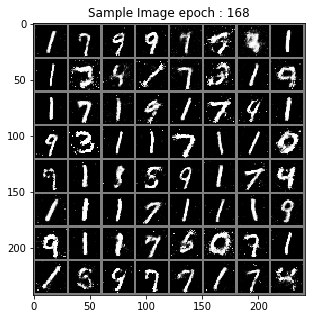

> Epoch : 170 Batch : 19 / 235 Loss_D : 0.5059472322463989 Loss_G : 2.007570266723633
> Epoch : 170 Batch : 39 / 235 Loss_D : 0.8065209984779358 Loss_G : 1.7193572521209717
> Epoch : 170 Batch : 59 / 235 Loss_D : 0.6319026350975037 Loss_G : 1.8804347515106201
> Epoch : 170 Batch : 79 / 235 Loss_D : 0.7496492862701416 Loss_G : 2.274263381958008
> Epoch : 170 Batch : 99 / 235 Loss_D : 0.737472653388977 Loss_G : 1.6927738189697266
> Epoch : 170 Batch : 119 / 235 Loss_D : 0.8505227565765381 Loss_G : 1.6815983057022095
> Epoch : 170 Batch : 139 / 235 Loss_D : 0.711775541305542 Loss_G : 2.132858991622925
> Epoch : 170 Batch : 159 / 235 Loss_D : 0.6707277297973633 Loss_G : 2.6243700981140137
> Epoch : 170 Batch : 179 / 235 Loss_D : 0.8890095949172974 Loss_G : 1.6558969020843506
> Epoch : 170 Batch : 199 / 235 Loss_D : 0.6909003257751465 Loss_G : 1.8499815464019775
> Epoch : 170 Batch : 219 / 235 Loss_D : 0.6884812712669373 Loss_G : 1.9113657474517822


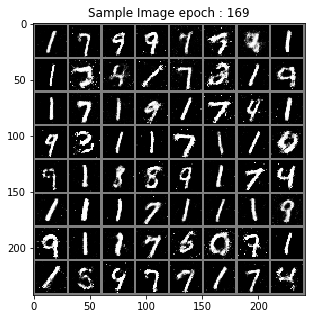

> Epoch : 171 Batch : 19 / 235 Loss_D : 0.7564238905906677 Loss_G : 1.7692999839782715
> Epoch : 171 Batch : 39 / 235 Loss_D : 0.7117207646369934 Loss_G : 1.8215279579162598
> Epoch : 171 Batch : 59 / 235 Loss_D : 0.7856914401054382 Loss_G : 1.7779464721679688
> Epoch : 171 Batch : 79 / 235 Loss_D : 0.6629030704498291 Loss_G : 1.9344011545181274
> Epoch : 171 Batch : 99 / 235 Loss_D : 0.6984208822250366 Loss_G : 2.1726088523864746
> Epoch : 171 Batch : 119 / 235 Loss_D : 0.7891440391540527 Loss_G : 1.9719501733779907
> Epoch : 171 Batch : 139 / 235 Loss_D : 0.7279714941978455 Loss_G : 1.5489962100982666
> Epoch : 171 Batch : 159 / 235 Loss_D : 0.6576906442642212 Loss_G : 1.6491522789001465
> Epoch : 171 Batch : 179 / 235 Loss_D : 0.695395827293396 Loss_G : 1.7249141931533813
> Epoch : 171 Batch : 199 / 235 Loss_D : 0.6830927133560181 Loss_G : 1.737316370010376
> Epoch : 171 Batch : 219 / 235 Loss_D : 0.6198385953903198 Loss_G : 1.824467420578003


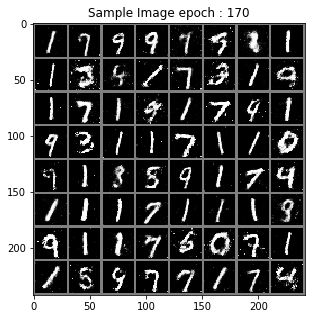

> Epoch : 172 Batch : 19 / 235 Loss_D : 0.511070966720581 Loss_G : 2.0949792861938477
> Epoch : 172 Batch : 39 / 235 Loss_D : 0.6664261817932129 Loss_G : 1.8360060453414917
> Epoch : 172 Batch : 59 / 235 Loss_D : 0.7570770978927612 Loss_G : 1.7537689208984375
> Epoch : 172 Batch : 79 / 235 Loss_D : 0.7566472291946411 Loss_G : 1.7943012714385986
> Epoch : 172 Batch : 99 / 235 Loss_D : 0.7246550917625427 Loss_G : 1.9998232126235962
> Epoch : 172 Batch : 119 / 235 Loss_D : 0.758653461933136 Loss_G : 1.7343862056732178
> Epoch : 172 Batch : 139 / 235 Loss_D : 0.5340271592140198 Loss_G : 2.231046676635742
> Epoch : 172 Batch : 159 / 235 Loss_D : 0.866417646408081 Loss_G : 2.0272350311279297
> Epoch : 172 Batch : 179 / 235 Loss_D : 0.8181542158126831 Loss_G : 1.6885762214660645
> Epoch : 172 Batch : 199 / 235 Loss_D : 0.7119450569152832 Loss_G : 2.318094253540039
> Epoch : 172 Batch : 219 / 235 Loss_D : 0.6945064663887024 Loss_G : 1.8772730827331543


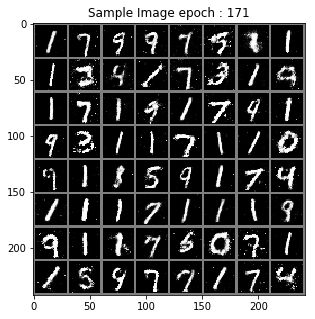

> Epoch : 173 Batch : 19 / 235 Loss_D : 0.7191725969314575 Loss_G : 1.8756422996520996
> Epoch : 173 Batch : 39 / 235 Loss_D : 0.8106164932250977 Loss_G : 1.5680817365646362
> Epoch : 173 Batch : 59 / 235 Loss_D : 0.7512508630752563 Loss_G : 2.161785125732422
> Epoch : 173 Batch : 79 / 235 Loss_D : 0.7638500332832336 Loss_G : 1.8206584453582764
> Epoch : 173 Batch : 99 / 235 Loss_D : 0.6159771084785461 Loss_G : 2.4113802909851074
> Epoch : 173 Batch : 119 / 235 Loss_D : 0.9368197917938232 Loss_G : 1.931161642074585
> Epoch : 173 Batch : 139 / 235 Loss_D : 0.6811922788619995 Loss_G : 1.9512157440185547
> Epoch : 173 Batch : 159 / 235 Loss_D : 0.7147530317306519 Loss_G : 1.8647453784942627
> Epoch : 173 Batch : 179 / 235 Loss_D : 0.7234317064285278 Loss_G : 1.7584375143051147
> Epoch : 173 Batch : 199 / 235 Loss_D : 0.6974341869354248 Loss_G : 1.9022935628890991
> Epoch : 173 Batch : 219 / 235 Loss_D : 0.6799125671386719 Loss_G : 1.9391725063323975


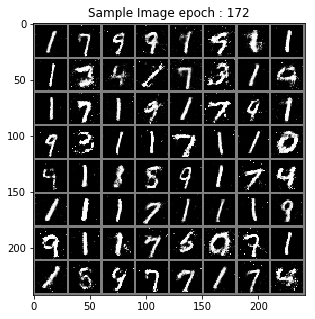

> Epoch : 174 Batch : 19 / 235 Loss_D : 0.872733473777771 Loss_G : 1.6293412446975708
> Epoch : 174 Batch : 39 / 235 Loss_D : 0.6546147465705872 Loss_G : 2.1397876739501953
> Epoch : 174 Batch : 59 / 235 Loss_D : 0.7351399660110474 Loss_G : 1.944859266281128
> Epoch : 174 Batch : 79 / 235 Loss_D : 0.7103402614593506 Loss_G : 1.704210638999939
> Epoch : 174 Batch : 99 / 235 Loss_D : 0.7959172129631042 Loss_G : 2.0103092193603516
> Epoch : 174 Batch : 119 / 235 Loss_D : 0.7353280782699585 Loss_G : 1.9082133769989014
> Epoch : 174 Batch : 139 / 235 Loss_D : 0.7803715467453003 Loss_G : 1.8321616649627686
> Epoch : 174 Batch : 159 / 235 Loss_D : 0.6855721473693848 Loss_G : 2.3002169132232666
> Epoch : 174 Batch : 179 / 235 Loss_D : 1.0008589029312134 Loss_G : 1.488175392150879
> Epoch : 174 Batch : 199 / 235 Loss_D : 0.7388759255409241 Loss_G : 1.7401596307754517
> Epoch : 174 Batch : 219 / 235 Loss_D : 0.7042807936668396 Loss_G : 1.9414753913879395


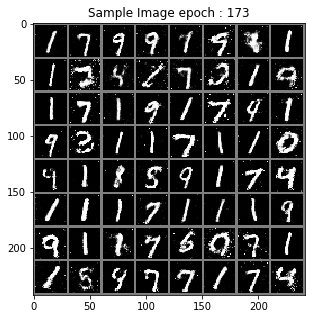

> Epoch : 175 Batch : 19 / 235 Loss_D : 0.672488808631897 Loss_G : 2.112034320831299
> Epoch : 175 Batch : 39 / 235 Loss_D : 0.8139146566390991 Loss_G : 1.8522212505340576
> Epoch : 175 Batch : 59 / 235 Loss_D : 0.6112083196640015 Loss_G : 2.142495632171631
> Epoch : 175 Batch : 79 / 235 Loss_D : 0.7939541339874268 Loss_G : 1.682534098625183
> Epoch : 175 Batch : 99 / 235 Loss_D : 0.7257531881332397 Loss_G : 1.768203854560852
> Epoch : 175 Batch : 119 / 235 Loss_D : 0.8283114433288574 Loss_G : 1.890217900276184
> Epoch : 175 Batch : 139 / 235 Loss_D : 0.7201402187347412 Loss_G : 2.0462844371795654
> Epoch : 175 Batch : 159 / 235 Loss_D : 0.8107653856277466 Loss_G : 1.8141207695007324
> Epoch : 175 Batch : 179 / 235 Loss_D : 0.7022005915641785 Loss_G : 2.296095132827759
> Epoch : 175 Batch : 199 / 235 Loss_D : 0.7925971746444702 Loss_G : 1.6905434131622314
> Epoch : 175 Batch : 219 / 235 Loss_D : 0.6787360310554504 Loss_G : 1.6806584596633911


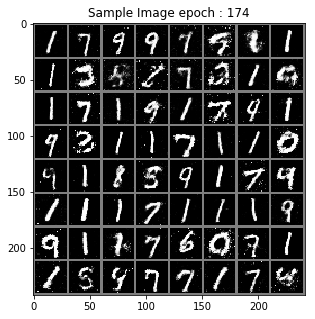

> Epoch : 176 Batch : 19 / 235 Loss_D : 0.6893824338912964 Loss_G : 1.722695231437683
> Epoch : 176 Batch : 39 / 235 Loss_D : 0.7059928178787231 Loss_G : 2.0518147945404053
> Epoch : 176 Batch : 59 / 235 Loss_D : 0.725209653377533 Loss_G : 1.8463809490203857
> Epoch : 176 Batch : 79 / 235 Loss_D : 0.7154728174209595 Loss_G : 1.7930705547332764
> Epoch : 176 Batch : 99 / 235 Loss_D : 0.5968787670135498 Loss_G : 1.8489506244659424
> Epoch : 176 Batch : 119 / 235 Loss_D : 0.8684507012367249 Loss_G : 1.405409574508667
> Epoch : 176 Batch : 139 / 235 Loss_D : 0.674001932144165 Loss_G : 1.841090440750122
> Epoch : 176 Batch : 159 / 235 Loss_D : 0.76683509349823 Loss_G : 1.6884098052978516
> Epoch : 176 Batch : 179 / 235 Loss_D : 0.7119327783584595 Loss_G : 1.9147515296936035
> Epoch : 176 Batch : 199 / 235 Loss_D : 0.7864072322845459 Loss_G : 1.7694029808044434
> Epoch : 176 Batch : 219 / 235 Loss_D : 0.6628942489624023 Loss_G : 2.041440963745117


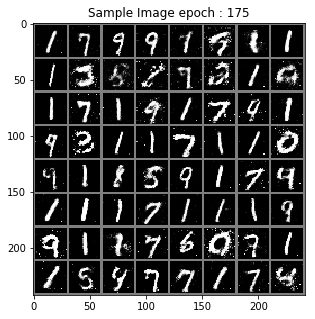

> Epoch : 177 Batch : 19 / 235 Loss_D : 0.7126356363296509 Loss_G : 2.1980082988739014
> Epoch : 177 Batch : 39 / 235 Loss_D : 0.7697210907936096 Loss_G : 2.1304259300231934
> Epoch : 177 Batch : 59 / 235 Loss_D : 0.695386528968811 Loss_G : 2.1848154067993164
> Epoch : 177 Batch : 79 / 235 Loss_D : 0.7813395261764526 Loss_G : 1.6658068895339966
> Epoch : 177 Batch : 99 / 235 Loss_D : 0.7142229080200195 Loss_G : 1.8869656324386597
> Epoch : 177 Batch : 119 / 235 Loss_D : 0.7976550459861755 Loss_G : 1.7350693941116333
> Epoch : 177 Batch : 139 / 235 Loss_D : 0.7351143956184387 Loss_G : 2.020721435546875
> Epoch : 177 Batch : 159 / 235 Loss_D : 0.6027915477752686 Loss_G : 2.2190818786621094
> Epoch : 177 Batch : 179 / 235 Loss_D : 0.8129135370254517 Loss_G : 2.0244874954223633
> Epoch : 177 Batch : 199 / 235 Loss_D : 0.6615399122238159 Loss_G : 2.1065876483917236
> Epoch : 177 Batch : 219 / 235 Loss_D : 0.7717809677124023 Loss_G : 1.9231133460998535


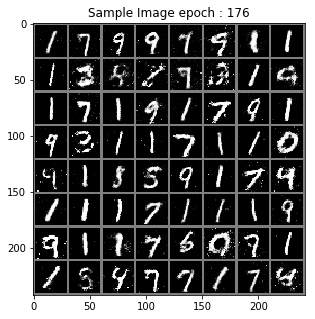

> Epoch : 178 Batch : 19 / 235 Loss_D : 0.8313748836517334 Loss_G : 1.668118953704834
> Epoch : 178 Batch : 39 / 235 Loss_D : 0.6621407866477966 Loss_G : 2.0893850326538086
> Epoch : 178 Batch : 59 / 235 Loss_D : 0.8591010570526123 Loss_G : 1.7719402313232422
> Epoch : 178 Batch : 79 / 235 Loss_D : 0.6634994149208069 Loss_G : 1.8942296504974365
> Epoch : 178 Batch : 99 / 235 Loss_D : 0.8751481771469116 Loss_G : 1.650207757949829
> Epoch : 178 Batch : 119 / 235 Loss_D : 0.7695413827896118 Loss_G : 1.9136450290679932
> Epoch : 178 Batch : 139 / 235 Loss_D : 0.8649559020996094 Loss_G : 1.7890642881393433
> Epoch : 178 Batch : 159 / 235 Loss_D : 0.6161725521087646 Loss_G : 1.91111159324646
> Epoch : 178 Batch : 179 / 235 Loss_D : 0.7636099457740784 Loss_G : 1.8994439840316772
> Epoch : 178 Batch : 199 / 235 Loss_D : 0.7571514844894409 Loss_G : 1.924277663230896
> Epoch : 178 Batch : 219 / 235 Loss_D : 0.6602218151092529 Loss_G : 2.0100440979003906


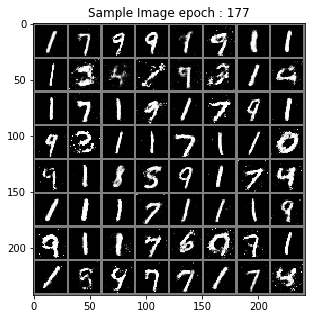

> Epoch : 179 Batch : 19 / 235 Loss_D : 0.5820592045783997 Loss_G : 1.9000176191329956
> Epoch : 179 Batch : 39 / 235 Loss_D : 0.8431673645973206 Loss_G : 2.0507454872131348
> Epoch : 179 Batch : 59 / 235 Loss_D : 0.6922290325164795 Loss_G : 1.9984145164489746
> Epoch : 179 Batch : 79 / 235 Loss_D : 0.7489880323410034 Loss_G : 1.9053945541381836
> Epoch : 179 Batch : 99 / 235 Loss_D : 0.689098060131073 Loss_G : 1.8267606496810913
> Epoch : 179 Batch : 119 / 235 Loss_D : 0.7815427780151367 Loss_G : 2.217583656311035
> Epoch : 179 Batch : 139 / 235 Loss_D : 0.8475781083106995 Loss_G : 1.79245924949646
> Epoch : 179 Batch : 159 / 235 Loss_D : 0.7836761474609375 Loss_G : 1.7862539291381836
> Epoch : 179 Batch : 179 / 235 Loss_D : 0.7250866293907166 Loss_G : 1.5227036476135254
> Epoch : 179 Batch : 199 / 235 Loss_D : 0.7734184265136719 Loss_G : 1.8720064163208008
> Epoch : 179 Batch : 219 / 235 Loss_D : 0.8568530082702637 Loss_G : 1.9246540069580078


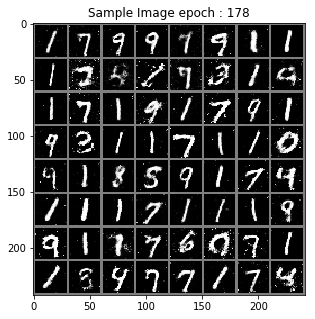

> Epoch : 180 Batch : 19 / 235 Loss_D : 0.8947677612304688 Loss_G : 1.3607838153839111
> Epoch : 180 Batch : 39 / 235 Loss_D : 0.7352204322814941 Loss_G : 2.1599204540252686
> Epoch : 180 Batch : 59 / 235 Loss_D : 0.7814786434173584 Loss_G : 1.538109540939331
> Epoch : 180 Batch : 79 / 235 Loss_D : 0.6578847169876099 Loss_G : 2.190492868423462
> Epoch : 180 Batch : 99 / 235 Loss_D : 0.7237076163291931 Loss_G : 1.689175009727478
> Epoch : 180 Batch : 119 / 235 Loss_D : 0.6968992352485657 Loss_G : 1.7993547916412354
> Epoch : 180 Batch : 139 / 235 Loss_D : 0.7906402349472046 Loss_G : 1.6809489727020264
> Epoch : 180 Batch : 159 / 235 Loss_D : 0.6849077939987183 Loss_G : 1.766373872756958
> Epoch : 180 Batch : 179 / 235 Loss_D : 0.8298583030700684 Loss_G : 1.661888599395752
> Epoch : 180 Batch : 199 / 235 Loss_D : 0.7371760606765747 Loss_G : 1.8982141017913818
> Epoch : 180 Batch : 219 / 235 Loss_D : 0.7204235792160034 Loss_G : 1.6356348991394043


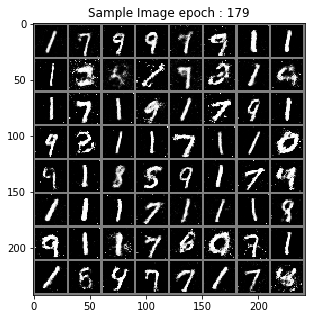

> Epoch : 181 Batch : 19 / 235 Loss_D : 0.8136369585990906 Loss_G : 1.9255973100662231
> Epoch : 181 Batch : 39 / 235 Loss_D : 0.7071124315261841 Loss_G : 1.9898052215576172
> Epoch : 181 Batch : 59 / 235 Loss_D : 0.7537145018577576 Loss_G : 1.495342493057251
> Epoch : 181 Batch : 79 / 235 Loss_D : 0.6403895020484924 Loss_G : 1.8624467849731445
> Epoch : 181 Batch : 99 / 235 Loss_D : 0.7565605044364929 Loss_G : 1.869010090827942
> Epoch : 181 Batch : 119 / 235 Loss_D : 0.7131690979003906 Loss_G : 2.0480613708496094
> Epoch : 181 Batch : 139 / 235 Loss_D : 0.8939303755760193 Loss_G : 1.9428921937942505
> Epoch : 181 Batch : 159 / 235 Loss_D : 0.671830415725708 Loss_G : 2.1250624656677246
> Epoch : 181 Batch : 179 / 235 Loss_D : 0.8149796724319458 Loss_G : 1.7540115118026733
> Epoch : 181 Batch : 199 / 235 Loss_D : 0.7118672728538513 Loss_G : 1.978959560394287
> Epoch : 181 Batch : 219 / 235 Loss_D : 0.766278862953186 Loss_G : 1.7796550989151


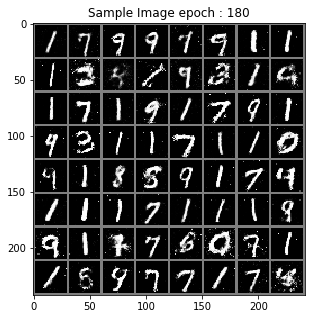

> Epoch : 182 Batch : 19 / 235 Loss_D : 0.6595768332481384 Loss_G : 1.8062618970870972
> Epoch : 182 Batch : 39 / 235 Loss_D : 0.7261224985122681 Loss_G : 1.8920845985412598
> Epoch : 182 Batch : 59 / 235 Loss_D : 0.5784715414047241 Loss_G : 2.1940298080444336
> Epoch : 182 Batch : 79 / 235 Loss_D : 0.8537555932998657 Loss_G : 1.683324933052063
> Epoch : 182 Batch : 99 / 235 Loss_D : 0.8014791011810303 Loss_G : 1.6533393859863281
> Epoch : 182 Batch : 119 / 235 Loss_D : 0.7147246599197388 Loss_G : 1.6682851314544678
> Epoch : 182 Batch : 139 / 235 Loss_D : 0.7129755020141602 Loss_G : 1.983065128326416
> Epoch : 182 Batch : 159 / 235 Loss_D : 0.7460160851478577 Loss_G : 1.9549330472946167
> Epoch : 182 Batch : 179 / 235 Loss_D : 0.7930488586425781 Loss_G : 2.106126070022583
> Epoch : 182 Batch : 199 / 235 Loss_D : 0.667176365852356 Loss_G : 2.0356884002685547
> Epoch : 182 Batch : 219 / 235 Loss_D : 0.6582725644111633 Loss_G : 1.737323522567749


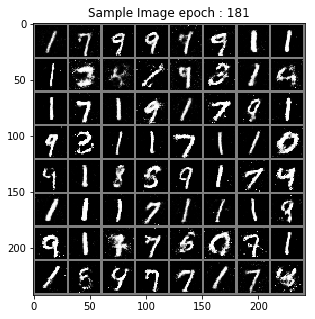

> Epoch : 183 Batch : 19 / 235 Loss_D : 0.6360970735549927 Loss_G : 2.1529014110565186
> Epoch : 183 Batch : 39 / 235 Loss_D : 0.750359058380127 Loss_G : 1.9017035961151123
> Epoch : 183 Batch : 59 / 235 Loss_D : 0.7309869527816772 Loss_G : 1.8139936923980713
> Epoch : 183 Batch : 79 / 235 Loss_D : 0.6908089518547058 Loss_G : 1.7843952178955078
> Epoch : 183 Batch : 99 / 235 Loss_D : 0.7106446027755737 Loss_G : 2.0332980155944824
> Epoch : 183 Batch : 119 / 235 Loss_D : 0.826854944229126 Loss_G : 1.8098058700561523
> Epoch : 183 Batch : 139 / 235 Loss_D : 0.6485418677330017 Loss_G : 1.766625165939331
> Epoch : 183 Batch : 159 / 235 Loss_D : 0.7940442562103271 Loss_G : 2.0064449310302734
> Epoch : 183 Batch : 179 / 235 Loss_D : 0.7652972936630249 Loss_G : 2.082200288772583
> Epoch : 183 Batch : 199 / 235 Loss_D : 0.7648678421974182 Loss_G : 1.7124171257019043
> Epoch : 183 Batch : 219 / 235 Loss_D : 0.7226676940917969 Loss_G : 1.7378876209259033


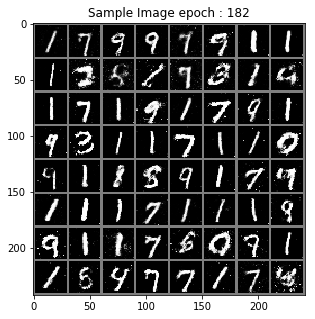

> Epoch : 184 Batch : 19 / 235 Loss_D : 0.8262302875518799 Loss_G : 1.7270102500915527
> Epoch : 184 Batch : 39 / 235 Loss_D : 0.6721136569976807 Loss_G : 1.8033604621887207
> Epoch : 184 Batch : 59 / 235 Loss_D : 0.7625642418861389 Loss_G : 1.7300150394439697
> Epoch : 184 Batch : 79 / 235 Loss_D : 0.6539756059646606 Loss_G : 1.9104509353637695
> Epoch : 184 Batch : 99 / 235 Loss_D : 0.7121889591217041 Loss_G : 1.792549729347229
> Epoch : 184 Batch : 119 / 235 Loss_D : 0.6466557383537292 Loss_G : 1.8244917392730713
> Epoch : 184 Batch : 139 / 235 Loss_D : 0.7194854021072388 Loss_G : 1.629604697227478
> Epoch : 184 Batch : 159 / 235 Loss_D : 0.7442203760147095 Loss_G : 1.7225987911224365
> Epoch : 184 Batch : 179 / 235 Loss_D : 0.7427294254302979 Loss_G : 1.9595379829406738
> Epoch : 184 Batch : 199 / 235 Loss_D : 0.6745501160621643 Loss_G : 1.9338393211364746
> Epoch : 184 Batch : 219 / 235 Loss_D : 0.6821549534797668 Loss_G : 1.7452499866485596


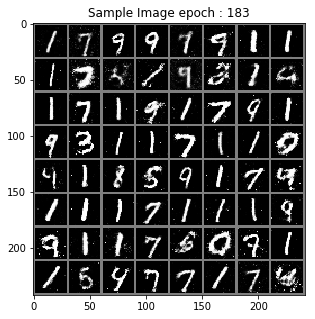

> Epoch : 185 Batch : 19 / 235 Loss_D : 0.7440063953399658 Loss_G : 1.9019174575805664
> Epoch : 185 Batch : 39 / 235 Loss_D : 0.6287906169891357 Loss_G : 2.109219551086426
> Epoch : 185 Batch : 59 / 235 Loss_D : 0.8393590450286865 Loss_G : 1.459344506263733
> Epoch : 185 Batch : 79 / 235 Loss_D : 0.7662147283554077 Loss_G : 1.8564761877059937
> Epoch : 185 Batch : 99 / 235 Loss_D : 0.7848160266876221 Loss_G : 1.794785976409912
> Epoch : 185 Batch : 119 / 235 Loss_D : 0.7696917057037354 Loss_G : 1.8703243732452393
> Epoch : 185 Batch : 139 / 235 Loss_D : 0.7031707763671875 Loss_G : 1.9809188842773438
> Epoch : 185 Batch : 159 / 235 Loss_D : 0.871230959892273 Loss_G : 1.6591010093688965
> Epoch : 185 Batch : 179 / 235 Loss_D : 0.7168878316879272 Loss_G : 1.7610599994659424
> Epoch : 185 Batch : 199 / 235 Loss_D : 0.8626755475997925 Loss_G : 1.6652318239212036
> Epoch : 185 Batch : 219 / 235 Loss_D : 0.7742063403129578 Loss_G : 2.0132975578308105


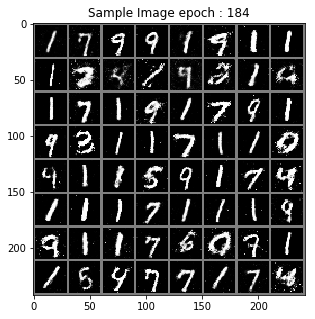

> Epoch : 186 Batch : 19 / 235 Loss_D : 0.6916730403900146 Loss_G : 2.053318738937378
> Epoch : 186 Batch : 39 / 235 Loss_D : 0.7533208727836609 Loss_G : 2.2300117015838623
> Epoch : 186 Batch : 59 / 235 Loss_D : 0.7920517921447754 Loss_G : 1.85255765914917
> Epoch : 186 Batch : 79 / 235 Loss_D : 0.7091825008392334 Loss_G : 1.927163004875183
> Epoch : 186 Batch : 99 / 235 Loss_D : 0.7728356719017029 Loss_G : 1.9233651161193848
> Epoch : 186 Batch : 119 / 235 Loss_D : 0.8239250183105469 Loss_G : 1.9173039197921753
> Epoch : 186 Batch : 139 / 235 Loss_D : 0.7532777190208435 Loss_G : 1.7678139209747314
> Epoch : 186 Batch : 159 / 235 Loss_D : 0.7177079916000366 Loss_G : 1.770887851715088
> Epoch : 186 Batch : 179 / 235 Loss_D : 0.7955445051193237 Loss_G : 2.0190269947052
> Epoch : 186 Batch : 199 / 235 Loss_D : 0.7198396921157837 Loss_G : 1.788404941558838
> Epoch : 186 Batch : 219 / 235 Loss_D : 0.5747067928314209 Loss_G : 1.7960498332977295


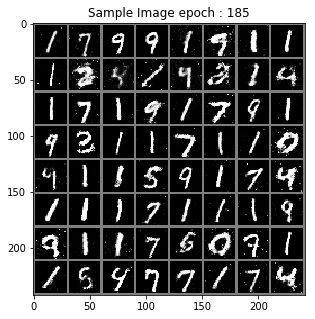

> Epoch : 187 Batch : 19 / 235 Loss_D : 0.7787894606590271 Loss_G : 1.6214709281921387
> Epoch : 187 Batch : 39 / 235 Loss_D : 0.6833404302597046 Loss_G : 1.6700854301452637
> Epoch : 187 Batch : 59 / 235 Loss_D : 0.787009596824646 Loss_G : 1.849226474761963
> Epoch : 187 Batch : 79 / 235 Loss_D : 0.7899935245513916 Loss_G : 1.6674304008483887
> Epoch : 187 Batch : 99 / 235 Loss_D : 0.5865256786346436 Loss_G : 1.6370954513549805
> Epoch : 187 Batch : 119 / 235 Loss_D : 0.7679468393325806 Loss_G : 2.130751132965088
> Epoch : 187 Batch : 139 / 235 Loss_D : 0.6938243508338928 Loss_G : 1.9032032489776611
> Epoch : 187 Batch : 159 / 235 Loss_D : 0.9338428974151611 Loss_G : 1.5284148454666138
> Epoch : 187 Batch : 179 / 235 Loss_D : 0.6844101548194885 Loss_G : 2.2794766426086426
> Epoch : 187 Batch : 199 / 235 Loss_D : 0.762053370475769 Loss_G : 1.643552541732788
> Epoch : 187 Batch : 219 / 235 Loss_D : 0.8375760912895203 Loss_G : 1.8406447172164917


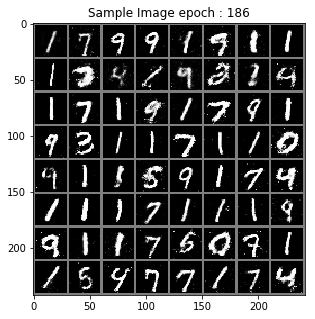

> Epoch : 188 Batch : 19 / 235 Loss_D : 0.7824968695640564 Loss_G : 1.7634865045547485
> Epoch : 188 Batch : 39 / 235 Loss_D : 0.7114092111587524 Loss_G : 1.805128574371338
> Epoch : 188 Batch : 59 / 235 Loss_D : 0.7667396068572998 Loss_G : 1.6969223022460938
> Epoch : 188 Batch : 79 / 235 Loss_D : 0.7963817715644836 Loss_G : 1.9133020639419556
> Epoch : 188 Batch : 99 / 235 Loss_D : 0.8011596202850342 Loss_G : 1.5434819459915161
> Epoch : 188 Batch : 119 / 235 Loss_D : 0.7326889038085938 Loss_G : 1.966801643371582
> Epoch : 188 Batch : 139 / 235 Loss_D : 0.719539999961853 Loss_G : 1.683880090713501
> Epoch : 188 Batch : 159 / 235 Loss_D : 0.7060933709144592 Loss_G : 1.9439736604690552
> Epoch : 188 Batch : 179 / 235 Loss_D : 0.677762508392334 Loss_G : 2.1010689735412598
> Epoch : 188 Batch : 199 / 235 Loss_D : 0.7443855404853821 Loss_G : 1.9655126333236694
> Epoch : 188 Batch : 219 / 235 Loss_D : 0.7944377660751343 Loss_G : 1.4934240579605103


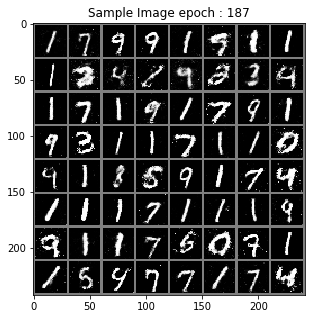

> Epoch : 189 Batch : 19 / 235 Loss_D : 0.7937628030776978 Loss_G : 1.552053451538086
> Epoch : 189 Batch : 39 / 235 Loss_D : 0.6589956283569336 Loss_G : 1.73405122756958
> Epoch : 189 Batch : 59 / 235 Loss_D : 0.7572654485702515 Loss_G : 1.788703203201294
> Epoch : 189 Batch : 79 / 235 Loss_D : 0.6890830993652344 Loss_G : 1.9299061298370361
> Epoch : 189 Batch : 99 / 235 Loss_D : 0.7096850872039795 Loss_G : 1.7152769565582275
> Epoch : 189 Batch : 119 / 235 Loss_D : 0.8179788589477539 Loss_G : 2.255667209625244
> Epoch : 189 Batch : 139 / 235 Loss_D : 0.7779834270477295 Loss_G : 2.0183145999908447
> Epoch : 189 Batch : 159 / 235 Loss_D : 0.8799468278884888 Loss_G : 1.833707571029663
> Epoch : 189 Batch : 179 / 235 Loss_D : 0.6641965508460999 Loss_G : 2.0358328819274902
> Epoch : 189 Batch : 199 / 235 Loss_D : 0.9362455010414124 Loss_G : 1.7559432983398438
> Epoch : 189 Batch : 219 / 235 Loss_D : 0.8800057768821716 Loss_G : 1.9403048753738403


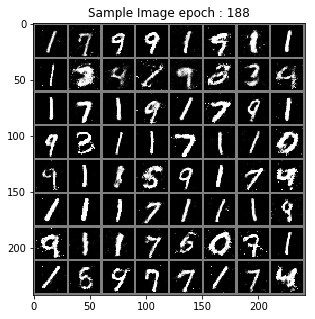

> Epoch : 190 Batch : 19 / 235 Loss_D : 0.7274273633956909 Loss_G : 2.048231840133667
> Epoch : 190 Batch : 39 / 235 Loss_D : 0.7356510162353516 Loss_G : 1.6007494926452637
> Epoch : 190 Batch : 59 / 235 Loss_D : 0.7512706518173218 Loss_G : 1.9244751930236816
> Epoch : 190 Batch : 79 / 235 Loss_D : 0.7936632037162781 Loss_G : 1.9410161972045898
> Epoch : 190 Batch : 99 / 235 Loss_D : 0.765568733215332 Loss_G : 1.908315658569336
> Epoch : 190 Batch : 119 / 235 Loss_D : 0.8404447436332703 Loss_G : 1.7712695598602295
> Epoch : 190 Batch : 139 / 235 Loss_D : 0.6449011564254761 Loss_G : 1.7447396516799927
> Epoch : 190 Batch : 159 / 235 Loss_D : 0.7914460897445679 Loss_G : 1.7224419116973877
> Epoch : 190 Batch : 179 / 235 Loss_D : 0.7439827919006348 Loss_G : 1.8701252937316895
> Epoch : 190 Batch : 199 / 235 Loss_D : 0.6895308494567871 Loss_G : 1.8294411897659302
> Epoch : 190 Batch : 219 / 235 Loss_D : 0.7545273900032043 Loss_G : 1.8939096927642822


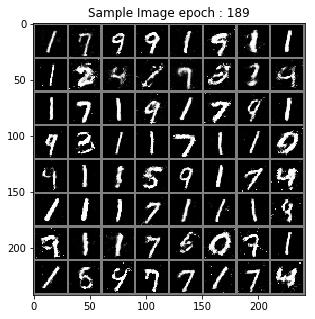

> Epoch : 191 Batch : 19 / 235 Loss_D : 0.747836709022522 Loss_G : 1.6994413137435913
> Epoch : 191 Batch : 39 / 235 Loss_D : 0.7275536060333252 Loss_G : 1.8239272832870483
> Epoch : 191 Batch : 59 / 235 Loss_D : 0.6681602597236633 Loss_G : 2.012399196624756
> Epoch : 191 Batch : 79 / 235 Loss_D : 0.7874995470046997 Loss_G : 1.9293928146362305
> Epoch : 191 Batch : 99 / 235 Loss_D : 0.7397412657737732 Loss_G : 2.2221760749816895
> Epoch : 191 Batch : 119 / 235 Loss_D : 0.7144191265106201 Loss_G : 1.6662707328796387
> Epoch : 191 Batch : 139 / 235 Loss_D : 0.8134967684745789 Loss_G : 2.0124011039733887
> Epoch : 191 Batch : 159 / 235 Loss_D : 0.7399471998214722 Loss_G : 1.8537511825561523
> Epoch : 191 Batch : 179 / 235 Loss_D : 0.8154923319816589 Loss_G : 1.8360624313354492
> Epoch : 191 Batch : 199 / 235 Loss_D : 0.6800941228866577 Loss_G : 1.9467917680740356
> Epoch : 191 Batch : 219 / 235 Loss_D : 0.8369148969650269 Loss_G : 1.5960619449615479


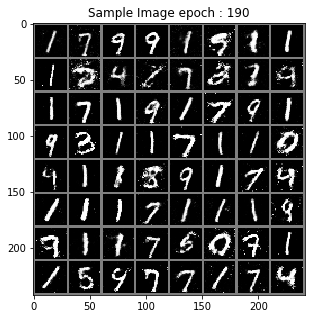

> Epoch : 192 Batch : 19 / 235 Loss_D : 0.7189493179321289 Loss_G : 1.9398579597473145
> Epoch : 192 Batch : 39 / 235 Loss_D : 0.7962173223495483 Loss_G : 1.829131841659546
> Epoch : 192 Batch : 59 / 235 Loss_D : 0.7044126987457275 Loss_G : 1.9326024055480957
> Epoch : 192 Batch : 79 / 235 Loss_D : 0.7079381942749023 Loss_G : 1.713163137435913
> Epoch : 192 Batch : 99 / 235 Loss_D : 0.9419020414352417 Loss_G : 2.09108304977417
> Epoch : 192 Batch : 119 / 235 Loss_D : 0.7027530670166016 Loss_G : 1.8900426626205444
> Epoch : 192 Batch : 139 / 235 Loss_D : 0.7430610060691833 Loss_G : 1.5726655721664429
> Epoch : 192 Batch : 159 / 235 Loss_D : 0.7031618356704712 Loss_G : 1.6462689638137817
> Epoch : 192 Batch : 179 / 235 Loss_D : 0.7848515510559082 Loss_G : 1.5064374208450317
> Epoch : 192 Batch : 199 / 235 Loss_D : 0.7487242221832275 Loss_G : 1.7539019584655762
> Epoch : 192 Batch : 219 / 235 Loss_D : 0.8040163516998291 Loss_G : 1.853105068206787


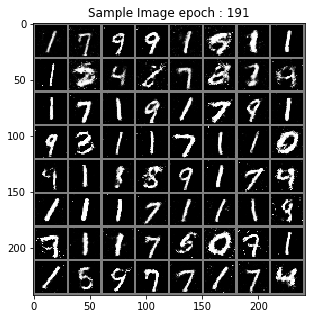

> Epoch : 193 Batch : 19 / 235 Loss_D : 0.7289246320724487 Loss_G : 1.749891757965088
> Epoch : 193 Batch : 39 / 235 Loss_D : 0.6320992708206177 Loss_G : 2.031144142150879
> Epoch : 193 Batch : 59 / 235 Loss_D : 0.7971097230911255 Loss_G : 1.587836742401123
> Epoch : 193 Batch : 79 / 235 Loss_D : 0.6949959397315979 Loss_G : 1.7686564922332764
> Epoch : 193 Batch : 99 / 235 Loss_D : 0.8208291530609131 Loss_G : 1.7051050662994385
> Epoch : 193 Batch : 119 / 235 Loss_D : 0.6105581521987915 Loss_G : 1.995837926864624
> Epoch : 193 Batch : 139 / 235 Loss_D : 0.6984449625015259 Loss_G : 2.1151769161224365
> Epoch : 193 Batch : 159 / 235 Loss_D : 0.898254930973053 Loss_G : 1.8815462589263916
> Epoch : 193 Batch : 179 / 235 Loss_D : 0.7540059089660645 Loss_G : 1.7408344745635986
> Epoch : 193 Batch : 199 / 235 Loss_D : 0.7837506532669067 Loss_G : 2.131653308868408
> Epoch : 193 Batch : 219 / 235 Loss_D : 0.7903288006782532 Loss_G : 1.8849248886108398


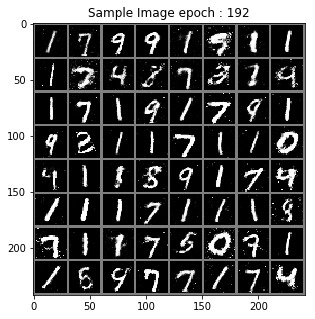

> Epoch : 194 Batch : 19 / 235 Loss_D : 0.7652971148490906 Loss_G : 1.8216849565505981
> Epoch : 194 Batch : 39 / 235 Loss_D : 0.7197626829147339 Loss_G : 1.8073186874389648
> Epoch : 194 Batch : 59 / 235 Loss_D : 0.7400685548782349 Loss_G : 2.116945743560791
> Epoch : 194 Batch : 79 / 235 Loss_D : 0.7522701621055603 Loss_G : 1.8051865100860596
> Epoch : 194 Batch : 99 / 235 Loss_D : 0.759009599685669 Loss_G : 2.05067777633667
> Epoch : 194 Batch : 119 / 235 Loss_D : 0.7593873739242554 Loss_G : 1.9785826206207275
> Epoch : 194 Batch : 139 / 235 Loss_D : 0.7162333726882935 Loss_G : 1.6797370910644531
> Epoch : 194 Batch : 159 / 235 Loss_D : 0.6737646460533142 Loss_G : 1.7887040376663208
> Epoch : 194 Batch : 179 / 235 Loss_D : 0.7109772562980652 Loss_G : 1.4983280897140503
> Epoch : 194 Batch : 199 / 235 Loss_D : 0.8688559532165527 Loss_G : 1.6571342945098877
> Epoch : 194 Batch : 219 / 235 Loss_D : 0.6882948279380798 Loss_G : 2.22702693939209


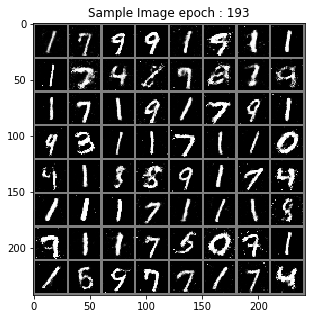

> Epoch : 195 Batch : 19 / 235 Loss_D : 0.8031935691833496 Loss_G : 1.66539466381073
> Epoch : 195 Batch : 39 / 235 Loss_D : 0.6147191524505615 Loss_G : 1.790906548500061
> Epoch : 195 Batch : 59 / 235 Loss_D : 0.7177997827529907 Loss_G : 1.7504136562347412
> Epoch : 195 Batch : 79 / 235 Loss_D : 0.7570356130599976 Loss_G : 1.9208033084869385
> Epoch : 195 Batch : 99 / 235 Loss_D : 0.7808994054794312 Loss_G : 1.9529615640640259
> Epoch : 195 Batch : 119 / 235 Loss_D : 0.7346986532211304 Loss_G : 1.7875770330429077
> Epoch : 195 Batch : 139 / 235 Loss_D : 0.8156148195266724 Loss_G : 1.7839024066925049
> Epoch : 195 Batch : 159 / 235 Loss_D : 0.7144297957420349 Loss_G : 1.96561598777771
> Epoch : 195 Batch : 179 / 235 Loss_D : 0.7936630249023438 Loss_G : 1.9446712732315063
> Epoch : 195 Batch : 199 / 235 Loss_D : 0.7312072515487671 Loss_G : 1.7823069095611572
> Epoch : 195 Batch : 219 / 235 Loss_D : 0.8098106980323792 Loss_G : 1.6589105129241943


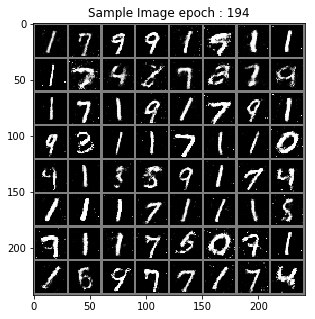

> Epoch : 196 Batch : 19 / 235 Loss_D : 0.7449421882629395 Loss_G : 1.8381189107894897
> Epoch : 196 Batch : 39 / 235 Loss_D : 0.7731620073318481 Loss_G : 2.1072216033935547
> Epoch : 196 Batch : 59 / 235 Loss_D : 0.7659012079238892 Loss_G : 1.9300589561462402
> Epoch : 196 Batch : 79 / 235 Loss_D : 0.8097863793373108 Loss_G : 1.767530083656311
> Epoch : 196 Batch : 99 / 235 Loss_D : 0.700749397277832 Loss_G : 1.7766156196594238
> Epoch : 196 Batch : 119 / 235 Loss_D : 0.6540101170539856 Loss_G : 1.6876510381698608
> Epoch : 196 Batch : 139 / 235 Loss_D : 0.677193820476532 Loss_G : 1.6859095096588135
> Epoch : 196 Batch : 159 / 235 Loss_D : 0.8047226667404175 Loss_G : 1.9693071842193604
> Epoch : 196 Batch : 179 / 235 Loss_D : 0.6351921558380127 Loss_G : 1.5861635208129883
> Epoch : 196 Batch : 199 / 235 Loss_D : 0.8257618546485901 Loss_G : 1.7075659036636353
> Epoch : 196 Batch : 219 / 235 Loss_D : 0.7078121304512024 Loss_G : 2.154155969619751


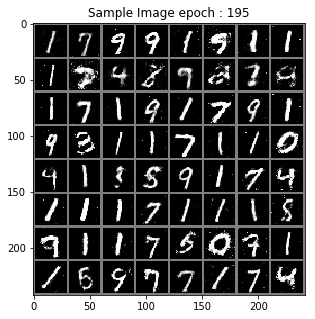

> Epoch : 197 Batch : 19 / 235 Loss_D : 0.6478215456008911 Loss_G : 2.148233652114868
> Epoch : 197 Batch : 39 / 235 Loss_D : 0.7524869441986084 Loss_G : 1.7793455123901367
> Epoch : 197 Batch : 59 / 235 Loss_D : 0.7678940892219543 Loss_G : 2.0173559188842773
> Epoch : 197 Batch : 79 / 235 Loss_D : 0.7678490877151489 Loss_G : 1.5892060995101929
> Epoch : 197 Batch : 99 / 235 Loss_D : 0.7038036584854126 Loss_G : 1.6973390579223633
> Epoch : 197 Batch : 119 / 235 Loss_D : 0.7721704244613647 Loss_G : 1.8933050632476807
> Epoch : 197 Batch : 139 / 235 Loss_D : 0.6782600283622742 Loss_G : 1.892849326133728
> Epoch : 197 Batch : 159 / 235 Loss_D : 0.6526584625244141 Loss_G : 1.8912880420684814
> Epoch : 197 Batch : 179 / 235 Loss_D : 0.9075632095336914 Loss_G : 1.7760142087936401
> Epoch : 197 Batch : 199 / 235 Loss_D : 0.7149472832679749 Loss_G : 1.928955316543579
> Epoch : 197 Batch : 219 / 235 Loss_D : 0.8215627074241638 Loss_G : 1.7140424251556396


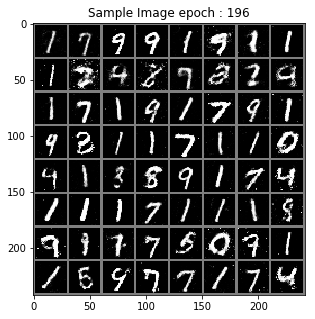

> Epoch : 198 Batch : 19 / 235 Loss_D : 0.7934362888336182 Loss_G : 1.7971336841583252
> Epoch : 198 Batch : 39 / 235 Loss_D : 0.5818216800689697 Loss_G : 2.2098453044891357
> Epoch : 198 Batch : 59 / 235 Loss_D : 0.79358971118927 Loss_G : 1.5292887687683105
> Epoch : 198 Batch : 79 / 235 Loss_D : 0.8119757771492004 Loss_G : 1.796861171722412
> Epoch : 198 Batch : 99 / 235 Loss_D : 0.7297893762588501 Loss_G : 1.9136312007904053
> Epoch : 198 Batch : 119 / 235 Loss_D : 0.7545692920684814 Loss_G : 2.065476894378662
> Epoch : 198 Batch : 139 / 235 Loss_D : 0.7103378772735596 Loss_G : 1.7021403312683105
> Epoch : 198 Batch : 159 / 235 Loss_D : 0.9493184089660645 Loss_G : 2.0590507984161377
> Epoch : 198 Batch : 179 / 235 Loss_D : 0.5941668748855591 Loss_G : 2.2365851402282715
> Epoch : 198 Batch : 199 / 235 Loss_D : 0.7538392543792725 Loss_G : 2.003209114074707
> Epoch : 198 Batch : 219 / 235 Loss_D : 0.7972536087036133 Loss_G : 1.9239896535873413


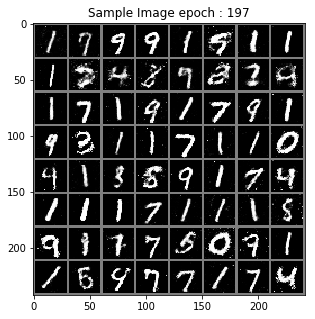

> Epoch : 199 Batch : 19 / 235 Loss_D : 0.6646815538406372 Loss_G : 1.942143201828003
> Epoch : 199 Batch : 39 / 235 Loss_D : 0.8399285674095154 Loss_G : 1.7859892845153809
> Epoch : 199 Batch : 59 / 235 Loss_D : 0.787121593952179 Loss_G : 2.021545886993408
> Epoch : 199 Batch : 79 / 235 Loss_D : 0.810096263885498 Loss_G : 1.6470837593078613
> Epoch : 199 Batch : 99 / 235 Loss_D : 0.6604527831077576 Loss_G : 2.0778632164001465
> Epoch : 199 Batch : 119 / 235 Loss_D : 0.9346547722816467 Loss_G : 1.7251572608947754
> Epoch : 199 Batch : 139 / 235 Loss_D : 0.6387693881988525 Loss_G : 2.038843870162964
> Epoch : 199 Batch : 159 / 235 Loss_D : 0.8591745495796204 Loss_G : 1.8149758577346802
> Epoch : 199 Batch : 179 / 235 Loss_D : 0.7722636461257935 Loss_G : 1.808895230293274
> Epoch : 199 Batch : 199 / 235 Loss_D : 0.7637572288513184 Loss_G : 1.5800023078918457
> Epoch : 199 Batch : 219 / 235 Loss_D : 0.7536836266517639 Loss_G : 1.842573642730713


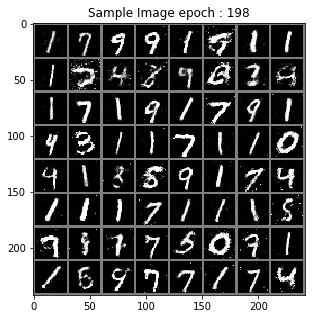

> Epoch : 200 Batch : 19 / 235 Loss_D : 0.7652793526649475 Loss_G : 1.9448583126068115
> Epoch : 200 Batch : 39 / 235 Loss_D : 0.7522590160369873 Loss_G : 1.803661584854126
> Epoch : 200 Batch : 59 / 235 Loss_D : 0.8400980234146118 Loss_G : 1.726996898651123
> Epoch : 200 Batch : 79 / 235 Loss_D : 0.7543355226516724 Loss_G : 1.9127225875854492
> Epoch : 200 Batch : 99 / 235 Loss_D : 0.7810169458389282 Loss_G : 1.802955150604248
> Epoch : 200 Batch : 119 / 235 Loss_D : 0.6965283155441284 Loss_G : 1.7870304584503174
> Epoch : 200 Batch : 139 / 235 Loss_D : 0.9313047528266907 Loss_G : 1.542149543762207
> Epoch : 200 Batch : 159 / 235 Loss_D : 0.6828224062919617 Loss_G : 2.0945000648498535
> Epoch : 200 Batch : 179 / 235 Loss_D : 0.9466494917869568 Loss_G : 1.5215998888015747
> Epoch : 200 Batch : 199 / 235 Loss_D : 0.6685065627098083 Loss_G : 1.7969532012939453
> Epoch : 200 Batch : 219 / 235 Loss_D : 0.8631234169006348 Loss_G : 1.6573371887207031


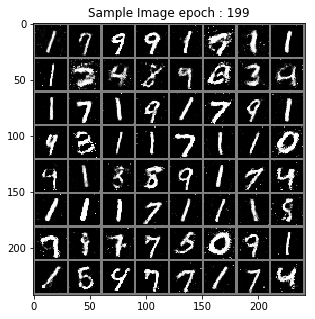

In [38]:


fixed_noise=Variable(torch.randn(64,64)).cuda(CUDA_DEVICE)


for e in range(200):
    for batch_idx, (data, _) in enumerate(MNIST_data):
        dis.zero_grad()

        #train discriminator with real
        real_im=Variable(data).cuda(CUDA_DEVICE)
        real_label=Variable(torch.ones(data.size(0))).cuda(CUDA_DEVICE)
        pred_real=dis(real_im)
        dis_loss_real=criterion(pred_real.squeeze(),real_label)
        dis_loss_real.backward()
        
        #train discriminator with fake
        noise=Variable(torch.randn(data.size(0),64)).cuda(CUDA_DEVICE)
        fake_im=gen(noise)
        fake_label=Variable(torch.zeros(data.size(0))).cuda(CUDA_DEVICE)
        pred_fake=dis(fake_im.detach())
        dis_loss_fake=criterion(pred_fake.squeeze(),fake_label)
        dis_loss_fake.backward()

        #update total loss and optimize
        dis_loss=dis_loss_fake+dis_loss_real
        dis_optimizer.step()


        gen.zero_grad()

        #train generator
        noise=Variable(torch.randn(data.size(0),64)).cuda(CUDA_DEVICE)
        fake_im=gen(noise)
        pred_fake=dis(fake_im)
        gen_loss=criterion(pred_fake.squeeze(),real_label)
        gen_loss.backward()
        gen_optimizer.step()
        
        if((batch_idx+1)%20==0):
            print('> Epoch :',e+1,'Batch :',batch_idx,'/',len(MNIST_data),'Loss_D :',dis_loss.data[0],'Loss_G :',gen_loss.data[0])
    
    fake_im=gen(fixed_noise)
    out=make_grid(fake_im.view(-1,1,28,28).data)
    imshow(denorm(out.cpu()), c=0, save=False, title="Sample Image epoch : "+str(e))
    save_image(gen(fixed_noise).cpu().data,'results/sample_epoch_'+str(e+1)+'.jpg')
        
    